# W261 Final Project - Airline Delays and Weather
__`MIDS w261: Machine Learning at Scale | UC Berkeley School of Information | Summer 2020`__
### Team 1:
* Sayan Das
* Kevin Hartman
* Hersh Solanki
* Nick Sylva

# Table of Contents
### 2. Data Sources
### 3. Data Lake Prep
### 4. Exploratory Data Analysis
### 5. Data Wrangling, Cleanup and Prep

# 2. Data Sources

## Airline delays 
### Bureau of Transportation Statistics
https://www.transtats.bts.gov/DL_SelectFields.asp?Table_ID=236   
https://www.bts.gov/topics/airlines-and-airports/understanding-reporting-causes-flight-delays-and-cancellations

Dates covered in dataset: 2015 - 2019

### Additional sources
This might be useful in matching station codes to airports:
1. http://dss.ucar.edu/datasets/ds353.4/inventories/station-list.html
2. https://www.world-airport-codes.com/

# 3. Data Lake Prep
Our group worked with the Delta Lake.  The Delta Lake brings reliability, performance, and lifecycle management to data lakes. The pitch with Delta Lake is that there is no more malformed data ingestion, difficulty deleting data for compliance, or issues modifying data for change data capture.  The Delta Lake allowed us to establish different versions of our data - bronze, silver, and gold (when productionalized) - while allowing us to read and write data concurrently with ACID Transactions.  Bronze data is the raw data in the native format upon ingestion, silver data is sanitized and cleaned data, and finally, our gold data is the data that is pushed to our Delta Lake for production model use.  Moreover, the Delta Lake transaction log records details about any changes made to our data, providing us with a full audit history (yes, we did use it to go back to other versions)

**The setup for the Delta Lake and the initial imports are shown below:**

## Notebook Imports

In [0]:
!pip install networkx
from pyspark.sql import functions as f
from pyspark.sql.types import StructType, StructField, StringType, DoubleType, IntegerType, NullType, ShortType, DateType, BooleanType, BinaryType
from pyspark.sql import SQLContext
from pyspark.sql.window import Window

from math import radians, cos, sin, asin, sqrt
import matplotlib.pyplot as plt
import time
import numpy as np 
import pandas as pd
import seaborn as sns
from pytz import timezone 
from datetime import  datetime, timedelta 
import os
import networkx as nx
from delta.tables import DeltaTable
from copy import deepcopy

# Model Imports
from pyspark.ml import Pipeline
from pyspark.ml.feature import StringIndexer, VectorAssembler, StandardScaler, OneHotEncoder 
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.classification import GBTClassifier

%matplotlib inline
sqlContext = SQLContext(sc)

## Configure access to staging areas - bronze & silver

In [0]:
username = "kevin2"
dbutils.widgets.text("username", username)
spark.sql(f"CREATE DATABASE IF NOT EXISTS airline_delays_{username}")
spark.sql(f"USE airline_delays_{username}")

flights_loc = f"/airline_delays/{username}/DLRS/flights/"
flights_3m_loc = f"/airline_delays/{username}/DLRS/flights_3m/"
flights_6m_loc = f"/airline_delays/{username}/DLRS/flights_6m/"
airports_loc = f"/airline_delays/{username}/DLRS/airports/"
weather_loc = f"/airline_delays/{username}/DLRS/weather/"
stations_loc = f"/airline_delays/{username}/DLRS/stations/"

spark.conf.set("spark.sql.shuffle.partitions", 8)

## Download and store data locally (Bronze)

#### Clear raw (bronze) landing zone

In [0]:
dbutils.fs.rm(flights_loc + "raw", recurse=True)
dbutils.fs.rm(flights_3m_loc + "raw", recurse=True)
dbutils.fs.rm(flights_6m_loc + "raw", recurse=True)
dbutils.fs.rm(airports_loc + "raw", recurse=True)
dbutils.fs.rm(airports_loc + "land", recurse=True)
dbutils.fs.rm(airports_loc + "stage", recurse=True)
dbutils.fs.rm(weather_loc + "raw", recurse=True)
dbutils.fs.rm(stations_loc + "raw", recurse=True)

#### Ingest Data from Flights, Weather and Stations

Data from mids-w261 project folder

In [0]:
source_path = "dbfs:/mnt/mids-w261/data/datasets_final_project/"
flights_source_path = source_path + "parquet_airlines_data/"
flights_3m_source_path = source_path + "parquet_airlines_data_3m/"
flights_6m_source_path = source_path + "parquet_airlines_data_6m/"
weather_source_path = source_path + "weather_data/"

demo8_source_path = "dbfs:/mnt/mids-w261/data/DEMO8/"
stations_source_path = demo8_source_path + "gsod/"

#### Airports
Data from OpenFlights: https://openflights.org/data.html

In [0]:
airports_source_url = "https://raw.githubusercontent.com/jpatokal/openflights/master/data/airports.dat"

In [0]:
%python
os.environ['airports_source_url'] = airports_source_url

In [0]:
%sh 
wget $airports_source_url
ls

In [0]:
dbutils.fs.mv("file:/databricks/driver/airports.dat", 
              airports_loc + "land/airports.dat")

In [0]:
airports_land_df = spark.read.option("header", "false").csv(airports_loc + "land/airports.dat", sep = ",")

#### Let's rename some of the Airport columns

In [0]:
def add_airport_data_headers(df):
  return (df.select(f.col("_c0").alias("AIRPORT_ID"),
                    f.col("_c1").alias("AIRPORT_NAME"),
                    f.col("_c2").alias("AIRPORT_CITY"),
                    f.col("_c3").alias("AIRPORT_COUNTRY"),
                    f.col("_c4").alias("IATA"),
                    f.col("_c5").alias("ICAO"),
                    f.col("_c6").alias("AIRPORT_LAT"),
                    f.col("_c7").alias("AIRPORT_LONG"),
                    f.col("_c8").alias("AIRPORT_ALT"),
                    f.col("_c9").alias("AIRPORT_TZ_OFFSET"),
                    f.col("_c10").alias("AIRPORT_DST"),
                    f.col("_c11").alias("AIRPORT_TZ_NAME"),
                    f.col("_c12").alias("AIRPORT_TYPE"),
                    f.col("_c13").alias("AIRPORT_SOURCE")
                   )
         )
  
airports_stage_df = add_airport_data_headers(airports_land_df)

In [0]:
airports_stage_path = airports_loc + "stage/"

In [0]:
(airports_stage_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("AIRPORT_TZ_NAME")
 .save(airports_stage_path))

#### Ingest data from staging or source zone (wherever data currently resides) and place into the bronze zone (in raw format)

In [0]:
flights_source_df = spark.read.option("header", "true").parquet(flights_source_path + "*.parquet")
flights_source_3m_df = spark.read.option("header", "true").parquet(flights_3m_source_path + "*.parquet")
flights_source_6m_df = spark.read.option("header", "true").parquet(flights_6m_source_path + "*.parquet")
weather_source_df = spark.read.option("header", "true").parquet(weather_source_path + "*.parquet")
stations_source_df = spark.read.option("header", "true").csv(stations_source_path + "stations.csv.gz")
airports_source_df = spark.read.option("header", "true").parquet(airports_stage_path)

In [0]:
flights_source_df.write.format("delta").mode("overwrite").save(flights_loc + "raw")
flights_source_3m_df.write.format("delta").mode("overwrite").save(flights_3m_loc + "raw")
flights_source_6m_df.write.format("delta").mode("overwrite").save(flights_6m_loc + "raw")
weather_source_df.write.format("delta").mode("overwrite").save(weather_loc + "raw")
stations_source_df.write.format("delta").mode("overwrite").save(stations_loc + "raw")
airports_source_df.write.format("delta").mode("overwrite").save(airports_loc + "raw")

#### Re-read raw files as delta lake

In [0]:
flights_raw_df = spark.read.format("delta").load(flights_loc + "raw")
flights_3m_raw_df = spark.read.format("delta").load(flights_3m_loc + "raw")
flights_6m_raw_df = spark.read.format("delta").load(flights_6m_loc + "raw")
weather_raw_df = spark.read.format("delta").load(weather_loc + "raw")
stations_raw_df = spark.read.format("delta").load(stations_loc + "raw")
airports_raw_df = spark.read.format("delta").load(airports_loc + "raw")

## Perform data processing for analysis (Silver)

#### Clear processed staging folders

In [0]:
dbutils.fs.rm(flights_loc + "processed", recurse=True)
dbutils.fs.rm(flights_3m_loc + "processed", recurse=True)
dbutils.fs.rm(flights_6m_loc + "processed", recurse=True)
dbutils.fs.rm(airports_loc + "processed", recurse=True)
dbutils.fs.rm(weather_loc + "processed", recurse=True)
dbutils.fs.rm(stations_loc + "processed", recurse=True)

In [0]:
# We'll distribute flight data across 31 partitions
spark.conf.set("spark.sql.shuffle.partitions", 31)

#### Flight data pre-processing

In [0]:
def process_flight_data(df):
  cols = df.columns
  cols.append('IN_FLIGHT_AIR_DELAY')
  return (
    df
    .withColumn('IN_FLIGHT_AIR_DELAY', f.lit(df['ARR_DELAY'] - df['DEP_DELAY'] )) # this column is the time difference between arrival and departure and does not include total flight delay
    .select(cols)
    )

flights_processed_df = process_flight_data(flights_raw_df)
flights_3m_processed_df = process_flight_data(flights_3m_raw_df)
flights_6m_processed_df = process_flight_data(flights_6m_raw_df)

In [0]:
(flights_3m_processed_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("DAY_OF_MONTH")
 .save(flights_3m_loc + "processed"))

parquet_table = f"parquet.`{flights_3m_loc}processed`"
partitioning_scheme = "DAY_OF_MONTH string"

DeltaTable.convertToDelta(spark, parquet_table, partitioning_scheme)

In [0]:
%sql

DROP TABLE IF EXISTS flights_3m_processed;

CREATE TABLE flights_3m_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights_3m/processed"

In [0]:
(flights_6m_processed_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("DAY_OF_MONTH")
 .save(flights_6m_loc + "processed"))

parquet_table = f"parquet.`{flights_6m_loc}processed`"
partitioning_scheme = "DAY_OF_MONTH string"

DeltaTable.convertToDelta(spark, parquet_table, partitioning_scheme)

In [0]:
%sql

DROP TABLE IF EXISTS flights_6m_processed;

CREATE TABLE flights_6m_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights_6m/processed"

In [0]:
(flights_processed_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("DAY_OF_MONTH")
 .save(flights_loc + "processed"))

parquet_table = f"parquet.`{flights_loc}processed`"
partitioning_scheme = "DAY_OF_MONTH string"

DeltaTable.convertToDelta(spark, parquet_table, partitioning_scheme)

In [0]:
%sql

DROP TABLE IF EXISTS flights_processed;

CREATE TABLE flights_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights/processed"

#### Weather data pre-processing

In [0]:
# We'll distribute weather data across 15195 partitions (the number of weather stations)
spark.conf.set("spark.sql.shuffle.partitions", 15195)

In [0]:
def process_weather_data(df):
  df = (df
        .withColumn("STATION", f.lpad(df.STATION, 11, '0'))
        .withColumnRenamed("DATE", "WEATHER_DATE")
        .withColumnRenamed("SOURCE", "WEATHER_SOURCE")
        .withColumnRenamed("STATION", "WEATHER_STATION")
        .withColumnRenamed("LATITUDE", "WEATHER_LAT")
        .withColumnRenamed("LONGITUDE", "WEATHER_LON")
        .withColumnRenamed("ELEVATION", "WEATHER_ELEV")
        .withColumnRenamed("NAME", "WEATHER_NAME")
        .withColumnRenamed("REPORT_TYPE", "WEATHER_REPORT_TYPE")
        .withColumnRenamed("CALL_SIGN", "WEATHER_CALL_SIGN")
       )

  return df

weather_processed_df = process_weather_data(weather_raw_df)



In [0]:
(weather_processed_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("WEATHER_STATION")
 .save(weather_loc + "processed"))

parquet_table = f"parquet.`{weather_loc}processed`"
partitioning_scheme = "WEATHER_STATION string"

DeltaTable.convertToDelta(spark, parquet_table, partitioning_scheme)

In [0]:
%sql

DROP TABLE IF EXISTS weather_processed;

CREATE TABLE weather_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/weather/processed"

#### Station data pre-processing

In [0]:
# We'll distribute station data across the 74 'states'
spark.conf.set("spark.sql.shuffle.partitions", 74)

In [0]:
def process_station_data(df):
  return (df.withColumn("STATION_USAF_WBAN", f.concat(f.col("usaf"), f.col("wban")))
         .select(f.col("STATION_USAF_WBAN"),
                    f.col("name").alias("STATION_NAME"),
                    f.col("country").alias("STATION_COUNTRY"),
                    f.col("state").alias("STATION_STATE"),
                    f.col("call").alias("STATION_CALL"),
                    f.col("lat").alias("STATION_LAT"),
                    f.col("lon").alias("STATION_LONG"),
                    f.col("elev").alias("AIRPORT_ELEV"),
                    f.col("begin").alias("STATION_BEGIN"),
                    f.col("end").alias("STATION_END")
                   )
         )
  
stations_processed_df = process_station_data(stations_raw_df)

In [0]:
(stations_processed_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("STATION_STATE")
 .save(stations_loc + "processed"))

parquet_table = f"parquet.`{stations_loc}processed`"
partitioning_scheme = "STATION_STATE string"

DeltaTable.convertToDelta(spark, parquet_table, partitioning_scheme)

In [0]:
%sql

DROP TABLE IF EXISTS stations_processed;

CREATE TABLE stations_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/stations/processed"

#### Airport data pre-processing

In [0]:
# We'll distribute airport data across the 15 timezone names
spark.conf.set("spark.sql.shuffle.partitions", 15)

In [0]:
def process_airport_data(df):
  cols = df.columns
  return (df.select(cols)
          .where('AIRPORT_COUNTRY = "United States" OR AIRPORT_COUNTRY = "Puerto Rico" OR AIRPORT_COUNTRY = "Virgin Islands"')
         )

airports_processed_df = process_airport_data(airports_raw_df)

In [0]:
(airports_raw_df.write
 .mode("overwrite")
 .format("parquet")
 .partitionBy("AIRPORT_TZ_NAME")
 .save(airports_loc + "processed"))

parquet_table = f"parquet.`{airports_loc}processed`"
partitioning_scheme = "AIRPORT_TZ_NAME string"

DeltaTable.convertToDelta(spark, parquet_table, partitioning_scheme)

In [0]:
%sql

DROP TABLE IF EXISTS airports_processed;

CREATE TABLE airports_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/airports/processed"

In [0]:
# Back to the defaults
spark.conf.set("spark.sql.shuffle.partitions", 8)

# 4. EDA

We performed EDA on two main datasets: The flights dataset, and the weather dataset.  We also created a custom EDA function that provides counts on key metrics such as unique and missing values along with associated mean, minimums, and maximums for each column.  The function also provided bar graphs for each component of each feature (e.g counts for the number of records in each month).

#### Load data from processed (silver) staging area

In [0]:
flights_processed = spark.sql("select * from flights_processed")
weather_processed = spark.sql("select * from weather_processed")
stations_processed = spark.sql("select * from stations_processed")
airports_processed = spark.sql("select * from airports_processed")

## Flights EDA

Schema for flights: https://annettegreiner.com/vizcomm/OnTime_readme.html

In [0]:
flights_processed.printSchema()

root
-- YEAR: integer (nullable = true)
-- QUARTER: integer (nullable = true)
-- MONTH: integer (nullable = true)
-- DAY_OF_WEEK: integer (nullable = true)
-- FL_DATE: string (nullable = true)
-- OP_UNIQUE_CARRIER: string (nullable = true)
-- OP_CARRIER_AIRLINE_ID: integer (nullable = true)
-- OP_CARRIER: string (nullable = true)
-- TAIL_NUM: string (nullable = true)
-- OP_CARRIER_FL_NUM: integer (nullable = true)
-- ORIGIN_AIRPORT_ID: integer (nullable = true)
-- ORIGIN_AIRPORT_SEQ_ID: integer (nullable = true)
-- ORIGIN_CITY_MARKET_ID: integer (nullable = true)
-- ORIGIN: string (nullable = true)
-- ORIGIN_CITY_NAME: string (nullable = true)
-- ORIGIN_STATE_ABR: string (nullable = true)
-- ORIGIN_STATE_FIPS: integer (nullable = true)
-- ORIGIN_STATE_NM: string (nullable = true)
-- ORIGIN_WAC: integer (nullable = true)
-- DEST_AIRPORT_ID: integer (nullable = true)
-- DEST_AIRPORT_SEQ_ID: integer (nullable = true)
-- DEST_CITY_MARKET_ID: integer (nullable = true)
-- DEST: string (nullable = true)
-- DEST_CITY_NAME: string (nullable = true)
-- DEST_STATE_ABR: string (nullable = true)
-- DEST_STATE_FIPS: integer (nullable = true)
-- DEST_STATE_NM: string (nullable = true)
-- DEST_WAC: integer (nullable = true)
-- CRS_DEP_TIME: integer (nullable = true)
-- DEP_TIME: integer (nullable = true)
-- DEP_DELAY: double (nullable = true)
-- DEP_DELAY_NEW: double (nullable = true)
-- DEP_DEL15: double (nullable = true)
-- DEP_DELAY_GROUP: integer (nullable = true)
-- DEP_TIME_BLK: string (nullable = true)
-- TAXI_OUT: double (nullable = true)
-- WHEELS_OFF: integer (nullable = true)
-- WHEELS_ON: integer (nullable = true)
-- TAXI_IN: double (nullable = true)
-- CRS_ARR_TIME: integer (nullable = true)
-- ARR_TIME: integer (nullable = true)
-- ARR_DELAY: double (nullable = true)
-- ARR_DELAY_NEW: double (nullable = true)
-- ARR_DEL15: double (nullable = true)
-- ARR_DELAY_GROUP: integer (nullable = true)
-- ARR_TIME_BLK: string (nullable = true)
-- CANCELLED: double (nullable = true)
-- CANCELLATION_CODE: string (nullable = true)
-- DIVERTED: double (nullable = true)
-- CRS_ELAPSED_TIME: double (nullable = true)
-- ACTUAL_ELAPSED_TIME: double (nullable = true)
-- AIR_TIME: double (nullable = true)
-- FLIGHTS: double (nullable = true)
-- DISTANCE: double (nullable = true)
-- DISTANCE_GROUP: integer (nullable = true)
-- CARRIER_DELAY: double (nullable = true)
-- WEATHER_DELAY: double (nullable = true)
-- NAS_DELAY: double (nullable = true)
-- SECURITY_DELAY: double (nullable = true)
-- LATE_AIRCRAFT_DELAY: double (nullable = true)
-- FIRST_DEP_TIME: integer (nullable = true)
-- TOTAL_ADD_GTIME: double (nullable = true)
-- LONGEST_ADD_GTIME: double (nullable = true)
-- DIV_AIRPORT_LANDINGS: integer (nullable = true)
-- DIV_REACHED_DEST: double (nullable = true)
-- DIV_ACTUAL_ELAPSED_TIME: double (nullable = true)
-- DIV_ARR_DELAY: double (nullable = true)
-- DIV_DISTANCE: double (nullable = true)
-- DIV1_AIRPORT: string (nullable = true)
-- DIV1_AIRPORT_ID: integer (nullable = true)
-- DIV1_AIRPORT_SEQ_ID: integer (nullable = true)
-- DIV1_WHEELS_ON: integer (nullable = true)
-- DIV1_TOTAL_GTIME: double (nullable = true)
-- DIV1_LONGEST_GTIME: double (nullable = true)
-- DIV1_WHEELS_OFF: integer (nullable = true)
-- DIV1_TAIL_NUM: string (nullable = true)
-- DIV2_AIRPORT: string (nullable = true)
-- DIV2_AIRPORT_ID: integer (nullable = true)
-- DIV2_AIRPORT_SEQ_ID: integer (nullable = true)
-- DIV2_WHEELS_ON: integer (nullable = true)
-- DIV2_TOTAL_GTIME: double (nullable = true)
-- DIV2_LONGEST_GTIME: double (nullable = true)
-- DIV2_WHEELS_OFF: integer (nullable = true)
-- DIV2_TAIL_NUM: string (nullable = true)
-- DIV3_AIRPORT: string (nullable = true)
-- DIV3_AIRPORT_ID: integer (nullable = true)
-- DIV3_AIRPORT_SEQ_ID: integer (nullable = true)
-- DIV3_WHEELS_ON: integer (nullable = true)
-- DIV3_TOTAL_GTIME: double (nullable = true)
-- DIV3_LONGEST_GTIME: double (nullable = true)
-- DIV3_WHEELS_OFF: string (nullable = true)
-- DIV3_TAIL_

In [0]:
f'{flights_processed.count():,}'

Out[5]: '31,746,841'

**We will perform EDA on a sample distribution from the first three  years**

Note, we initially ran these routines on the first three months of data for the project exploration. After this early look, and the decision to use the first three years of data for training, we moved to perform our EDA review again on a random sample from this distribution.

In [0]:
# we will perform EDA on a random sample taken from the first three years
#flights_sample = flights_processed.where('(ORIGIN = "ORD" OR ORIGIN = "ATL") AND QUARTER = 1 and YEAR = 2015').sample(False, .10, seed = 42)
flights_sample = flights_processed.where('YEAR IN (2015, 2016, 2017)').sample(False, .01, seed = 42)

In [0]:
f'{flights_sample.count()}'

Out[7]: '171209'

In [0]:
display(flights_sample)

YEAR,QUARTER,MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,IN_FLIGHT_AIR_DELAY,DAY_OF_MONTH,IATA_ORIGIN,NEAREST_STATION_ID_ORIGIN,NEAREST_STATION_DIST_ORIGIN,IATA_DEST,NEAREST_STATION_ID_DEST,NEAREST_STATION_DIST_DEST,IATA,AIRPORT_TZ_NAME,CRS_DEP_TIME_HOUR,FLIGHT_TIME_UTC,WEATHER_PREDICTION_TIME_UTC,ORIGIN_WEATHER_KEY,DEST_WEATHER_KEY
2017,2,6,5,2017-06-16,B6,20409,B6,N273JB,1427,10721,1072102,30721,BOS,"Boston, MA",MA,25,Massachusetts,13,10821,1082104,30852,BWI,"Baltimore, MD",MD,24,Maryland,35,2101,3,182.0,182.0,1.0,12,2100-2159,11.0,14,116,6.0,2232,122,170.0,170.0,1.0,11,2200-2259,0.0,null,0.0,91.0,79.0,62.0,1.0,369.0,2,0.0,0.0,0.0,0.0,170.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,-12.0,16,BOS,72509014739,0.538469370550351,BWI,72406093721,1.3796785004430223,BOS,America/New_York,21,2017061701,2017061623,72509014739-2017061623,72406093721-2017061623
2017,2,6,5,2017-06-16,B6,20409,B6,N274JB,1634,12478,1247803,31703,JFK,"New York, NY",NY,36,New York,22,10785,1078502,30785,BTV,"Burlington, VT",VT,50,Vermont,16,905,925,20.0,20.0,1.0,1,0900-0959,21.0,946,1032,2.0,1022,1034,12.0,12.0,0.0,0,1000-1059,0.0,null,0.0,77.0,69.0,46.0,1.0,266.0,2,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,-8.0,16,JFK,74486094789,1.428768689838172,BTV,72617014742,0.5065709073327949,JFK,America/New_York,9,2017061613,2017061611,74486094789-2017061611,72617014742-2017061611
2017,2,6,5,2017-06-16,B6,20409,B6,N304JB,2116,12451,1245102,31136,JAX,"Jacksonville, FL",FL,12,Florida,33,11278,1127803,30852,DCA,"Washington, DC",VA,51,Virginia,38,935,929,-6.0,0.0,0.0,-1,0900-0959,27.0,956,1127,4.0,1123,1131,8.0,8.0,0.0,0,1100-1159,0.0,null,0.0,108.0,122.0,91.0,1.0,634.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,14.0,16,JAX,72206013889,0.5932704584705288,DCA,72405013743,0.6133056096299214,JAX,America/New_York,9,2017061613,2017061611,72206013889-2017061611,

**Review our sample for missing info**

In [0]:
# review missing info
def info_missing_table(df_pd):
    """Input pandas dataframe and Return columns with missing value and percentage"""
    mis_val = df_pd.isnull().sum() #count total of null in each columns in dataframe
#count percentage of null in each columns
    mis_val_percent = 100 * df_pd.isnull().sum() / len(df_pd) 
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1) 
 #join to left (as column) between mis_val and mis_val_percent
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing Values', 1 : '% of Total Values'}) 
#rename columns in table
    mis_val_table_ren_columns = mis_val_table_ren_columns[
    mis_val_table_ren_columns.iloc[:,1] != 0].sort_values('% of Total Values', ascending=False).round(1) 
        
    print ("DataFrame has " + str(df_pd.shape[1]) + " columns.\n"    #.shape[1] : just view total columns in dataframe  
    "There are " + str(mis_val_table_ren_columns.shape[0]) +              
    " columns that have missing values.") #.shape[0] : just view total rows in dataframe
    return mis_val_table_ren_columns

In [0]:
flights_sample_panda_df = flights_sample.toPandas()

missing_recs = info_missing_table(flights_sample_panda_df)
missing_recs

,Missing Values,% of Total Values
DIV3_LONGEST_GTIME,171209,100.0
DIV4_WHEELS_ON,171209,100.0
DIV3_TAIL_NUM,171209,100.0
DIV3_WHEELS_OFF,171209,100.0
DIV2_WHEELS_OFF,171209,100.0
...,...,...
DEP_DELAY_NEW,2278,1.3
DEP_TIME,2278,1.3
DEP_DELAY_GROUP,2278,1.3
TAIL_NUM,452,0.3


In [0]:
missing_recs[missing_recs['% of Total Values'] > 95]

,Missing Values,% of Total Values
DIV3_LONGEST_GTIME,171209,100.0
DIV4_WHEELS_ON,171209,100.0
DIV3_TAIL_NUM,171209,100.0
DIV3_WHEELS_OFF,171209,100.0
DIV2_WHEELS_OFF,171209,100.0
DIV2_TAIL_NUM,171209,100.0
DIV3_AIRPORT,171209,100.0
DIV3_AIRPORT_ID,171209,100.0
DIV3_AIRPORT_SEQ_ID,171209,100.0
DIV4_AIRPORT,171209,100.0


**As a first pass will drop all columns that have more than 99% missing information as these records will be impossible to impute**

In [0]:
cols_to_drop = missing_recs[missing_recs['% of Total Values'] > 99].index.values
cols_to_drop

Out[12]: array(['DIV3_LONGEST_GTIME', 'DIV4_WHEELS_ON', 'DIV3_TAIL_NUM',
 'DIV3_WHEELS_OFF', 'DIV2_WHEELS_OFF', 'DIV2_TAIL_NUM',
 'DIV3_AIRPORT', 'DIV3_AIRPORT_ID', 'DIV3_AIRPORT_SEQ_ID',
 'DIV4_AIRPORT', 'DIV4_AIRPORT_ID', 'DIV4_AIRPORT_SEQ_ID',
 'DIV3_TOTAL_GTIME', 'DIV3_WHEELS_ON', 'DIV4_TOTAL_GTIME',
 'DIV5_AIRPORT_SEQ_ID', 'DIV5_TAIL_NUM', 'DIV4_LONGEST_GTIME',
 'DIV5_LONGEST_GTIME', 'DIV5_TOTAL_GTIME', 'DIV5_WHEELS_ON',
 'DIV5_WHEELS_OFF', 'DIV5_AIRPORT_ID', 'DIV5_AIRPORT',
 'DIV4_TAIL_NUM', 'DIV4_WHEELS_OFF', 'DIV2_LONGEST_GTIME',
 'DIV2_TOTAL_GTIME', 'DIV2_WHEELS_ON', 'DIV2_AIRPORT_SEQ_ID',
 'DIV2_AIRPORT_ID', 'DIV2_AIRPORT', 'DIV_ACTUAL_ELAPSED_TIME',
 'DIV_ARR_DELAY', 'DIV1_TAIL_NUM', 'DIV1_WHEELS_OFF',
 'DIV_REACHED_DEST', 'DIV_DISTANCE', 'DIV1_LONGEST_GTIME',
 'DIV1_TOTAL_GTIME', 'DIV1_WHEELS_ON', 'DIV1_AIRPORT_SEQ_ID',
 'DIV1_AIRPORT_ID', 'DIV1_AIRPORT', 'TOTAL_ADD_GTIME',
 'FIRST_DEP_TIME', 'LONGEST_ADD_GTIME'], dtype=object)

In [0]:
cols_to_drop = ['DIV4_AIRPORT', 'DIV4_TOTAL_GTIME', 'DIV3_TOTAL_GTIME',
       'DIV3_WHEELS_ON', 'DIV3_AIRPORT_SEQ_ID', 'DIV3_AIRPORT_ID',
       'DIV3_AIRPORT', 'DIV3_TAIL_NUM', 'DIV3_WHEELS_OFF',
       'DIV4_AIRPORT_ID', 'DIV4_AIRPORT_SEQ_ID', 'DIV4_WHEELS_ON',
       'DIV3_LONGEST_GTIME', 'DIV4_LONGEST_GTIME', 'DIV5_TAIL_NUM',
       'DIV4_TAIL_NUM', 'DIV5_AIRPORT', 'DIV5_WHEELS_OFF',
       'DIV5_LONGEST_GTIME', 'DIV5_TOTAL_GTIME', 'DIV5_WHEELS_ON',
       'DIV5_AIRPORT_SEQ_ID', 'DIV5_AIRPORT_ID', 'DIV4_WHEELS_OFF',
       'DIV2_TAIL_NUM', 'DIV2_WHEELS_OFF', 'DIV2_WHEELS_ON',
       'DIV2_AIRPORT', 'DIV2_TOTAL_GTIME', 'DIV2_LONGEST_GTIME',
       'DIV2_AIRPORT_SEQ_ID', 'DIV2_AIRPORT_ID', 'DIV_ARR_DELAY',
       'DIV_ACTUAL_ELAPSED_TIME', 'DIV1_TAIL_NUM', 'DIV1_WHEELS_OFF',
       'DIV_DISTANCE', 'DIV_REACHED_DEST', 'DIV1_AIRPORT_SEQ_ID',
       'DIV1_TOTAL_GTIME', 'DIV1_WHEELS_ON', 'DIV1_AIRPORT_ID',
       'DIV1_AIRPORT', 'DIV1_LONGEST_GTIME', 'LONGEST_ADD_GTIME',
       'TOTAL_ADD_GTIME', 'FIRST_DEP_TIME']

In [0]:
cols = flights_sample_panda_df.columns
cols_to_keep = []
remove_cols = set(cols_to_drop)
for col in cols:
  if not col in remove_cols:
    cols_to_keep.append(col)

**Custom EDA function**

In [0]:
# Custom-made class to assist with EDA on this dataset
# The code is generalizable. However, specific decisions on plot types were made because
# most features are categorical
class Analyze:
    def __init__(self, df):
        self.df = df
    
    def remove_df():
        self.df = None
        gc.collect()
        
    def print_eda_summary(self):
        #sns.set(rc={'figure.figsize':(10*2,16*8)})
        sns.set()
        i=0
        fig, ax = plt.subplots(nrows=round(len(self.df.columns)), ncols=2, figsize=(16,6*round(len(self.df.columns))))
        all_cols=[]
        for col in self.df.columns:
            if self.df[col].dtype.name == 'object'  or self.df[col].dtype.name == 'category': 
                self.df[col] = self.df[col].astype('str')
            all_cols.append(col)
            max_len = self.df[col].nunique()
            if max_len > 10:
                max_len = 10
            g=sns.countplot(y=self.df[col].fillna(-1), hue=self.df['DEP_DEL15'], order=self.df[col].fillna(-1).value_counts(dropna=False).iloc[:max_len].index, ax=ax[i][0])
            g.set_xlim(0,self.df.shape[0])
            plt.tight_layout()
            ax[i][0].title.set_text(col)
            ax[i][0].xaxis.label.set_visible(False)
            xlabels = ['{:,.0f}'.format(x) + 'K' for x in g.get_xticks()/1000]
            g.set_xticklabels(xlabels)
            ax[i][1].axis("off")
            # Basic info
            desc = self.df[col].describe()
            summary = "DESCRIPTION\n   Name: {:}\n   Type: {:}\n  Count: {:}\n Unique: {:}\nMissing: {:}\nPercent: {:2.3f}".format(
                desc.name.ljust(50), str(desc.dtype).ljust(10), self.df[col].count(), self.df[col].nunique(),
                ('yes' if self.df[col].hasnans else 'no'), (1-self.df[col].count()/self.df.shape[0])*100)
            ax[i][1].text(0, 1, summary, verticalalignment="top", family='monospace', fontsize=12)
            analysis=[]
            if self.df[col].dtype.name == 'object': 
                # additional analysis for categorical variables
                if len(self.df[col].str.lower().unique()) != len(self.df[col].unique()):
                    analysis.append("- duplicates from case\n")
                # look for HTML escape characters (&#x..;)
                # and unicode characters (searching for: anything not printable)
                self.df_bad = self.df[col][self.df[col].str.contains(r'[\x00-\x1f]|&#x\d\d;', regex=True, na=True)]
                if len(self.df_bad) - self.df.shape[0] - self.df[col].count()>0:
                    analysis.append("- illegal chars: {:}\n".format(len(self.df_bad) - self.df.shape[0] - self.df[col].count()))
                # find different capitalizations of "unknown"
                # if more than one present, need to read as string, turn to lowercase, then make categorical
                self.df_unknown = self.df[col].str.lower() == 'unknown'
                unknowns = self.df[col][self.df_unknown].unique()
                if len(unknowns) > 1:
                    analysis.append("- unknowns\n  {:}\n".format(unknowns))
                if len(''.join(analysis)) > 0:
                    ax[i][1].text(.5, .85, 'FINDINGS\n'+''.join(analysis), verticalalignment="top", family='monospace', fontsize=12)
            else:
                # Stats for numeric variables
                statistics = "STATS\n   Mean: {:5.4g}\n    Std: {:5.4g}\n    Min: {:5.4g}\n    25%: {:5.4g}\n    50%: {:5.4g}\n    75%: {:5.4g}\n    Max: {:5.4g}".format(
                    desc.mean(), desc.std(), desc.min(), desc.quantile(.25), desc.quantile(.5), desc.quantile(.75), desc.max())
                ax[i][1].text(.5, .85, statistics, verticalalignment="top", family='monospace', fontsize=12)

            # Top 5 and bottom 5 unique values or all unique values if < 10
            if self.df[col].nunique() <= 10:
                values = pd.DataFrame(list(zip(self.df[col].value_counts(dropna=False).keys().tolist(),
                                         self.df[col].value_counts(dropna=False).tolist())),
                                columns=['VALUES', 'COUNTS'])
                values = values.to_string(index=False)
                ax[i][1].text(0, .6, values, verticalalignment="top", family='monospace', fontsize=12)
            else:
                values = pd.DataFrame(list(zip(self.df[col].value_counts(dropna=False).iloc[:5].keys().tolist(),
                                         self.df[col].value_counts(dropna=False).iloc[:5].tolist())),
                                columns=['VALUES', 'COUNTS'])
                mid_row = pd.DataFrame({'VALUES':[":"],
                                        'COUNTS':[":"]})
                bot_values = pd.DataFrame(list(zip(self.df[col].value_counts(dropna=False).iloc[-5:].keys().tolist(),
                                         self.df[col].value_counts(dropna=False).iloc[-5:].tolist())),
                                columns=['VALUES', 'COUNTS'])
                values = values.append(mid_row)
                values = values.append(bot_values)
                values = values.to_string(index=False)
                ax[i][1].text(0, .6, values, verticalalignment="top", family='monospace', fontsize=12)
            i=i+1
        fig.show()

**Now we will analyze the remaining columns for their distribution of values, descriptive statistics and potential for explanatory power**

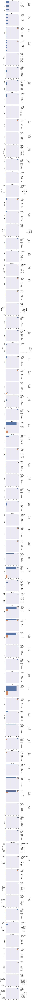

In [0]:
df_to_analyze = deepcopy(flights_sample_panda_df[cols_to_keep])
analyzer = Analyze(df_to_analyze)
analyzer.print_eda_summary()

Based on the output from above, there does not appear to much predictive value from the columns of above.  However, we are able to see the distribution of values for each of the features.  It will be interesting to see the output of this function when we tie in the weather data.

Let's take a look at a heatmap:

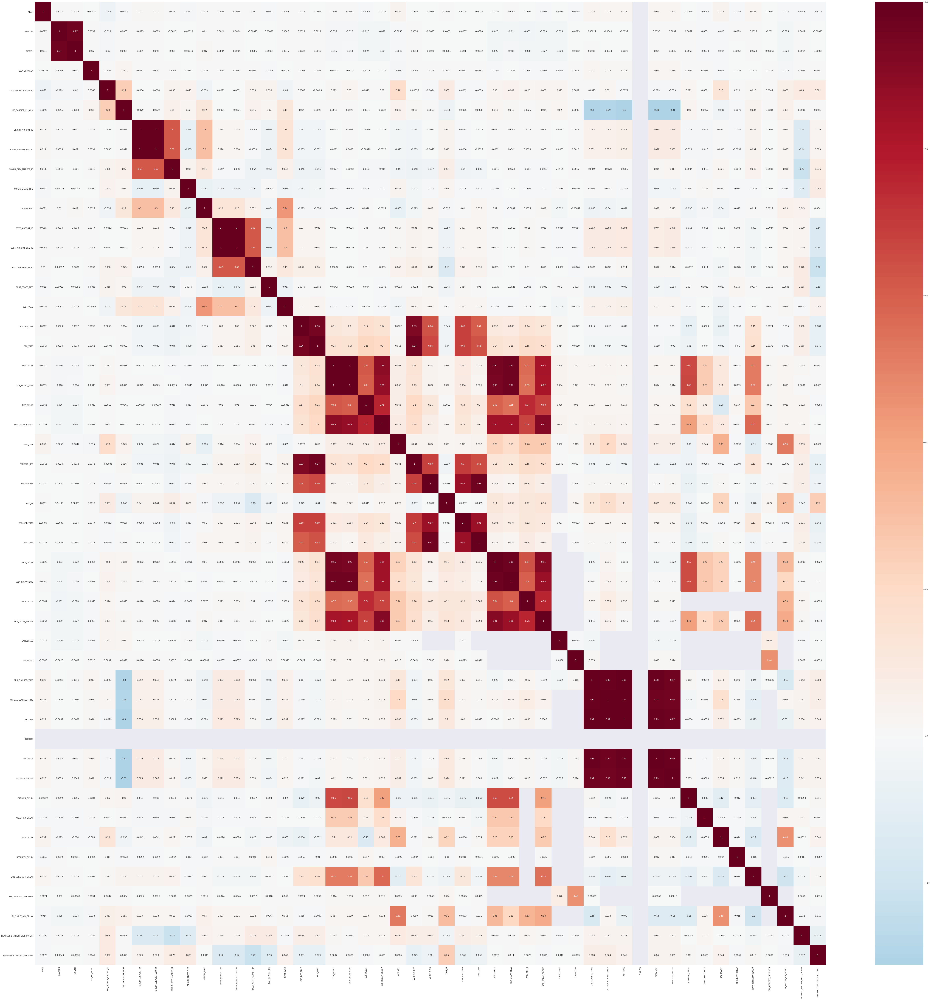

In [0]:
sns.set(rc={'figure.figsize':(100,100)})
sns.heatmap(flights_sample_panda_df[cols_to_keep].corr(), cmap='RdBu_r', annot=True, center=0.0)
sns.set(rc={'figure.figsize':(10,10)})

There does not appear to be any noteworthy correlations between columns on the flights data based on the heatmap above.

### Analysis on departures that are on time or early

In [0]:
flights_sample.where('DEP_DELAY < 0').count() / flights_sample.count() # This statistic explains that 58% of flights depart earlier

Out[18]: 0.5814881227038298

In [0]:
flights_sample.where('DEP_DELAY == 0').count() / flights_sample.count()  # This statistic explains that 5.4% of flights depart EXACTLY on time

Out[19]: 0.05457072934249952

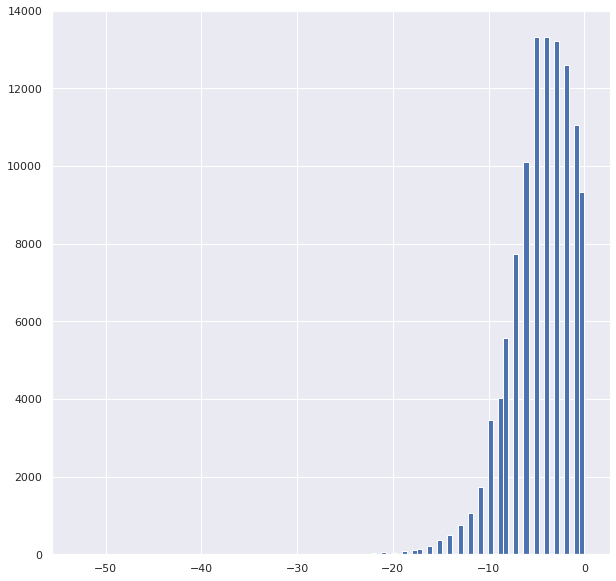

In [0]:
bins, counts = flights_sample.select('DEP_DELAY').where('DEP_DELAY <= 0').rdd.flatMap(lambda x: x).histogram(100)
plt.hist(bins[:-1], bins=bins, weights=counts)

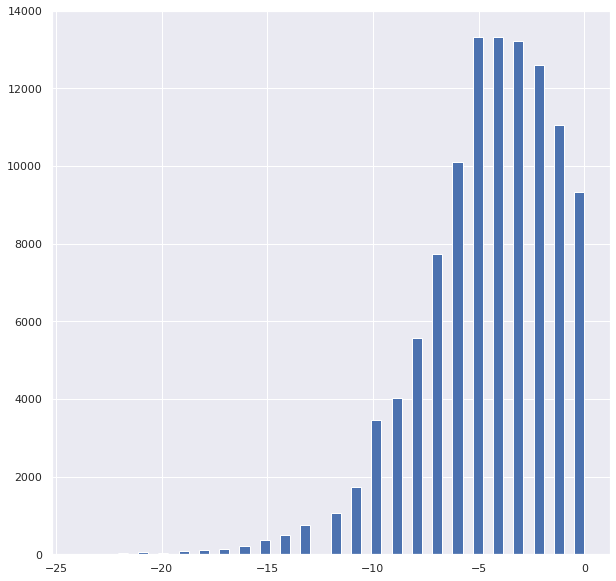

In [0]:
bins, counts = flights_sample.select('DEP_DELAY').where('DEP_DELAY <= 0 AND DEP_DELAY > -25').rdd.flatMap(lambda x: x).histogram(50)
plt.hist(bins[:-1], bins=bins, weights=counts)

### Analysis on departures that are delayed

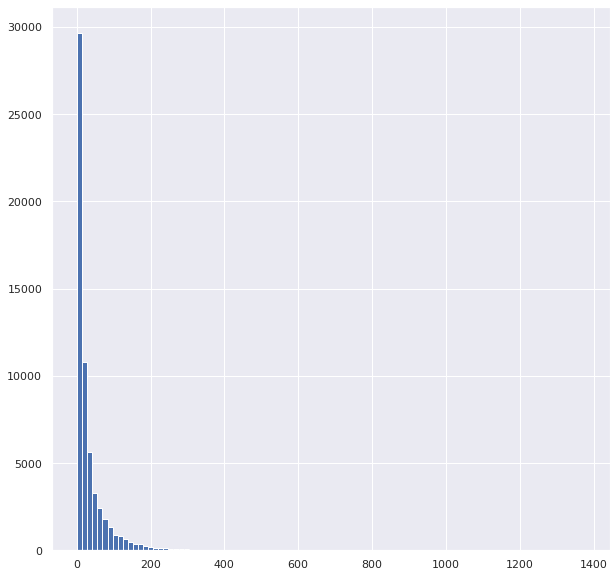

In [0]:
bins, counts = flights_sample.select('DEP_DELAY').where('DEP_DELAY > 0').rdd.flatMap(lambda x: x).histogram(100)
plt.hist(bins[:-1], bins=bins, weights=counts)

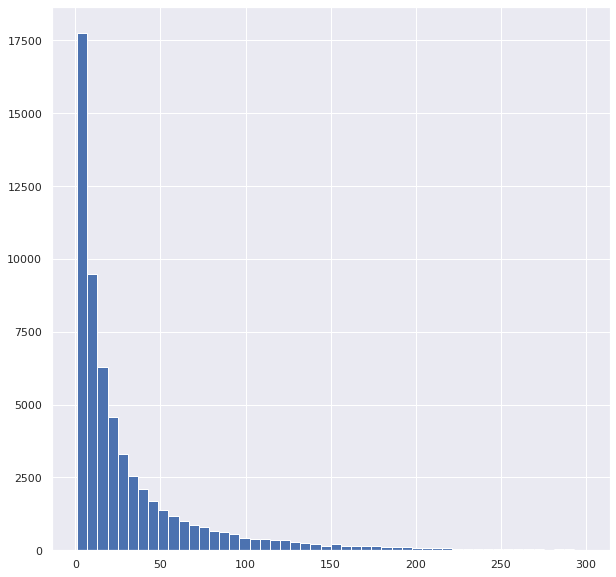

In [0]:
bins, counts = flights_sample.select('DEP_DELAY').where('DEP_DELAY > 0 AND DEP_DELAY < 300').rdd.flatMap(lambda x: x).histogram(50)
plt.hist(bins[:-1], bins=bins, weights=counts)

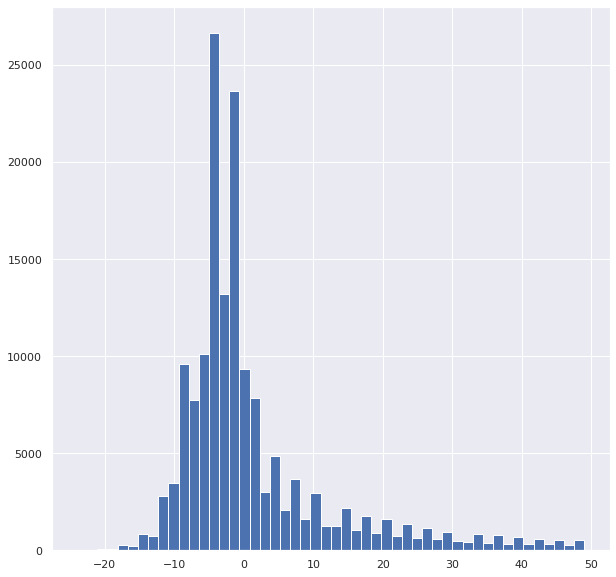

In [0]:
bins, counts = flights_sample.select('DEP_DELAY').where('DEP_DELAY > -25 AND DEP_DELAY < 50').rdd.flatMap(lambda x: x).histogram(50)
plt.hist(bins[:-1], bins=bins, weights=counts)

Analyzing the plot above, it is apparent that the distribution is right-skewed, implying that there is a heavy amount of data that is delayed and shifting the distribution towards the right, so therefore the median departure delay is higher than the mean.  Intuitively, this makes sense, for it is more likely that a flight will depart a day later compared to a flight departing a day earlier.  Moreover, we can see that much of the data revolves around flights that depart early or on time, and it is possible that the data is from airports that are smaller with less load; this would explain how the flights would be more likely to depart at an earlier time.  Further analysis of the locations of the actual airports and the distribution of these airports is necessary.

### Arrival Delay

Next, we will look into visualizing arrival delay.  However, we should note that arrival delay also encompasses any delay from the departure delay.  Therefore, we engineered a new column in our pre-processor (IN_FLIGHT_AIR_DELAY) that accounts for this discrepancy.

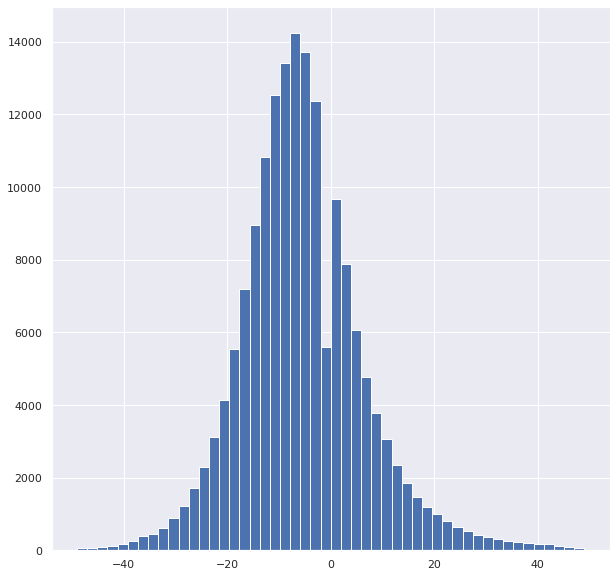

In [0]:
bins, counts = flights_sample.select('IN_FLIGHT_AIR_DELAY').where('IN_FLIGHT_AIR_DELAY > -50 AND IN_FLIGHT_AIR_DELAY < 50').rdd.flatMap(lambda x: x).histogram(50)
plt.hist(bins[:-1], bins=bins, weights=counts)

We can see that there is a normal distribution that is centered around -5; this indicates that the flight makes up 5 minutes of time after departing from the airport.  In general, this is implying that flights are making up time in the air time.  Further analysis should look into analyzing the amount of time made up in the air based on distance to see if flights make up more delay time with longer flight distances.

## Weather EDA
https://data.nodc.noaa.gov/cgi-bin/iso?id=gov.noaa.ncdc:C00532


Schema for weather: https://www.ncei.noaa.gov/data/global-hourly/doc/isd-format-document.pdf

In [0]:
f'{weather_processed.count():,}'

Out[26]: '626,994,336'

**Run EDA on Weather Sample**

In [0]:
# sample from the first three years
weather_sample = weather_processed.where('WEATHER_DATE >= TO_DATE("01/01/2015", "MM/dd/yyyy") AND WEATHER_DATE <= TO_DATE("12/31/2017", "MM/dd/yyyy")').sample(False, .001, seed = 42)
# subset to 1Q2015
#weather_subset = weather_processed.where('WEATHER_DATE >= TO_DATE("01/01/2015", "MM/dd/yyyy") AND WEATHER_DATE <= TO_DATE("03/31/2015", "MM/dd/yyyy")') 

In [0]:
f'{weather_sample.count():,}'

Out[28]: '368,470'

In [0]:
weather_sample.printSchema()

root
-- WEATHER_DATE: timestamp (nullable = true)
-- WEATHER_SOURCE: short (nullable = true)
-- WEATHER_LAT: double (nullable = true)
-- WEATHER_LON: double (nullable = true)
-- WEATHER_ELEV: double (nullable = true)
-- WEATHER_NAME: string (nullable = true)
-- WEATHER_REPORT_TYPE: string (nullable = true)
-- WEATHER_CALL_SIGN: string (nullable = true)
-- QUALITY_CONTROL: string (nullable = true)
-- WND: string (nullable = true)
-- CIG: string (nullable = true)
-- VIS: string (nullable = true)
-- TMP: string (nullable = true)
-- DEW: string (nullable = true)
-- SLP: string (nullable = true)
-- AW1: string (nullable = true)
-- GA1: string (nullable = true)
-- GA2: string (nullable = true)
-- GA3: string (nullable = true)
-- GA4: string (nullable = true)
-- GE1: string (nullable = true)
-- GF1: string (nullable = true)
-- KA1: string (nullable = true)
-- KA2: string (nullable = true)
-- MA1: string (nullable = true)
-- MD1: string (nullable = true)
-- MW1: string (nullable = true)
-- MW2: string (nullable = true)
-- OC1: string (nullable = true)
-- OD1: string (nullable = true)
-- OD2: string (nullable = true)
-- REM: string (nullable = true)
-- EQD: string (nullable = true)
-- AW2: string (nullable = true)
-- AX4: string (nullable = true)
-- GD1: string (nullable = true)
-- AW5: string (nullable = true)
-- GN1: string (nullable = true)
-- AJ1: string (nullable = true)
-- AW3: string (nullable = true)
-- MK1: string (nullable = true)
-- KA4: string (nullable = true)
-- GG3: string (nullable = true)
-- AN1: string (nullable = true)
-- RH1: string (nullable = true)
-- AU5: string (nullable = true)
-- HL1: string (nullable = true)
-- OB1: string (nullable = true)
-- AT8: string (nullable = true)
-- AW7: string (nullable = true)
-- AZ1: string (nullable = true)
-- CH1: string (nullable = true)
-- RH3: string (nullable = true)
-- GK1: string (nullable = true)
-- IB1: string (nullable = true)
-- AX1: string (nullable = true)
-- CT1: string (nullable = true)
-- AK1: string (nullable = true)
-- CN2: string (nullable = true)
-- OE1: string (nullable = true)
-- MW5: string (nullable = true)
-- AO1: string (nullable = true)
-- KA3: string (nullable = true)
-- AA3: string (nullable = true)
-- CR1: string (nullable = true)
-- CF2: string (nullable = true)
-- KB2: string (nullable = true)
-- GM1: string (nullable = true)
-- AT5: string (nullable = true)
-- AY2: string (nullable = true)
-- MW6: string (nullable = true)
-- MG1: string (nullable = true)
-- AH6: string (nullable = true)
-- AU2: string (nullable = true)
-- GD2: string (nullable = true)
-- AW4: string (nullable = true)
-- MF1: string (nullable = true)
-- AA1: string (nullable = true)
-- AH2: string (nullable = true)
-- AH3: string (nullable = true)
-- OE3: string (nullable = true)
-- AT6: string (nullable = true)
-- AL2: string (nullable = true)
-- AL3: string (nullable = true)
-- AX5: string (nullable = true)
-- IB2: string (nullable = true)
-- AI3: string (nullable = true)
-- CV3: string (nullable = true)
-- WA1: string (nullable = true)
-- GH1: string (nullable = true)
-- KF1: string (nullable = true)
-- CU2: string (nullable = true)
-- CT3: string (nullable = true)
-- SA1: string (nullable = true)
-- AU1: string (nullable = true)
-- KD2: string (nullable = true)
-- AI5: string (nullable = true)
-- GO1: string (nullable = true)
-- GD3: string (nullable = true)
-- CG3: string (nullable = true)
-- AI1: string (nullable = true)
-- AL1: string (nullable = true)
-- AW6: string (nullable = true)
-- MW4: string (nullable = true)
-- AX6: string (nullable = true)
-- CV1: string (nullable = true)
-- ME1: string (nullable = true)
-- KC2: string (nullable = true)
-- CN1: string (nullable = true)
-- UA1: string (nullable = true)
-- GD5: string (nullable = true)
-- UG2: string (nullable = true)
-- AT3: string (nullable = true)
-- AT4: string (nullable = true)
-- GJ1: string (nullable = true)
-- MV1: string (nullable = true)
-- GA5: string (nullable = true)
-- CT2: string (nullable = true)
-- 

In [0]:
display(weather_sample)

WEATHER_DATE,WEATHER_SOURCE,WEATHER_LAT,WEATHER_LON,WEATHER_ELEV,WEATHER_NAME,WEATHER_REPORT_TYPE,WEATHER_CALL_SIGN,QUALITY_CONTROL,WND,CIG,VIS,TMP,DEW,SLP,AW1,GA1,GA2,GA3,GA4,GE1,GF1,KA1,KA2,MA1,MD1,MW1,MW2,OC1,OD1,OD2,REM,EQD,AW2,AX4,GD1,AW5,GN1,AJ1,AW3,MK1,KA4,GG3,AN1,RH1,AU5,HL1,OB1,AT8,AW7,AZ1,CH1,RH3,GK1,IB1,AX1,CT1,AK1,CN2,OE1,MW5,AO1,KA3,AA3,CR1,CF2,KB2,GM1,AT5,AY2,MW6,MG1,AH6,AU2,GD2,AW4,MF1,AA1,AH2,AH3,OE3,AT6,AL2,AL3,AX5,IB2,AI3,CV3,WA1,GH1,KF1,CU2,CT3,SA1,AU1,KD2,AI5,GO1,GD3,CG3,AI1,AL1,AW6,MW4,AX6,CV1,ME1,KC2,CN1,UA1,GD5,UG2,AT3,AT4,GJ1,MV1,GA5,CT2,CG2,ED1,AE1,CO1,KE1,KB1,AI4,MW3,KG2,AA2,AX2,AY1,RH2,OE2,CU3,MH1,AM1,AU4,GA6,KG1,AU3,AT7,KD1,GL1,IA1,GG2,OD3,UG1,CB1,AI6,CI1,CV2,AZ2,AD1,AH1,WD1,AA4,KC1,IA2,CF3,AI2,AT1,GD4,AX3,AH4,KB3,CU1,CN4,AT2,CG1,CF1,GG1,MV2,CW1,GG4,AB1,AH5,CN3,WEATHER_STATION,WEATHER_KEY
2017-12-28T07:40:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"026,1,H,0021,1","99999,9,9,N","999999,9,9,9","-0045,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0032,1,0,032,1,0,99999,9,0,01492,1,0",,,,,,,,,"-0045,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"-0045,1,0",,,,,,,"+01702,1,0",,,,,,,,,,,,,,,,,,"-0045,1,0","+01690,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+01649,1,0",,,,"11270,1,0,29260,1,0",,,,,99999963867,99999963867-2017122807
2017-01-13T18:55:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"259,1,H,0049,1","99999,9,9,N","999999,9,9,9","+0227,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0059,1,0,272,1,0,99999,9,0,00789,1,0",,,,,,,,,"+0227,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0227,1,0",,,,,,,"+03840,1,0",,,,,,,,,,,,,,,,,,"+0227,1,0","+03823,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+03770,1,0",,,,"11850,1,0,29670,1,0",,,,,99999963867,99999963867-2017011318
2017-12-28T21:45:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"215,1,H,0010,1","99999,9,9,N","999999,9,9,9","+0071,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0017,1,0,251,1,0,99999,9,0,02263,1,0",,,,,,,,,"+0071,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0071,1,0",,,,,,,"+01698,1,0",,,,,,,,,,,,,,,,,,"+0071,1,0","+01688,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+01652,1,0",,,,"13300,1,0,29530,1,0",,,,,99999963867,99999963867-2017122821
2017-01-15T07:40:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"999,9,9,0000,1","99999,9,9,N","999999,9,9,9","+0082,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0000,1,0,203,1,0,99999,9,0,99999,9,0",,,,,,,,,"+0081,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0082,1,0",,,,,,,"+03819,1,0",,,,,,,,,,,,,,,,,,"+0082,1,0","+03797,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+03713,1,0",,,,"11410,1,0,29470,1,0",,,,,99999963867,99999963867-2017011507
2017-01-16T18:35:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"183,1,H,0027,1","99999,9,9,N","999999,9,9,9","+0211,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0043,1,0,168,1,0,99999,9,0,01888,1,0",,,,,,,,,"+0210,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0211,1,0",,,,,,,"+03810,1,0",,,,,,,,,,,,,,,,,,"+0211,1,0","+03792,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+03739,1,0",,,,"12900,1,0,29680,1,0",,,,,99999963867,99999963867-2017011618
2016-01-02T03:10:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"331,1,H,0018,1","99999,9,9,N","999999,9,9,9","+0024,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0035,1,0,341,1,0,99999,9,0,01601,1,0",,,,,,,,,"+0023,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0024,1,0",,,,,,,"+03736,1,0",,,,,,,,,,,,,,,,,,"+0024,1,0","+03711,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+03650,1,0",,,,"11290,1,0,29470,1,0",,,,,99999963867,99999963867-2016010203
2016-01-02T16:55:00.000+0000,null,34.195

**Review weather columns with missing data**

In [0]:
weather_sample_panda_df = weather_sample.toPandas()

missing_recs = info_missing_table(weather_sample_panda_df)
missing_recs

,Missing Values,% of Total Values
WEATHER_SOURCE,49103,13.3


The weather data has encoded fields that we must parse out before we can perform our EDA. We will decode a few of these fields and flatten them out so we may review.

In [0]:
def decode_weather_fields(df):
  WND_col = f.split(df['WND'], ',')
  CIG_col = f.split(df['CIG'], ',')
  VIS_col = f.split(df['VIS'], ',')
  TMP_col = f.split(df['TMP'], ',')
  DEW_col = f.split(df['DEW'], ',')
  SLP_col = f.split(df['SLP'], ',')
  df = (df
    # WND Fields [direction angle, quality code, type code, speed rate, speed quality code]
    .withColumn('WND_DIRECTION_ANGLE', WND_col.getItem(0).cast('int')) # continuous
    .withColumn('WND_QUALITY_CODE', WND_col.getItem(1).cast('int')) # categorical
    .withColumn('WND_TYPE_CODE', WND_col.getItem(2).cast('string')) # categorical
    .withColumn('WND_SPEED_RATE', WND_col.getItem(3).cast('int')) # categorical
    .withColumn('WND_SPEED_QUALITY_CODE', WND_col.getItem(4).cast('int')) # categorical
    # CIG Fields
    .withColumn('CIG_CEILING_HEIGHT_DIMENSION', CIG_col.getItem(0).cast('int')) # continuous 
    .withColumn('CIG_CEILING_QUALITY_CODE', CIG_col.getItem(1).cast('int')) # categorical
    .withColumn('CIG_CEILING_DETERMINATION_CODE', CIG_col.getItem(2).cast('string')) # categorical 
    .withColumn('CIG_CAVOK_CODE', CIG_col.getItem(3).cast('string')) # categorical/binary
    # VIS Fields
    .withColumn('VIS_DISTANCE_DIMENSION', VIS_col.getItem(0).cast('int')) # continuous
    .withColumn('VIS_DISTANCE_QUALITY_CODE', VIS_col.getItem(1).cast('int')) # categorical
    .withColumn('VIS_VARIABILITY_CODE', VIS_col.getItem(2).cast('string')) # categorical/binary
    .withColumn('VIS_QUALITY_VARIABILITY_CODE', VIS_col.getItem(3).cast('int')) # categorical
    # TMP Fields
    .withColumn('TMP_AIR_TEMP', TMP_col.getItem(0).cast('int')) # continuous
    .withColumn('TMP_AIR_TEMP_QUALITY_CODE', TMP_col.getItem(1).cast('string')) # categorical
    # DEW Fields
    .withColumn('DEW_POINT_TEMP', DEW_col.getItem(0).cast('int')) # continuous
    .withColumn('DEW_POINT_QUALITY_CODE', DEW_col.getItem(1).cast('string')) # categorical
    # SLP Fields
    .withColumn('SLP_SEA_LEVEL_PRES', SLP_col.getItem(0).cast('int')) # continuous
    .withColumn('SLP_SEA_LEVEL_PRES_QUALITY_CODE', SLP_col.getItem(1).cast('int')) # categorical
    # SNOW Fields
    
       )

  return df

In [0]:
decoded_weather_sample = decode_weather_fields(weather_sample)

In [0]:
display(decoded_weather_sample)

WEATHER_DATE,WEATHER_SOURCE,WEATHER_LAT,WEATHER_LON,WEATHER_ELEV,WEATHER_NAME,WEATHER_REPORT_TYPE,WEATHER_CALL_SIGN,QUALITY_CONTROL,WND,CIG,VIS,TMP,DEW,SLP,AW1,GA1,GA2,GA3,GA4,GE1,GF1,KA1,KA2,MA1,MD1,MW1,MW2,OC1,OD1,OD2,REM,EQD,AW2,AX4,GD1,AW5,GN1,AJ1,AW3,MK1,KA4,GG3,AN1,RH1,AU5,HL1,OB1,AT8,AW7,AZ1,CH1,RH3,GK1,IB1,AX1,CT1,AK1,CN2,OE1,MW5,AO1,KA3,AA3,CR1,CF2,KB2,GM1,AT5,AY2,MW6,MG1,AH6,AU2,GD2,AW4,MF1,AA1,AH2,AH3,OE3,AT6,AL2,AL3,AX5,IB2,AI3,CV3,WA1,GH1,KF1,CU2,CT3,SA1,AU1,KD2,AI5,GO1,GD3,CG3,AI1,AL1,AW6,MW4,AX6,CV1,ME1,KC2,CN1,UA1,GD5,UG2,AT3,AT4,GJ1,MV1,GA5,CT2,CG2,ED1,AE1,CO1,KE1,KB1,AI4,MW3,KG2,AA2,AX2,AY1,RH2,OE2,CU3,MH1,AM1,AU4,GA6,KG1,AU3,AT7,KD1,GL1,IA1,GG2,OD3,UG1,CB1,AI6,CI1,CV2,AZ2,AD1,AH1,WD1,AA4,KC1,IA2,CF3,AI2,AT1,GD4,AX3,AH4,KB3,CU1,CN4,AT2,CG1,CF1,GG1,MV2,CW1,GG4,AB1,AH5,CN3,WEATHER_STATION,WEATHER_KEY,WND_DIRECTION_ANGLE,WND_QUALITY_CODE,WND_TYPE_CODE,WND_SPEED_RATE,WND_SPEED_QUALITY_CODE,CIG_CEILING_HEIGHT_DIMENSION,CIG_CEILING_QUALITY_CODE,CIG_CEILING_DETERMINATION_CODE,CIG_CAVOK_CODE,VIS_DISTANCE_DIMENSION,VIS_DISTANCE_QUALITY_CODE,VIS_VARIABILITY_CODE,VIS_QUALITY_VARIABILITY_CODE,TMP_AIR_TEMP,TMP_AIR_TEMP_QUALITY_CODE,DEW_POINT_TEMP,DEW_POINT_QUALITY_CODE,SLP_SEA_LEVEL_PRES,SLP_SEA_LEVEL_PRES_QUALITY_CODE
2017-12-28T07:40:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"026,1,H,0021,1","99999,9,9,N","999999,9,9,9","-0045,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0032,1,0,032,1,0,99999,9,0,01492,1,0",,,,,,,,,"-0045,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"-0045,1,0",,,,,,,"+01702,1,0",,,,,,,,,,,,,,,,,,"-0045,1,0","+01690,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+01649,1,0",,,,"11270,1,0,29260,1,0",,,,,99999963867,99999963867-2017122807,26,1,H,21,1,99999,9,9,N,999999,9,9,9,-45,1,9999,9,99999,9
2017-01-13T18:55:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"259,1,H,0049,1","99999,9,9,N","999999,9,9,9","+0227,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0059,1,0,272,1,0,99999,9,0,00789,1,0",,,,,,,,,"+0227,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0227,1,0",,,,,,,"+03840,1,0",,,,,,,,,,,,,,,,,,"+0227,1,0","+03823,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+03770,1,0",,,,"11850,1,0,29670,1,0",,,,,99999963867,99999963867-2017011318,259,1,H,49,1,99999,9,9,N,999999,9,9,9,227,1,9999,9,99999,9
2017-12-28T21:45:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"215,1,H,0010,1","99999,9,9,N","999999,9,9,9","+0071,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0017,1,0,251,1,0,99999,9,0,02263,1,0",,,,,,,,,"+0071,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0071,1,0",,,,,,,"+01698,1,0",,,,,,,,,,,,,,,,,,"+0071,1,0","+01688,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+01652,1,0",,,,"13300,1,0,29530,1,0",,,,,99999963867,99999963867-2017122821,215,1,H,10,1,99999,9,9,N,999999,9,9,9,71,1,9999,9,99999,9
2017-01-15T07:40:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"999,9,9,0000,1","99999,9,9,N","999999,9,9,9","+0082,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0000,1,0,203,1,0,99999,9,0,99999,9,0",,,,,,,,,"+0081,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0082,1,0",,,,,,,"+03819,1,0",,,,,,,,,,,,,,,,,,"+0082,1,0","+03797,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+03713,1,0",,,,"11410,1,0,29470,1,0",,,,,99999963867,99999963867-2017011507,999,9,9,0,1,99999,9,9,N,999999,9,9,9,82,1,9999,9,99999,9
2017-01-16T18:35:00.000+0000,null,34.1954,-86.7963,243.8,"CULLMAN 3 ENE, AL US",CRN05,99999,V020,"183,1,H,0027,1","99999,9,9,N","999999,9,9,9","+0211,1","+9999,9","99999,9",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"005,0043,1,0,168,1,0,99999,9,0,01888,1,0",,,,,,,,,"+0210,1,0",,,,,"05,0000,9,1",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,"+0211,1,0",,,,,,,"+03810,1,0",,,,,,,,,,,,,,,,,,"+0211,1,0","+03792,1,0",,,"99,-06",,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

**Now we will plot our data to get a visual representation of these flattened points**

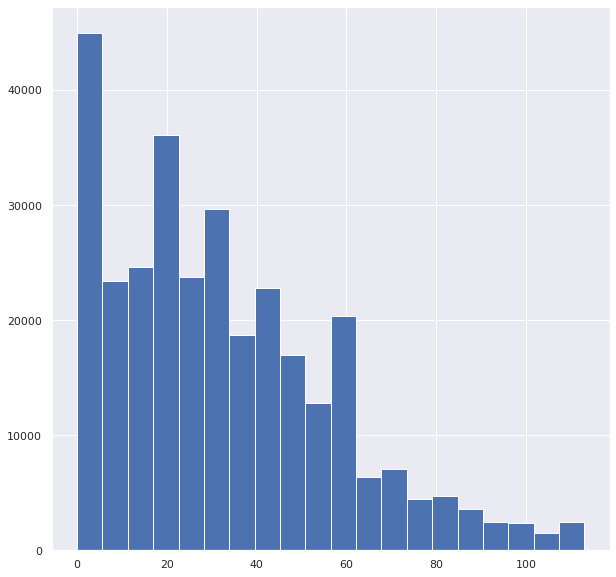

In [0]:
# create histogram of wind speed. Filtered to remove nulls and values higher than the world record of 253 mph (113 m/s)
bins, counts = decoded_weather_sample.where('WND_Speed_Rate <= 113').select('WND_Speed_Rate').rdd.flatMap(lambda x: x).histogram(20)
plt.hist(bins[:-1], bins=bins, weights=counts)

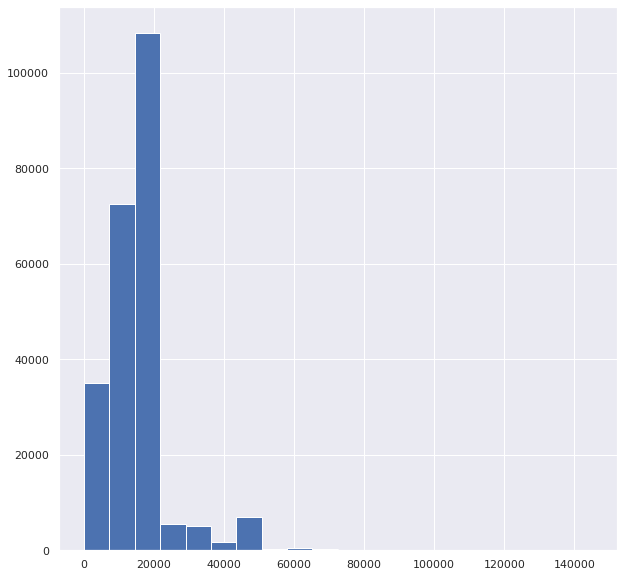

In [0]:
# create histogram of VIS distance code
bins, counts = decoded_weather_sample.where('VIS_Distance_Dimension < 999999').select('VIS_Distance_Dimension').rdd.flatMap(lambda x: x).histogram(20)
plt.hist(bins[:-1], bins=bins, weights=counts)

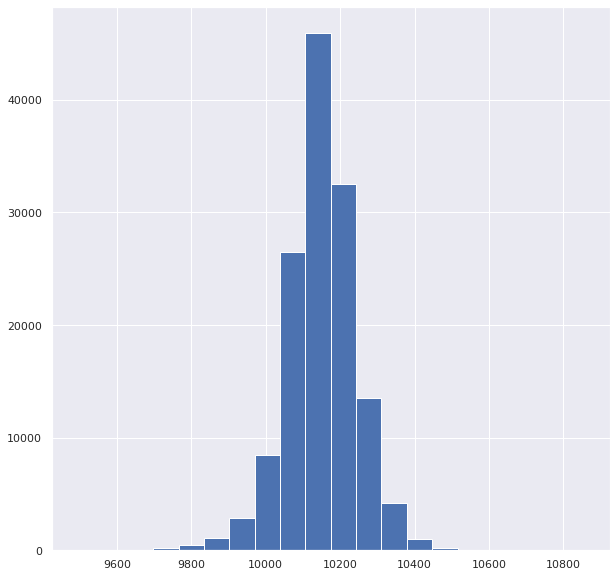

In [0]:
# create histogram of SLP level code
bins, counts = decoded_weather_sample.where('SLP_Sea_Level_Pres < 99999').select('SLP_Sea_Level_Pres').rdd.flatMap(lambda x: x).histogram(20)
plt.hist(bins[:-1], bins=bins, weights=counts)

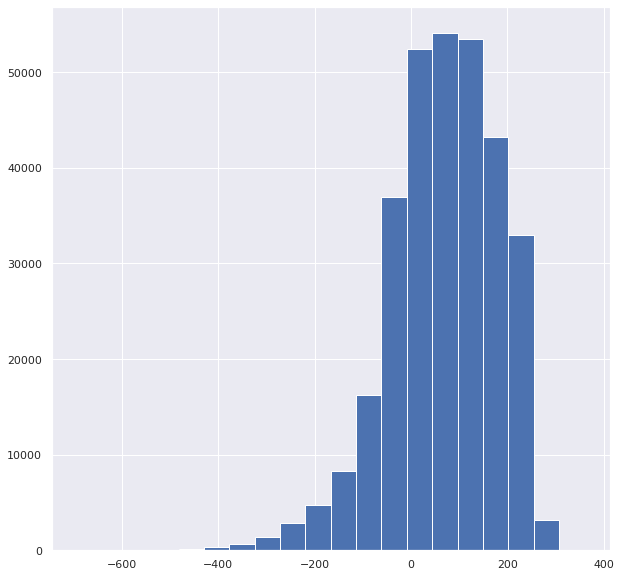

In [0]:
# create histogram of DEW field code
bins, counts = decoded_weather_sample.where('DEW_Point_Temp < 9999').select('DEW_Point_Temp').rdd.flatMap(lambda x: x).histogram(20)
plt.hist(bins[:-1], bins=bins, weights=counts)

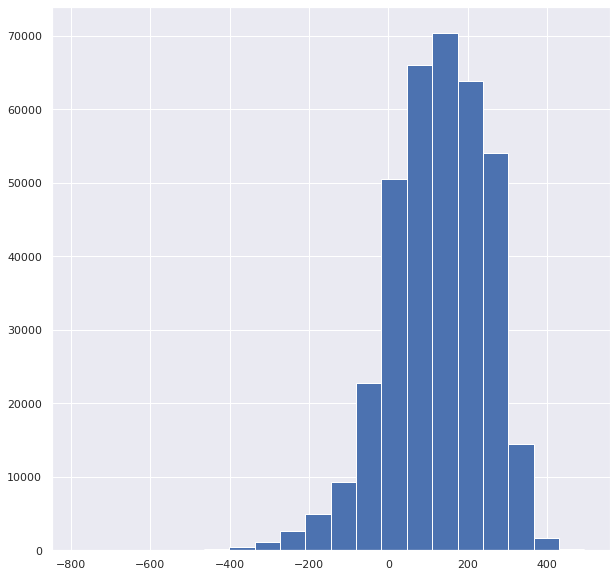

In [0]:
# create histogram of Air Temp code
bins, counts = decoded_weather_sample.where('TMP_Air_Temp < 9999').select('TMP_Air_Temp').rdd.flatMap(lambda x: x).histogram(20)
plt.hist(bins[:-1], bins=bins, weights=counts)

# Joining Weather to Station Data
The most efficient way to do this will be to first identify the station associated with each airport, add a column for that to the flights data, and then join directly flights to weather. Note this will require a composite key because we care about both **time** and **location**.  
  
### Composite Key Strategy
Our goal for joining the weather data to the flights is to capture the most accurate weather at inference time (two hours prior to a flight) to enable flight delay prediction as a function of weather. We plan to create a composite key that is comprised of the ID of the closest weather station to each airport, the date of the flight, and the hour of the flight minus two. Example: *01002099999-2019010105*. The number prior to the hyphen is the weather station id. After the hyphen we have  a datetime in the format of YYYYMMDDHH.  
  
**Note on real-world validity:** After performing our joins and modeling, we had the realization that this technique does not take into account the possibility of a station only having weather readings for a given hour that occur AFTER our desired inference time. If our data engineering and model were deployed in production we would be unable to make predictions for some number of flights because there would undoubtly be cases where no weather readings have been collected yet. We do not fall back on data from the previous hour.  
  
**Note on practical validity:** Because we discovered this issue at the 11th hour, we opted not to update our data pipeline or model. We believe our model still holds practical validity under the assumption that the weather conditions associated with our error are unlikely to be significantly different those that would exist had we accounted for our edge case. The maximum forward-error using our technique is 59 minutes, 59 seconds if inference time occurs exactly on the hour and the weather reading for that hour occurs 59 minutes and 59 seconds after the hour. If more time were available to us to work on this project we would have either corrected the issue and performed a statistical analysis of the error introduced by our technique.

Before we join the weather and station data, it is important to make sure each airport in our flight data is represented in our airports file.

In [0]:
flights_processed = spark.sql("select * from flights_processed")
weather_processed = spark.sql("select * from weather_processed")
stations_processed = spark.sql("select * from stations_processed")
airports_processed = spark.sql("select * from airports_processed")

In [0]:
%sql
SELECT DISTINCT(ORIGIN)
FROM flights_processed
WHERE ORIGIN NOT IN (SELECT IATA FROM airports_processed);

These airports were missing from the airport file. Let's add them to our silver repository. 

Tokeen, Kearney, Bullhead City and Williston

In [0]:
%sql
INSERT INTO airports_processed SELECT t.* FROM (SELECT 9999,"Tokeen Seaplane Base", "Tokeen", "United States", "TKI", "57A", "55.937222", "-133.326667", 0, -8, "A", "airport", "Internet", "America/Metlakatla" ) t;
INSERT INTO airports_processed SELECT t.* FROM (SELECT 9998,"Kearney Regional Airport", "Kearney", "United States", "EAR", "KEAR", "40.7270012", "-99.0067978", 2133, -5, "A", "airport", "Internet", "America/Chicago" ) t;
INSERT INTO airports_processed SELECT t.* FROM (SELECT 9997,"Laughlin Bullhead International Airport", "Bullhead City", "United States", "IFP", "KIFP", "35.1573982", "-114.5599976", 695, -7, "A", "airport", "Internet", "America/Phoenix" ) t;
INSERT INTO airports_processed SELECT t.* FROM (SELECT 9996,"Williston Basin International Airport", "Williston", "United States", "XWA", "KXWA", "48.1778984", "-103.6419983", 1982, -5, "A", "airport", "Internet", "America/Chicago" ) t;

Now that we have added the missing airports, let's check out the schema.

In [0]:
%sql
SELECT *
FROM airports_processed
LIMIT 1;

In [0]:
#re-retrieve airports_processed dataframe
airports_processed = spark.sql("select * from airports_processed")

### Get Distinct Stations From Weather Data
This ensures that we only use stations that are valid for our analysis period.

In [0]:
#create set of distinct ids from weather data
weather_distinct_ids = weather_processed.select('WEATHER_STATION').distinct()

#join distinct ids to stations tables and subset for matches
valid_stations = weather_distinct_ids.join(stations_processed,\
                                           weather_distinct_ids.WEATHER_STATION == stations_processed.STATION_USAF_WBAN,\
                                           'left').where('STATION_USAF_WBAN IS NOT NULL')


* Query the flights to get the minimum and maximum date. 
  * Per next two cells, flight data covers 1/1/2015-12/31/2019
* Query the stations to look at the start and end date to verify they are all active for the reporting period we are concerned with.

In [0]:
%sql
SELECT FL_DATE, COUNT(FL_DATE) 
FROM flights_processed
GROUP BY FL_DATE
ORDER BY FL_DATE DESC
LIMIT 3;

In [0]:
%sql
SELECT FL_DATE, COUNT(FL_DATE) 
FROM flights_processed
GROUP BY FL_DATE
ORDER BY FL_DATE ASC
LIMIT 3;

In [0]:
# get max station end date
display(valid_stations.select('STATION_END').sort(f.col("STATION_END").desc()).limit(3))

The stations table itself only has stations that show as active through March 2019, but is this reflected in the weather data?

In [0]:
%sql
SELECT WEATHER_DATE
FROM weather_processed
ORDER BY WEATHER_DATE DESC
LIMIT 1;

Weather data are collected through the end of 2019, so the ending date in the stations table is not reliable to use. Let's take a look at our valid stations.

In [0]:
display(valid_stations)

## Find Nearest Station to Each Airport
Now that we have only the stations that are valid for our analysis, we can find the nearest one to each airport.

Define a function for the Haversine distance. This is not perfect because it does not consider the projection used when determining the latitude and longitude in the stations and airport data. However, that information is unknown, so the Haversine distance should be a reasonable approximation.

In [0]:
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

Spark job for finding the closest stations. There is probably a better way to do this without converting stuff to RDDs, but this will work.

In [0]:
def find_closest_station(airports,stations):
    '''
    airports: rdd
    stations: rdd
    '''
    
    stations = sc.broadcast(stations.collect())
    
    def calc_distances(airport):
        airport_lon = float(airport['AIRPORT_LONG'])
        airport_lat = float(airport['AIRPORT_LAT'])

        for station in stations.value:
            if not station['STATION_LONG'] or not station['STATION_LAT']:
                continue
            station_lon = float(station['STATION_LONG'])
            station_lat = float(station['STATION_LAT'])
            station_id = station['STATION_USAF_WBAN']
            yield (airport['IATA'], (station_id, haversine(airport_lon, airport_lat, station_lon, station_lat)))
  
  
    def take_min(x,y):
      '''
      x and y are tuples of (airport, (station.id, distance))
      returns (airport, (argmin(station.id), min(distance)))
      '''
      minimum_index = np.argmin([x[1], y[1]])
      if minimum_index == 0:
          return x
      else:
          return y
      
    
    
    #output = airports.mapPartitions(calc_distances)
    output = airports.flatMap(calc_distances)
    #print(set(output.keys().collect()))           
    output = output.reduceByKey(lambda x, y: take_min(x,y))
    
    return output
  

In [0]:
# build aiport and station rdds
airports_rdd = airports_processed.rdd
stations_rdd = valid_stations.rdd

In [0]:
airports_rdd.take(1)[0]

In [0]:
stations_rdd.take(1)[0]

In [0]:
closest_stations = find_closest_station(airports_rdd,stations_rdd).cache()

In [0]:
airport_stations_loc = f"/airline_delays/{username}/DLRS/airport_stations/"

dbutils.fs.rm(airport_stations_loc + 'processed', recurse=True)


In [0]:
airports_stations = sqlContext.createDataFrame(closest_stations)

In [0]:
airports_stations.write.option('mergeSchema', True).mode('overwrite').format('delta').save(airport_stations_loc + 'processed')


In [0]:
%sql

DROP TABLE IF EXISTS airport_stations_processed;

CREATE TABLE airport_stations_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/airport_stations/processed"

In [0]:
%sql
select * from airport_stations_processed

### Need to look at Honolulu

In [0]:
%sql
SELECT *
FROM stations_processed
WHERE STATION_STATE = "HI"

In [0]:
%sql
SELECT WEATHER_STATION, COUNT(*) AS NUM_RECORDS
FROM weather_processed
WHERE WEATHER_STATION IN (SELECT STATION_USAF_WBAN FROM stations_processed WHERE STATION_STATE = "HI")
GROUP BY WEATHER_STATION
ORDER BY NUM_RECORDS DESC

In [0]:
airports_stations = airports_stations.withColumn("NEAREST_STATION_ID",f.col("_2")["_1"]).withColumn("NEAREST_STATION_DIST",f.col("_2")["_2"])
airports_stations =airports_stations.drop("_2")
airports_stations_origin = airports_stations.withColumnRenamed("_1", "IATA")
airports_stations_dest = airports_stations_origin

airports_stations_origin = airports_stations_origin.withColumnRenamed("IATA", "IATA_ORIGIN")
airports_stations_origin = airports_stations_origin.withColumnRenamed("NEAREST_STATION_ID", "NEAREST_STATION_ID_ORIGIN")
airports_stations_origin = airports_stations_origin.withColumnRenamed("NEAREST_STATION_DIST", "NEAREST_STATION_DIST_ORIGIN")

airports_stations_dest = airports_stations_dest.withColumnRenamed("IATA", "IATA_DEST")
airports_stations_dest = airports_stations_dest.withColumnRenamed("NEAREST_STATION_ID", "NEAREST_STATION_ID_DEST")
airports_stations_dest = airports_stations_dest.withColumnRenamed("NEAREST_STATION_DIST", "NEAREST_STATION_DIST_DEST")

In [0]:
display(airports_stations_origin)

In [0]:
display(airports_stations_dest)

## Join Nearest Stations to Flights

In [0]:
%sql
SELECT *
FROM flights_processed
LIMIT 1;

In [0]:
#flights_processed = spark.read.format('delta').load(f'{flights_loc}processed')
flights_processed = spark.sql("select * from flights_processed")

In [0]:
joined_flights_stations = flights_processed.join(f.broadcast(airports_stations_origin), flights_processed.ORIGIN == airports_stations_origin.IATA_ORIGIN, 'left')
joined_flights_stations = joined_flights_stations.join(f.broadcast(airports_stations_dest), joined_flights_stations.DEST == airports_stations_dest.IATA_DEST, 'left')

Now that we have our nearest weather stations for each flight, we need to create composite keys based on the time of the flight. That will require flight time adjustment to UTC because flight times are in the local time zone. To do that, we join a subset of the airport table to our joined flights and stations table.

In [0]:
#subset airports
airports_tz = airports_processed.select(['IATA', 'AIRPORT_TZ_NAME'])

#join flights with stations to airport_tz subset on the origin airport because only the departure time needs the UTC adjustment
joined_flights_stations_tz = joined_flights_stations.join(airports_tz, joined_flights_stations.ORIGIN == airports_tz.IATA, 'left')

Before continuing, we will store this data into our Silver Delta Lake.

In [0]:
joined_flights_stations_tz.count()

In [0]:
joined_flights_stations_tz.write.option('mergeSchema', True).mode('overwrite').format('delta').save(f'{flights_loc}processed')

In [0]:
%sql
SELECT *
FROM flights_processed
LIMIT 1;

### Create Composite Keys in Flight Data

In [0]:
# Ensure we are always using the most recent version of the data in the delta lake
#flights_processed = spark.read.format('delta').load(f'{flights_loc}processed')
flights_processed = spark.sql("select * from flights_processed")

In [0]:
flights_processed.count()

Define UDFs for creating composite keys in the flights data

In [0]:
def get_utc_datetime(year, month, day, hour, tz):
  tz = timezone(tz)
  utc = timezone('UTC')
  
  local_dt = datetime(int(year), int(month), int(day), hour=int(hour), tzinfo=tz)
  utc_dt = local_dt.astimezone(utc)
  
  return utc_dt

get_utc_datetime = udf(get_utc_datetime)

def get_flight_hour(flight_time):
    flight_time = str(flight_time)
    hour = ''
    if len(flight_time) in [1,2]:
        hour = '00'
    elif len(flight_time) == 3:
      hour = flight_time[0]
    elif len(flight_time) == 4:
      hour = flight_time[:2]
    return hour
  
get_flight_hour = udf(get_flight_hour)


def get_two_hour_adjusted_datetime(current_datetime):
  return (current_datetime - timedelta(hours=2))

get_two_hour_adjusted_datetime = udf(get_two_hour_adjusted_datetime)

def get_datetime_string(d):
  return d.strftime("%Y%m%d%H")

get_datetime_string = udf(get_datetime_string)

Create composite keys on flights data

In [0]:
# extract the hour from the departure time
flights_processed = flights_processed.withColumn("CRS_DEP_TIME_HOUR", get_flight_hour("CRS_DEP_TIME"))

In [0]:
#convert the flight time to UTC
flights_processed = flights_processed.withColumn("FLIGHT_TIME_UTC", get_utc_datetime("YEAR",\
                                                                                     "MONTH",\
                                                                                     "DAY_OF_MONTH",\
                                                                                      get_flight_hour("CRS_DEP_TIME"),\
                                                                                      "AIRPORT_TZ_NAME"))

In [0]:
# Get the weather prediction time T-2hours from departure
flights_processed = flights_processed.withColumn("WEATHER_PREDICTION_TIME_UTC",
                                                                             get_two_hour_adjusted_datetime("FLIGHT_TIME_UTC"))

In [0]:
# Convert the datetime objects to strings
flights_processed = flights_processed.withColumn("FLIGHT_TIME_UTC",
                                                 get_datetime_string("FLIGHT_TIME_UTC"))\
                                                 .withColumn("WEATHER_PREDICTION_TIME_UTC",
                                                 get_datetime_string("WEATHER_PREDICTION_TIME_UTC"))

In [0]:
#Finally, generate the composite keys for each station
flights_processed = flights_processed.withColumn("ORIGIN_WEATHER_KEY",
                                                 f.concat_ws("-", "nearest_station_id_ORIGIN", "WEATHER_PREDICTION_TIME_UTC"))\
                                     .withColumn("DEST_WEATHER_KEY",
                                                 f.concat_ws("-", "nearest_station_id_DEST", "WEATHER_PREDICTION_TIME_UTC"))

In [0]:
display(flights_processed) 

In [0]:
flights_processed.where('ORIGIN_WEATHER_KEY IS NULL OR DEST_WEATHER_KEY IS NULL').count()

Now we have composite keys to join the weather to these data. But first, lets land this in the delta lake

In [0]:
flights_processed.count()

In [0]:
flights_processed.write.option('mergeSchema', True).mode('overwrite').format('delta').save(f'{flights_loc}processed')

In [0]:
# Ensure we are always using the most recent version of the data in the delta lake
#flights_processed = spark.read.format('delta').load(f'{flights_loc}processed')
flights_processed = spark.sql("select * from flights_processed")

Honolulu is missing a lot of weather data so we will replace its weather key with that of Hilo
Station ID 99999921515

In [0]:
%sql
SELECT * FROM flights_processed
WHERE ORIGIN = "HNL"

In [0]:
%sql
SELECT * FROM flights_processed
WHERE DEST = "HNL"

In [0]:
#create udfs for fixing the HNL nearest stations and weather keys
def replace_HNL_weather_station_id(id):
    return "99999921515"
def fix_HNL_weather_key(weather_key):
    station, time = weather_key.split('-')
    new_weather_key = f'99999921515-{time}'
    return new_weather_key
  
# register UDFs
spark.udf.register("replace_HNL_weather_station_id", replace_HNL_weather_station_id)
spark.udf.register("fix_HNL_weather_key", fix_HNL_weather_key)



In [0]:
%sql
UPDATE flights_processed
SET nearest_station_id_ORIGIN = replace_HNL_weather_station_id(nearest_station_id_ORIGIN), ORIGIN_WEATHER_KEY = fix_HNL_weather_key(ORIGIN_WEATHER_KEY)
WHERE ORIGIN = "HNL"

In [0]:
%sql
SELECT * FROM flights_processed
WHERE ORIGIN = "HNL"

In [0]:
%sql
UPDATE flights_processed
SET nearest_station_id_DEST = replace_HNL_weather_station_id(nearest_station_id_DEST), DEST_WEATHER_KEY = fix_HNL_weather_key(DEST_WEATHER_KEY)
WHERE DEST = "HNL"

In [0]:
%sql
SELECT * FROM flights_processed
WHERE DEST = "HNL"

In [0]:
# Ensure we are always using the most recent version of the data in the delta lake
#flights_processed = spark.read.format('delta').load(f'{flights_loc}processed')
flights_processed = spark.sql("select * from flights_processed")

### Create Composite Keys in Weather Data

In [0]:
# Ensure we are always using the most recent version of the data in the delta lake
#weather_processed = spark.read.format('delta').load(f'{weather_loc}processed')
weather_processed = spark.sql("select * from weather_processed")

In [0]:
%sql 
SELECT COUNT(*)
FROM weather_processed
WHERE WEATHER_STATION IS NULL

Remove weather data with no station ID and store it back onto the delta lake (we won't use these records and saving it back now will reduce our time for future queries)

In [0]:
weather_processed.where("WEATHER_STATION IS NOT NULL").write.option('mergeSchema', True).mode('overwrite').format('delta').save(f'{weather_loc}processed')

In [0]:
# Ensure we are always using the most recent version of the data in the delta lake
#weather_processed = spark.read.format('delta').load(f'{weather_loc}processed')
weather_processed = spark.sql("select * from weather_processed")

Now we will define a UDF to create our composite weather key

In [0]:
weather_processed.printSchema()

In [0]:
def create_composite_weather_key(d, k):
    datestr = d.strftime("%Y-%m-%dT%H:%M:%S.%f%z")
    date, time = datestr.split("T")
    date_components = date.split("-")
    id_date_portion = "".join(date_components)
    id_hour_portion = time[:2]
    id_datetime_portion = id_date_portion+id_hour_portion
    the_id = "-".join([k,id_datetime_portion])
    return the_id
#create_composite_weather_key = udf(create_composite_weather_key)
spark.udf.register("create_composite_weather_key", create_composite_weather_key)

In [0]:
%sql
SELECT create_composite_weather_key(WEATHER_DATE, WEATHER_STATION)
FROM weather_processed;

In [0]:
weather_processed = spark.sql("SELECT *, create_composite_weather_key(WEATHER_DATE, WEATHER_STATION) AS WEATHER_KEY FROM weather_processed;")

before

In [0]:
%sql
SELECT * FROM weather_processed
LIMIT 1

after

In [0]:
display(weather_processed.limit(1))

In [0]:
weather_processed.write.option('mergeSchema', True).mode('overwrite').format('delta').save(f'{weather_loc}processed')

confirming

In [0]:
%sql
SELECT *
FROM weather_processed
LIMIT 1

## Join Weather to Flights

Weather data has multiple readings within the hour. We want just the first reading. So we'll apply a window join on a sub-select to retrieve it (as illustrated below).

In [0]:
%sql
SELECT * 
     FROM flights_processed fp
     JOIN ( 
            SELECT * FROM (
                  SELECT *, ROW_NUMBER() OVER ( 
                        partition by WEATHER_KEY 
                        ORDER BY WEATHER_DATE ASC 
                  ) as w1_row_num 
                  FROM weather_processed 
              ) as ordered_weather 
              WHERE ordered_weather.w1_row_num = 1 
          ) as w1 
          ON fp.ORIGIN_WEATHER_KEY = w1.WEATHER_KEY
LIMIT 10

In [0]:
flights_and_weather_origin_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_origin/"
flights_and_weather_origin_ren_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_origin_renamed/"
flights_and_weather_dest_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_dest/"
flights_and_weather_combined_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_combined/"


dbutils.fs.rm(flights_and_weather_origin_loc + "processed", recurse=True)
dbutils.fs.rm(flights_and_weather_origin_ren_loc + "processed", recurse=True)
dbutils.fs.rm(flights_and_weather_dest_loc + "processed", recurse=True)
dbutils.fs.rm(flights_and_weather_combined_loc + "processed", recurse=True)

In [0]:
%sql 
CREATE OR REPLACE TABLE flights_and_weather_origin 
USING DELTA 
LOCATION '/airline_delays/$username/DLRS/flights_and_weather_origin/processed' 
AS SELECT * FROM flights_processed fp LEFT
JOIN (SELECT * 
      FROM (SELECT *, ROW_NUMBER() 
            OVER (PARTITION BY wp.WEATHER_KEY
                  ORDER BY wp.WEATHER_DATE ASC) AS ORIGIN_ROW_NUM
            FROM weather_processed wp) AS w
      WHERE w.ORIGIN_ROW_NUM = 1) AS w1 
ON fp.ORIGIN_WEATHER_KEY = w1.WEATHER_KEY

In [0]:
%sql
select count(*) from flights_and_weather_origin

In [0]:
%sql CREATE OR REPLACE TABLE flights_and_weather_origin_renamed USING DELTA LOCATION '/airline_delays/$username/DLRS/flights_and_weather_origin_renamed/processed' AS
SELECT fp.YEAR,fp.QUARTER,fp.MONTH,fp.DAY_OF_MONTH,fp.DAY_OF_WEEK, fp.OP_UNIQUE_CARRIER,
       fp.OP_CARRIER_AIRLINE_ID,fp.OP_CARRIER,fp.TAIL_NUM,fp.OP_CARRIER_FL_NUM,
       fp.ORIGIN_AIRPORT_ID,fp.ORIGIN_AIRPORT_SEQ_ID,fp.ORIGIN_CITY_MARKET_ID,
       fp.ORIGIN,fp.ORIGIN_CITY_NAME,fp.ORIGIN_STATE_ABR,fp.ORIGIN_STATE_FIPS,
       fp.ORIGIN_STATE_NM,fp.ORIGIN_WAC,fp.DEST_AIRPORT_ID, fp.DEST_AIRPORT_SEQ_ID,
       fp.DEST_CITY_MARKET_ID,fp.DEST,fp.DEST_CITY_NAME,fp.DEST_STATE_ABR, fp.DEST_STATE_FIPS,
       fp.DEST_STATE_NM,fp.DEST_WAC,fp.CRS_DEP_TIME,fp.DEP_TIME,fp.DEP_DELAY, fp.DEP_DELAY_NEW,
       fp.DEP_DEL15,fp.DEP_DELAY_GROUP,fp.DEP_TIME_BLK,fp.TAXI_OUT,
       fp.WHEELS_OFF,fp.WHEELS_ON,fp.TAXI_IN,fp.CRS_ARR_TIME,fp.ARR_TIME, fp.ARR_DELAY,
       fp.ARR_DELAY_NEW,fp.ARR_DEL15,fp.ARR_DELAY_GROUP,fp.ARR_TIME_BLK, fp.CANCELLED,
       fp.CANCELLATION_CODE,fp.DIVERTED,fp.CRS_ELAPSED_TIME, fp.ACTUAL_ELAPSED_TIME,fp.AIR_TIME,
       fp.FLIGHTS,fp.DISTANCE,fp.DISTANCE_GROUP,fp.CARRIER_DELAY, fp.WEATHER_DELAY,
       fp.NAS_DELAY,fp.SECURITY_DELAY,fp.LATE_AIRCRAFT_DELAY,fp.FIRST_DEP_TIME,
       fp.TOTAL_ADD_GTIME,fp.LONGEST_ADD_GTIME,fp.DIV_AIRPORT_LANDINGS, fp.DIV_REACHED_DEST,
       fp.DIV_ACTUAL_ELAPSED_TIME,fp.DIV_ARR_DELAY,fp.DIV_DISTANCE, fp.DIV1_AIRPORT,fp.DIV1_AIRPORT_ID,
       fp.DIV1_AIRPORT_SEQ_ID,fp.DIV1_WHEELS_ON,fp.DIV1_TOTAL_GTIME, fp.DIV1_LONGEST_GTIME,
       fp.DIV1_WHEELS_OFF,fp.DIV1_TAIL_NUM,fp.DIV2_AIRPORT,fp.DIV2_AIRPORT_ID,
       fp.DIV2_AIRPORT_SEQ_ID,fp.DIV2_WHEELS_ON,fp.DIV2_TOTAL_GTIME, fp.DIV2_LONGEST_GTIME,
       fp.DIV2_WHEELS_OFF,fp.DIV2_TAIL_NUM,fp.DIV3_AIRPORT,fp.DIV3_AIRPORT_ID,
       fp.DIV3_AIRPORT_SEQ_ID,fp.DIV3_WHEELS_ON,fp.DIV3_TOTAL_GTIME, fp.DIV3_LONGEST_GTIME,
       fp.DIV3_WHEELS_OFF,fp.DIV3_TAIL_NUM,fp.DIV4_AIRPORT,fp.DIV4_AIRPORT_ID,
       fp.DIV4_AIRPORT_SEQ_ID,fp.DIV4_WHEELS_ON,fp.DIV4_TOTAL_GTIME, fp.DIV4_LONGEST_GTIME,
       fp.DIV4_WHEELS_OFF,fp.DIV4_TAIL_NUM,fp.DIV5_AIRPORT,fp.DIV5_AIRPORT_ID,
       fp.DIV5_AIRPORT_SEQ_ID,fp.DIV5_WHEELS_ON,fp.DIV5_TOTAL_GTIME, fp.DIV5_LONGEST_GTIME,
       fp.DIV5_WHEELS_OFF,fp.DIV5_TAIL_NUM,fp.IN_FLIGHT_AIR_DELAY,fp.FL_DATE, fp.IATA_ORIGIN,
       fp.NEAREST_STATION_ID_ORIGIN,fp.NEAREST_STATION_DIST_ORIGIN,fp.IATA_DEST,
       fp.NEAREST_STATION_ID_DEST,fp.NEAREST_STATION_DIST_DEST,fp.IATA, fp.AIRPORT_TZ_NAME,
       fp.CRS_DEP_TIME_HOUR,fp.FLIGHT_TIME_UTC,fp.WEATHER_PREDICTION_TIME_UTC,
       fp.ORIGIN_WEATHER_KEY,fp.WEATHER_STATION as ORIGIN_WEATHER_STATION,
       fp.WEATHER_SOURCE as ORIGIN_WEATHER_SOURCE,
       fp.WEATHER_LAT as ORIGIN_WEATHER_LAT,fp.WEATHER_LON as ORIGIN_WEATHER_LON,fp.WEATHER_ELEV as ORIGIN_WEATHER_ELEV,
       fp.WEATHER_NAME as ORIGIN_WEATHER_NAME, fp.WEATHER_REPORT_TYPE as ORIGIN_WEATHER_REPORT_TYPE,
       fp.WEATHER_CALL_SIGN as ORIGIN_WEATHER_CALL_SIGN, fp.QUALITY_CONTROL as ORIGIN_QUALITY_CONTROL,fp.WND as ORIGIN_WND,
       fp.CIG as ORIGIN_CIG,fp.VIS as ORIGIN_VIS,fp.TMP as ORIGIN_TMP,
       fp.DEW as ORIGIN_DEW,fp.SLP as ORIGIN_SLP,fp.AW1 as ORIGIN_AW1,
       fp.GA1 as ORIGIN_GA1,fp.GA2 as ORIGIN_GA2,fp.GA3 as ORIGIN_GA3,
       fp.GA4 as ORIGIN_GA4,fp.GE1 as ORIGIN_GE1,fp.GF1 as ORIGIN_GF1,
       fp.KA1 as ORIGIN_KA1,fp.KA2 as ORIGIN_KA2,fp.MA1 as ORIGIN_MA1,
       fp.MD1 as ORIGIN_MD1,fp.MW1 as ORIGIN_MW1,fp.MW2 as ORIGIN_MW2,
       fp.OC1 as ORIGIN_OC1,fp.OD1 as ORIGIN_OD1,fp.OD2 as ORIGIN_OD2,
       fp.REM as ORIGIN_REM,fp.EQD as ORIGIN_EQD,fp.AW2 as ORIGIN_AW2,
       fp.AX4 as ORIGIN_AX4,fp.GD1 as ORIGIN_GD1,fp.AW5 as ORIGIN_AW5,
       fp.GN1 as ORIGIN_GN1,fp.AJ1 as ORIGIN_AJ1,fp.AW3 as ORIGIN_AW3,
       fp.MK1 as ORIGIN_MK1,fp.KA4 as ORIGIN_KA4,fp.GG3 as ORIGIN_GG3,
       fp.AN1 as ORIGIN_AN1,fp.RH1 as ORIGIN_RH1,fp.AU5 as ORIGIN_AU5,
       fp.HL1 as ORIGIN_HL1,fp.OB1 as ORIGIN_OB1,fp.AT8 as ORIGIN_AT8,
       fp.AW7 as ORIGIN_AW7,fp.AZ1 as ORIGIN_AZ1,fp.CH1 as ORIGIN_CH1,
       fp.RH3 as ORIGIN_RH3,fp.GK1 as ORIGIN_GK1,fp.IB1 as ORIGIN_IB1,
       fp.AX1 as ORIGIN_AX1,fp.CT1 as ORIGIN_CT1,fp.AK1 as ORIGIN_AK1,
       fp.CN2 as ORIGIN_CN2,fp.OE1 as ORIGIN_OE1,fp.MW5 as ORIGIN_MW5,
       fp.AO1 as ORIGIN_AO1,fp.KA3 as ORIGIN_KA3,fp.AA3 as ORIGIN_AA3,
       fp.CR1 as ORIGIN_CR1,fp.CF2 as ORIGIN_CF2,fp.KB2 as ORIGIN_KB2,
       fp.GM1 as ORIGIN_GM1,fp.AT5 as ORIGIN_AT5,fp.AY2 as ORIGIN_AY2,
       fp.MW6 as ORIGIN_MW6,fp.MG1 as ORIGIN_MG1,fp.AH6 as ORIGIN_AH6,
       fp.AU2 as ORIGIN_AU2,fp.GD2 as ORIGIN_GD2,fp.AW4 as ORIGIN_AW4,
       fp.MF1 as ORIGIN_MF1,fp.AA1 as ORIGIN_AA1,fp.AH2 as ORIGIN_AH2,
       fp.AH3 as ORIGIN_AH3,fp.OE3 as ORIGIN_OE3,fp.AT6 as ORIGIN_AT6,
       fp.AL2 as ORIGIN_AL2,fp.AL3 as ORIGIN_AL3,fp.AX5 as ORIGIN_AX5,
       fp.IB2 as ORIGIN_IB2,fp.AI3 as ORIGIN_AI3,fp.CV3 as ORIGIN_CV3,
       fp.WA1 as ORIGIN_WA1,fp.GH1 as ORIGIN_GH1,fp.KF1 as ORIGIN_KF1,
       fp.CU2 as ORIGIN_CU2,fp.CT3 as ORIGIN_CT3,fp.SA1 as ORIGIN_SA1,
       fp.AU1 as ORIGIN_AU1,fp.KD2 as ORIGIN_KD2,fp.AI5 as ORIGIN_AI5,
       fp.GO1 as ORIGIN_GO1,fp.GD3 as ORIGIN_GD3,fp.CG3 as ORIGIN_CG3,
       fp.AI1 as ORIGIN_AI1,fp.AL1 as ORIGIN_AL1,fp.AW6 as ORIGIN_AW6,
       fp.MW4 as ORIGIN_MW4,fp.AX6 as ORIGIN_AX6,fp.CV1 as ORIGIN_CV1,
       fp.ME1 as ORIGIN_ME1,fp.KC2 as ORIGIN_KC2,fp.CN1 as ORIGIN_CN1,
       fp.UA1 as ORIGIN_UA1,fp.GD5 as ORIGIN_GD5,fp.UG2 as ORIGIN_UG2,
       fp.AT3 as ORIGIN_AT3,fp.AT4 as ORIGIN_AT4,fp.GJ1 as ORIGIN_GJ1,
       fp.MV1 as ORIGIN_MV1,fp.GA5 as ORIGIN_GA5,fp.CT2 as ORIGIN_CT2,
       fp.CG2 as ORIGIN_CG2,fp.ED1 as ORIGIN_ED1,fp.AE1 as ORIGIN_AE1,
       fp.CO1 as ORIGIN_CO1,fp.KE1 as ORIGIN_KE1,fp.KB1 as ORIGIN_KB1,
       fp.AI4 as ORIGIN_AI4,fp.MW3 as ORIGIN_MW3,fp.KG2 as ORIGIN_KG2,
       fp.AA2 as ORIGIN_AA2,fp.AX2 as ORIGIN_AX2,fp.AY1 as ORIGIN_AY1,
       fp.RH2 as ORIGIN_RH2,fp.OE2 as ORIGIN_OE2,fp.CU3 as ORIGIN_CU3,
       fp.MH1 as ORIGIN_MH1,fp.AM1 as ORIGIN_AM1,fp.AU4 as ORIGIN_AU4,
       fp.GA6 as ORIGIN_GA6,fp.KG1 as ORIGIN_KG1,fp.AU3 as ORIGIN_AU3,
       fp.AT7 as ORIGIN_AT7,fp.KD1 as ORIGIN_KD1,fp.GL1 as ORIGIN_GL1,
       fp.IA1 as ORIGIN_IA1,fp.GG2 as ORIGIN_GG2,fp.OD3 as ORIGIN_OD3,
       fp.UG1 as ORIGIN_UG1,fp.CB1 as ORIGIN_CB1,fp.AI6 as ORIGIN_AI6,
       fp.CI1 as ORIGIN_CI1,fp.CV2 as ORIGIN_CV2,fp.AZ2 as ORIGIN_AZ2,
       fp.AD1 as ORIGIN_AD1,fp.AH1 as ORIGIN_AH1,fp.WD1 as ORIGIN_WD1,
       fp.AA4 as ORIGIN_AA4,fp.KC1 as ORIGIN_KC1,fp.IA2 as ORIGIN_IA2,
       fp.CF3 as ORIGIN_CF3,fp.AI2 as ORIGIN_AI2,fp.AT1 as ORIGIN_AT1,
       fp.GD4 as ORIGIN_GD4,fp.AX3 as ORIGIN_AX3,fp.AH4 as ORIGIN_AH4,
       fp.KB3 as ORIGIN_KB3,fp.CU1 as ORIGIN_CU1,fp.CN4 as ORIGIN_CN4,
       fp.AT2 as ORIGIN_AT2,fp.CG1 as ORIGIN_CG1,fp.CF1 as ORIGIN_CF1,
       fp.GG1 as ORIGIN_GG1,fp.MV2 as ORIGIN_MV2,fp.CW1 as ORIGIN_CW1,
       fp.GG4 as ORIGIN_GG4,fp.AB1 as ORIGIN_AB1,fp.AH5 as ORIGIN_AH5,
       fp.CN3 as ORIGIN_CN3,fp.WEATHER_DATE as ORIGIN_WEATHER_DATE,
       fp.DEST_WEATHER_KEY
FROM   flights_and_weather_origin fp 

In [0]:
%sql CREATE OR REPLACE TABLE flights_and_weather_dest USING DELTA LOCATION '/airline_delays/$username/DLRS/flights_and_weather_dest/processed' AS
SELECT
  *
FROM
  flights_and_weather_origin_renamed fp LEFT
  JOIN (
    SELECT
      *
    FROM
      (
        SELECT
          *,
          ROW_NUMBER() OVER (
            partition by wp.WEATHER_KEY
            ORDER BY
              wp.WEATHER_DATE ASC
          ) as DEST_ROW_NUM
        FROM
          weather_processed wp
      ) as w
    WHERE
      w.DEST_ROW_NUM = 1
  ) as w1 ON fp.DEST_WEATHER_KEY = w1.WEATHER_KEY

In [0]:
%sql CREATE OR REPLACE TABLE flights_and_weather_combined USING DELTA PARTITIONED BY (fL_DATE) LOCATION '/airline_delays/$username/DLRS/flights_and_weather_combined/processed' AS
SELECT fp.YEAR,fp.QUARTER,fp.MONTH,fp.DAY_OF_MONTH,fp.DAY_OF_WEEK, fp.OP_UNIQUE_CARRIER, 
       fp.OP_CARRIER_AIRLINE_ID,fp.OP_CARRIER,fp.TAIL_NUM,fp.OP_CARRIER_FL_NUM, 
       fp.ORIGIN_AIRPORT_ID,fp.ORIGIN_AIRPORT_SEQ_ID,fp.ORIGIN_CITY_MARKET_ID, 
       fp.ORIGIN,fp.ORIGIN_CITY_NAME,fp.ORIGIN_STATE_ABR,fp.ORIGIN_STATE_FIPS, 
       fp.ORIGIN_STATE_NM,fp.ORIGIN_WAC,fp.DEST_AIRPORT_ID, fp.DEST_AIRPORT_SEQ_ID, 
       fp.DEST_CITY_MARKET_ID,fp.DEST,fp.DEST_CITY_NAME,fp.DEST_STATE_ABR, fp.DEST_STATE_FIPS, 
       fp.DEST_STATE_NM,fp.DEST_WAC,fp.CRS_DEP_TIME,fp.DEP_TIME,fp.DEP_DELAY, fp.DEP_DELAY_NEW, 
       fp.DEP_DEL15,fp.DEP_DELAY_GROUP,fp.DEP_TIME_BLK,fp.TAXI_OUT, 
       fp.WHEELS_OFF,fp.WHEELS_ON,fp.TAXI_IN,fp.CRS_ARR_TIME,fp.ARR_TIME, fp.ARR_DELAY, 
       fp.ARR_DELAY_NEW,fp.ARR_DEL15,fp.ARR_DELAY_GROUP,fp.ARR_TIME_BLK, fp.CANCELLED, 
       fp.CANCELLATION_CODE,fp.DIVERTED,fp.CRS_ELAPSED_TIME, fp.ACTUAL_ELAPSED_TIME,fp.AIR_TIME, 
       fp.FLIGHTS,fp.DISTANCE,fp.DISTANCE_GROUP,fp.CARRIER_DELAY, fp.WEATHER_DELAY, 
       fp.NAS_DELAY,fp.SECURITY_DELAY,fp.LATE_AIRCRAFT_DELAY,fp.FIRST_DEP_TIME, 
       fp.TOTAL_ADD_GTIME,fp.LONGEST_ADD_GTIME,fp.DIV_AIRPORT_LANDINGS, fp.DIV_REACHED_DEST, 
       fp.DIV_ACTUAL_ELAPSED_TIME,fp.DIV_ARR_DELAY,fp.DIV_DISTANCE, fp.DIV1_AIRPORT,fp.DIV1_AIRPORT_ID, 
       fp.DIV1_AIRPORT_SEQ_ID,fp.DIV1_WHEELS_ON,fp.DIV1_TOTAL_GTIME, fp.DIV1_LONGEST_GTIME, 
       fp.DIV1_WHEELS_OFF,fp.DIV1_TAIL_NUM,fp.DIV2_AIRPORT,fp.DIV2_AIRPORT_ID, 
       fp.DIV2_AIRPORT_SEQ_ID,fp.DIV2_WHEELS_ON,fp.DIV2_TOTAL_GTIME, fp.DIV2_LONGEST_GTIME, 
       fp.DIV2_WHEELS_OFF,fp.DIV2_TAIL_NUM,fp.DIV3_AIRPORT,fp.DIV3_AIRPORT_ID, 
       fp.DIV3_AIRPORT_SEQ_ID,fp.DIV3_WHEELS_ON,fp.DIV3_TOTAL_GTIME, fp.DIV3_LONGEST_GTIME, 
       fp.DIV3_WHEELS_OFF,fp.DIV3_TAIL_NUM,fp.DIV4_AIRPORT,fp.DIV4_AIRPORT_ID, 
       fp.DIV4_AIRPORT_SEQ_ID,fp.DIV4_WHEELS_ON,fp.DIV4_TOTAL_GTIME, fp.DIV4_LONGEST_GTIME, 
       fp.DIV4_WHEELS_OFF,fp.DIV4_TAIL_NUM,fp.DIV5_AIRPORT,fp.DIV5_AIRPORT_ID, 
       fp.DIV5_AIRPORT_SEQ_ID,fp.DIV5_WHEELS_ON,fp.DIV5_TOTAL_GTIME, fp.DIV5_LONGEST_GTIME, 
       fp.DIV5_WHEELS_OFF,fp.DIV5_TAIL_NUM,fp.IN_FLIGHT_AIR_DELAY,fp.FL_DATE, fp.IATA_ORIGIN, 
       fp.NEAREST_STATION_ID_ORIGIN,fp.NEAREST_STATION_DIST_ORIGIN,fp.IATA_DEST, 
       fp.NEAREST_STATION_ID_DEST,fp.NEAREST_STATION_DIST_DEST,fp.IATA, fp.AIRPORT_TZ_NAME, 
       fp.CRS_DEP_TIME_HOUR,fp.FLIGHT_TIME_UTC,fp.WEATHER_PREDICTION_TIME_UTC, 
       fp.ORIGIN_WEATHER_KEY,fp.ORIGIN_WEATHER_STATION, 
       fp.ORIGIN_WEATHER_SOURCE,fp.ORIGIN_WEATHER_LAT,fp.ORIGIN_WEATHER_LON, fp.ORIGIN_WEATHER_ELEV, 
       fp.ORIGIN_WEATHER_NAME,fp.ORIGIN_WEATHER_REPORT_TYPE, fp.ORIGIN_WEATHER_CALL_SIGN, 
       fp.ORIGIN_QUALITY_CONTROL,fp.ORIGIN_WND,fp.ORIGIN_CIG,fp.ORIGIN_VIS, fp.ORIGIN_TMP,fp.ORIGIN_DEW, 
       fp.ORIGIN_SLP,fp.ORIGIN_AW1,fp.ORIGIN_GA1,fp.ORIGIN_GA2,fp.ORIGIN_GA3, 
       fp.ORIGIN_GA4,fp.ORIGIN_GE1,fp.ORIGIN_GF1,fp.ORIGIN_KA1,fp.ORIGIN_KA2, fp.ORIGIN_MA1, 
       fp.ORIGIN_MD1,fp.ORIGIN_MW1,fp.ORIGIN_MW2,fp.ORIGIN_OC1,fp.ORIGIN_OD1, 
       fp.ORIGIN_OD2,fp.ORIGIN_REM,fp.ORIGIN_EQD,fp.ORIGIN_AW2,fp.ORIGIN_AX4, fp.ORIGIN_GD1, 
       fp.ORIGIN_AW5,fp.ORIGIN_GN1,fp.ORIGIN_AJ1,fp.ORIGIN_AW3,fp.ORIGIN_MK1, 
       fp.ORIGIN_KA4,fp.ORIGIN_GG3,fp.ORIGIN_AN1,fp.ORIGIN_RH1,fp.ORIGIN_AU5, fp.ORIGIN_HL1, 
       fp.ORIGIN_OB1,fp.ORIGIN_AT8,fp.ORIGIN_AW7,fp.ORIGIN_AZ1,fp.ORIGIN_CH1, 
       fp.ORIGIN_RH3,fp.ORIGIN_GK1,fp.ORIGIN_IB1,fp.ORIGIN_AX1,fp.ORIGIN_CT1, fp.ORIGIN_AK1, 
       fp.ORIGIN_CN2,fp.ORIGIN_OE1,fp.ORIGIN_MW5,fp.ORIGIN_AO1,fp.ORIGIN_KA3, 
       fp.ORIGIN_AA3,fp.ORIGIN_CR1,fp.ORIGIN_CF2,fp.ORIGIN_KB2,fp.ORIGIN_GM1, fp.ORIGIN_AT5, 
       fp.ORIGIN_AY2,fp.ORIGIN_MW6,fp.ORIGIN_MG1,fp.ORIGIN_AH6,fp.ORIGIN_AU2, 
       fp.ORIGIN_GD2,fp.ORIGIN_AW4,fp.ORIGIN_MF1,fp.ORIGIN_AA1,fp.ORIGIN_AH2, fp.ORIGIN_AH3, 
       fp.ORIGIN_OE3,fp.ORIGIN_AT6,fp.ORIGIN_AL2,fp.ORIGIN_AL3,fp.ORIGIN_AX5, 
       fp.ORIGIN_IB2,fp.ORIGIN_AI3,fp.ORIGIN_CV3,fp.ORIGIN_WA1,fp.ORIGIN_GH1, fp.ORIGIN_KF1, 
       fp.ORIGIN_CU2,fp.ORIGIN_CT3,fp.ORIGIN_SA1,fp.ORIGIN_AU1,fp.ORIGIN_KD2, 
       fp.ORIGIN_AI5,fp.ORIGIN_GO1,fp.ORIGIN_GD3,fp.ORIGIN_CG3,fp.ORIGIN_AI1, fp.ORIGIN_AL1, 
       fp.ORIGIN_AW6,fp.ORIGIN_MW4,fp.ORIGIN_AX6,fp.ORIGIN_CV1,fp.ORIGIN_ME1, 
       fp.ORIGIN_KC2,fp.ORIGIN_CN1,fp.ORIGIN_UA1,fp.ORIGIN_GD5,fp.ORIGIN_UG2, fp.ORIGIN_AT3, 
       fp.ORIGIN_AT4,fp.ORIGIN_GJ1,fp.ORIGIN_MV1,fp.ORIGIN_GA5,fp.ORIGIN_CT2, 
       fp.ORIGIN_CG2,fp.ORIGIN_ED1,fp.ORIGIN_AE1,fp.ORIGIN_CO1,fp.ORIGIN_KE1, fp.ORIGIN_KB1, 
       fp.ORIGIN_AI4,fp.ORIGIN_MW3,fp.ORIGIN_KG2,fp.ORIGIN_AA2,fp.ORIGIN_AX2, 
       fp.ORIGIN_AY1,fp.ORIGIN_RH2,fp.ORIGIN_OE2,fp.ORIGIN_CU3,fp.ORIGIN_MH1, fp.ORIGIN_AM1, 
       fp.ORIGIN_AU4,fp.ORIGIN_GA6,fp.ORIGIN_KG1,fp.ORIGIN_AU3,fp.ORIGIN_AT7, 
       fp.ORIGIN_KD1,fp.ORIGIN_GL1,fp.ORIGIN_IA1,fp.ORIGIN_GG2,fp.ORIGIN_OD3, fp.ORIGIN_UG1, 
       fp.ORIGIN_CB1,fp.ORIGIN_AI6,fp.ORIGIN_CI1,fp.ORIGIN_CV2,fp.ORIGIN_AZ2, 
       fp.ORIGIN_AD1,fp.ORIGIN_AH1,fp.ORIGIN_WD1,fp.ORIGIN_AA4,fp.ORIGIN_KC1, fp.ORIGIN_IA2, 
       fp.ORIGIN_CF3,fp.ORIGIN_AI2,fp.ORIGIN_AT1,fp.ORIGIN_GD4,fp.ORIGIN_AX3, 
       fp.ORIGIN_AH4,fp.ORIGIN_KB3,fp.ORIGIN_CU1,fp.ORIGIN_CN4,fp.ORIGIN_AT2, fp.ORIGIN_CG1, 
       fp.ORIGIN_CF1,fp.ORIGIN_GG1,fp.ORIGIN_MV2,fp.ORIGIN_CW1,fp.ORIGIN_GG4, 
       fp.ORIGIN_AB1,fp.ORIGIN_AH5,fp.ORIGIN_CN3,fp.ORIGIN_WEATHER_DATE, 
       fp.DEST_WEATHER_KEY,fp.WEATHER_STATION as DEST_WEATHER_STATION, 
       fp.WEATHER_SOURCE as DEST_WEATHER_SOURCE, fp.WEATHER_LAT as DEST_WEATHER_LAT,fp.WEATHER_LON as DEST_WEATHER_LON, 
       fp.WEATHER_ELEV as DEST_WEATHER_ELEV,fp.WEATHER_NAME as DEST_WEATHER_NAME, fp.WEATHER_REPORT_TYPE as DEST_WEATHER_REPORT_TYPE, 
       fp.WEATHER_CALL_SIGN as DEST_WEATHER_CALL_SIGN, fp.QUALITY_CONTROL as DEST_QUALITY_CONTROL,fp.WND as DEST_WND, 
       fp.CIG as DEST_CIG,fp.VIS as DEST_VIS,fp.TMP as DEST_TMP, 
       fp.DEW as DEST_DEW,fp.SLP as DEST_SLP,fp.AW1 as DEST_AW1, 
       fp.GA1 as DEST_GA1,fp.GA2 as DEST_GA2,fp.GA3 as DEST_GA3, 
       fp.GA4 as DEST_GA4,fp.GE1 as DEST_GE1,fp.GF1 as DEST_GF1, 
       fp.KA1 as DEST_KA1,fp.KA2 as DEST_KA2,fp.MA1 as DEST_MA1, 
       fp.MD1 as DEST_MD1,fp.MW1 as DEST_MW1,fp.MW2 as DEST_MW2, 
       fp.OC1 as DEST_OC1,fp.OD1 as DEST_OD1,fp.OD2 as DEST_OD2, 
       fp.REM as DEST_REM,fp.EQD as DEST_EQD,fp.AW2 as DEST_AW2, 
       fp.AX4 as DEST_AX4,fp.GD1 as DEST_GD1,fp.AW5 as DEST_AW5, 
       fp.GN1 as DEST_GN1,fp.AJ1 as DEST_AJ1,fp.AW3 as DEST_AW3, 
       fp.MK1 as DEST_MK1,fp.KA4 as DEST_KA4,fp.GG3 as DEST_GG3, 
       fp.AN1 as DEST_AN1,fp.RH1 as DEST_RH1,fp.AU5 as DEST_AU5, 
       fp.HL1 as DEST_HL1,fp.OB1 as DEST_OB1,fp.AT8 as DEST_AT8, 
       fp.AW7 as DEST_AW7,fp.AZ1 as DEST_AZ1,fp.CH1 as DEST_CH1, 
       fp.RH3 as DEST_RH3,fp.GK1 as DEST_GK1,fp.IB1 as DEST_IB1, 
       fp.AX1 as DEST_AX1,fp.CT1 as DEST_CT1,fp.AK1 as DEST_AK1, 
       fp.CN2 as DEST_CN2,fp.OE1 as DEST_OE1,fp.MW5 as DEST_MW5, 
       fp.AO1 as DEST_AO1,fp.KA3 as DEST_KA3,fp.AA3 as DEST_AA3, 
       fp.CR1 as DEST_CR1,fp.CF2 as DEST_CF2,fp.KB2 as DEST_KB2, 
       fp.GM1 as DEST_GM1,fp.AT5 as DEST_AT5,fp.AY2 as DEST_AY2, 
       fp.MW6 as DEST_MW6,fp.MG1 as DEST_MG1,fp.AH6 as DEST_AH6, 
       fp.AU2 as DEST_AU2,fp.GD2 as DEST_GD2,fp.AW4 as DEST_AW4, 
       fp.MF1 as DEST_MF1,fp.AA1 as DEST_AA1,fp.AH2 as DEST_AH2, 
       fp.AH3 as DEST_AH3,fp.OE3 as DEST_OE3,fp.AT6 as DEST_AT6, 
       fp.AL2 as DEST_AL2,fp.AL3 as DEST_AL3,fp.AX5 as DEST_AX5, 
       fp.IB2 as DEST_IB2,fp.AI3 as DEST_AI3,fp.CV3 as DEST_CV3, 
       fp.WA1 as DEST_WA1,fp.GH1 as DEST_GH1,fp.KF1 as DEST_KF1, 
       fp.CU2 as DEST_CU2,fp.CT3 as DEST_CT3,fp.SA1 as DEST_SA1, 
       fp.AU1 as DEST_AU1,fp.KD2 as DEST_KD2,fp.AI5 as DEST_AI5, 
       fp.GO1 as DEST_GO1,fp.GD3 as DEST_GD3,fp.CG3 as DEST_CG3, 
       fp.AI1 as DEST_AI1,fp.AL1 as DEST_AL1,fp.AW6 as DEST_AW6, 
       fp.MW4 as DEST_MW4,fp.AX6 as DEST_AX6,fp.CV1 as DEST_CV1, 
       fp.ME1 as DEST_ME1,fp.KC2 as DEST_KC2,fp.CN1 as DEST_CN1, 
       fp.UA1 as DEST_UA1,fp.GD5 as DEST_GD5,fp.UG2 as DEST_UG2, 
       fp.AT3 as DEST_AT3,fp.AT4 as DEST_AT4,fp.GJ1 as DEST_GJ1, 
       fp.MV1 as DEST_MV1,fp.GA5 as DEST_GA5,fp.CT2 as DEST_CT2, 
       fp.CG2 as DEST_CG2,fp.ED1 as DEST_ED1,fp.AE1 as DEST_AE1, 
       fp.CO1 as DEST_CO1,fp.KE1 as DEST_KE1,fp.KB1 as DEST_KB1, 
       fp.AI4 as DEST_AI4,fp.MW3 as DEST_MW3,fp.KG2 as DEST_KG2, 
       fp.AA2 as DEST_AA2,fp.AX2 as DEST_AX2,fp.AY1 as DEST_AY1, 
       fp.RH2 as DEST_RH2,fp.OE2 as DEST_OE2,fp.CU3 as DEST_CU3, 
       fp.MH1 as DEST_MH1,fp.AM1 as DEST_AM1,fp.AU4 as DEST_AU4, 
       fp.GA6 as DEST_GA6,fp.KG1 as DEST_KG1,fp.AU3 as DEST_AU3, 
       fp.AT7 as DEST_AT7,fp.KD1 as DEST_KD1,fp.GL1 as DEST_GL1, 
       fp.IA1 as DEST_IA1,fp.GG2 as DEST_GG2,fp.OD3 as DEST_OD3, 
       fp.UG1 as DEST_UG1,fp.CB1 as DEST_CB1,fp.AI6 as DEST_AI6, 
       fp.CI1 as DEST_CI1,fp.CV2 as DEST_CV2,fp.AZ2 as DEST_AZ2, 
       fp.AD1 as DEST_AD1,fp.AH1 as DEST_AH1,fp.WD1 as DEST_WD1, 
       fp.AA4 as DEST_AA4,fp.KC1 as DEST_KC1,fp.IA2 as DEST_IA2, 
       fp.CF3 as DEST_CF3,fp.AI2 as DEST_AI2,fp.AT1 as DEST_AT1, 
       fp.GD4 as DEST_GD4,fp.AX3 as DEST_AX3,fp.AH4 as DEST_AH4, 
       fp.KB3 as DEST_KB3,fp.CU1 as DEST_CU1,fp.CN4 as DEST_CN4, 
       fp.AT2 as DEST_AT2,fp.CG1 as DEST_CG1,fp.CF1 as DEST_CF1, 
       fp.GG1 as DEST_GG1,fp.MV2 as DEST_MV2,fp.CW1 as DEST_CW1, 
       fp.GG4 as DEST_GG4,fp.AB1 as DEST_AB1,fp.AH5 as DEST_AH5, 
       fp.CN3 as DEST_CN3,fp.WEATHER_DATE as DEST_WEATHER_DATE 
FROM   flights_and_weather_dest fp 

In [0]:
%sql
select count(*) from flights_and_weather_combined

In [0]:
%sql
select count(*) from flights_processed

In [0]:
%sql
select * from flights_and_weather_combined
limit 1

In [0]:
%sql
SELECT a.ORIGIN, ((CASE WHEN b.CNT_MISSING IS NOT NULL THEN b.CNT_MISSING
                        ELSE 0 END)/a.TOTAL) AS PROP_MISSING, a.TOTAL, b.CNT_MISSING
FROM (SELECT ORIGIN, COUNT(*) AS TOTAL 
      FROM flights_and_weather_combined
      GROUP BY ORIGIN) a
JOIN (SELECT ORIGIN, count(*) AS CNT_MISSING
      FROM flights_and_weather_combined
      WHERE ORIGIN_WEATHER_STATION IS NULL
      GROUP BY ORIGIN) b
ON a.ORIGIN=b.ORIGIN
ORDER BY PROP_MISSING DESC;

In [0]:
%sql
SELECT a.DEST, ((CASE WHEN b.CNT_MISSING IS NOT NULL THEN b.CNT_MISSING
                        ELSE 0 END)/a.TOTAL) AS PROP_MISSING, a.TOTAL, b.CNT_MISSING
FROM (SELECT DEST, COUNT(*) AS TOTAL 
      FROM flights_and_weather_combined
      GROUP BY DEST) a
JOIN (SELECT DEST, count(*) AS CNT_MISSING
      FROM flights_and_weather_combined
      WHERE DEST_WEATHER_STATION IS NULL
      GROUP BY DEST) b
ON a.DEST=b.DEST
ORDER BY PROP_MISSING DESC;

There are a number of airports that have a majority of flights with missing weather data. One major one, Honolulu was fixed. The others, we are not touching for now. We would like to get back to these at some point.

# Data Wrangling and Cleaning

In [0]:
# Ensure we are always using the most recent version of the data in the delta lake
flights_and_weather_combined = spark.sql("select * from flights_and_weather_combined")

In [0]:
def cast_flight_data_types(df):

  df = df.select(df.columns)
  # cast fields to correct data type
  # StringType(), DoubleType(), IntegerType()
  df = df.withColumn('YEAR', df['YEAR'].cast(StringType()))
  df = df.withColumn('QUARTER', df['QUARTER'].cast(StringType()))
  df = df.withColumn('MONTH', df['MONTH'].cast(StringType()))
  df = df.withColumn('DAY_OF_WEEK', df['DAY_OF_WEEK'].cast(StringType()))
  df = df.withColumn('DEP_DELAY', df['DEP_DELAY'].cast(IntegerType()))
  df = df.withColumn('DEP_DELAY_NEW', df['DEP_DELAY_NEW'].cast(IntegerType()))
  df = df.withColumn('DEP_DEL15', df['DEP_DEL15'].cast(IntegerType()))
  df = df.withColumn('DISTANCE', df['DISTANCE'].cast(IntegerType()))

  return df


### Set up final stage of cleaned and pre-processed data for the modeling pipeline

Prepare directories

In [0]:
flights_and_weather_pipeline_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_pipeline/"

dbutils.fs.rm(flights_and_weather_pipeline_loc + 'processed', recurse=True)

Apply our cleaning, pruning and imputation routines to the dataset

In [0]:
flights_and_weather_combined = cast_flight_data_types(flights_and_weather_combined) # clean and cast our data to appropriate data types

cols_to_drop = ['DIV4_AIRPORT', 'DIV4_TOTAL_GTIME', 'DIV3_TOTAL_GTIME',
     'DIV3_WHEELS_ON', 'DIV3_AIRPORT_SEQ_ID', 'DIV3_AIRPORT_ID',
     'DIV3_AIRPORT', 'DIV3_TAIL_NUM', 'DIV3_WHEELS_OFF',
     'DIV4_AIRPORT_ID', 'DIV4_AIRPORT_SEQ_ID', 'DIV4_WHEELS_ON',
     'DIV3_LONGEST_GTIME', 'DIV4_LONGEST_GTIME', 'DIV5_TAIL_NUM',
     'DIV4_TAIL_NUM', 'DIV5_AIRPORT', 'DIV5_WHEELS_OFF',
     'DIV5_LONGEST_GTIME', 'DIV5_TOTAL_GTIME', 'DIV5_WHEELS_ON',
     'DIV5_AIRPORT_SEQ_ID', 'DIV5_AIRPORT_ID', 'DIV4_WHEELS_OFF',
     'DIV2_TAIL_NUM', 'DIV2_WHEELS_OFF', 'DIV2_WHEELS_ON',
     'DIV2_AIRPORT', 'DIV2_TOTAL_GTIME', 'DIV2_LONGEST_GTIME',
     'DIV2_AIRPORT_SEQ_ID', 'DIV2_AIRPORT_ID', 'DIV_ARR_DELAY',
     'DIV_ACTUAL_ELAPSED_TIME', 'DIV1_TAIL_NUM', 'DIV1_WHEELS_OFF',
     'DIV_DISTANCE', 'DIV_REACHED_DEST', 'DIV1_AIRPORT_SEQ_ID',
     'DIV1_TOTAL_GTIME', 'DIV1_WHEELS_ON', 'DIV1_AIRPORT_ID',
     'DIV1_AIRPORT', 'DIV1_LONGEST_GTIME', 'LONGEST_ADD_GTIME',
     'TOTAL_ADD_GTIME', 'FIRST_DEP_TIME']

cols_to_drop = cols_to_drop + ['ACTUAL_ELAPSED_TIME', 
     'AIR_TIME','CARRIER_DELAY','WEATHER_DELAY', 'NAS_DELAY','SECURITY_DELAY',
     'LATE_AIRCRAFT_DELAY','IN_FLIGHT_AIR_DELAY']
    
flights_and_weather_combined = flights_and_weather_combined.drop(*cols_to_drop)


Store in Delta Lake format and create a table for access

In [0]:
flights_and_weather_combined.write.option('mergeSchema', True).mode('overwrite').format('delta').save(flights_and_weather_pipeline_loc + 'processed')

In [0]:
%sql

DROP TABLE IF EXISTS flights_and_weather_pipeline_processed;

CREATE TABLE flights_and_weather_pipeline_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights_and_weather_pipeline/processed"

# Feature Engineering
This section includes the modification of our features for use in our models. This process includes:
* Fix the target column, **DEP_DEL15**
* Cleaning the comma-delimited columns in the weather data
  * Select weather columns we want and indicate what columns they should be split into
  * Split the columns
* Remove columns we cannot use.
* Creation of novel columns from the flight and weather data
* PageRank for flights Feature

Clean up the DEP_DEL15  
Assumptions for NULL **DEP_DEL15** values:
* Most are cancelled - drop those rows for now. Will revisit cancellations later.
* If DEP_DEL_15 is NULL and the difference between schedule departure and actual departure is 0 , set DEP_DEL15 -> 0
* If DEP_DEL_15 is NULL and the difference between schedule departure and actual departure is not 0 (5 records), -> drop records

In [0]:
flights_and_weather_pipeline_processed = spark.sql("SELECT * FROM flights_and_weather_pipeline_processed WHERE CANCELLED = 0")

In [0]:
def fix_missing_dep_del15(dep_del_15, scheduled_dep_time, actual_dep_time):
    '''Fixes missing DEP_DEL15 value, else returns existing value'''
    diff = scheduled_dep_time - actual_dep_time
    if  diff < 15:
        return 0
    elif diff >= 15 and diff <100:
        return 1
    else:
        return None
fix_missing_dep_del15 = udf(fix_missing_dep_del15)

In [0]:
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.withColumn("DEP_DEL15", f.when(flights_and_weather_pipeline_processed["DEP_DEL15"].isNull(), fix_missing_dep_del15("DEP_DEL15","CRS_DEP_TIME","DEP_TIME")).otherwise(flights_and_weather_pipeline_processed["DEP_DEL15"]))

In [0]:
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.where('DEP_DEL15 IS NOT NULL')

In [0]:
flights_and_weather_pipeline_processed.write.option('overwriteSchema', True).mode('overwrite').format('delta').save(flights_and_weather_pipeline_loc + 'processed')

In [0]:
flights_and_weather_pipeline_processed = spark.sql("SELECT * FROM flights_and_weather_pipeline_processed")

## Clean up comma delimited columns and extract their values from the weather data

In [0]:
cols_to_split = {'WND' : {
                          'WND_DIRECTION_ANGLE': {'data_type': 'int', 'missing_value': 99, 'include': True},
                          'WND_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'WND_TYPE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                          'WND_SPEED_RATE': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                          'WND_SPEED_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                         },
                'CIG' : {
                          'CIG_CEILING_HEIGHT_DIMENSION': {'data_type': 'int', 'missing_value': 99999, 'include': True},
                          'CIG_CEILING_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'CIG_CEILING_DETERMINATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                          'CIG_CAVOK_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                        },
                'VIS' : {
                         'VIS_DISTANCE_DIMENSION': {'data_type': 'int', 'missing_value': 999999, 'include': True},
                         'VIS_DISTANCE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                         'VIS_VARIABILITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                         'VIS_QUALITY_VARIABILITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                         },
                'TMP' : {
                         'TMP_AIR_TEMP': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'TMP_AIR_TEMP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                         },
                'DEW' : {
                         'DEW_POINT_TEMP': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'DEW_POINT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                         },
                'SLP' : {
                         'SLP_SEA_LEVEL_PRES': {'data_type': 'int', 'missing_value': 99999, 'include': True},
                         'SLP_SEA_LEVEL_PRES_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                         },
                'AA1' : {
                         'AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type': 'int', 'missing_value': 99, 'include': True},
                         'AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'AA1_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AA1_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AA2' : {
                         'AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type': 'int', 'missing_value': 99, 'include': True},
                         'AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'AA2_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AA2_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AA3' : {
                         'AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type': 'int', 'missing_value': 99, 'include': True},
                         'AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'AA3_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AA3_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AA4' : {
                         'AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type': 'int', 'missing_value': 99, 'include': True},
                         'AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'AA4_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AA4_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AJ1' : {
                         'SNOW_DEPTH_DIMENSION': {'data_type': 'int', 'missing_value': 9999, 'include': True},
                         'SNOW_DEPTH_CONDITION_CODE' : {'data_type':'string', 'missing_value': '9', 'include': True},
                         'SNOW_DEPTH_QUALITY_CODE' : {'data_type':'string', 'missing_value': '9', 'include': False},
                         'SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 999999, 'include': True},
                         'SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE' : {'data_type':'string', 'missing_value': '9', 'include': False},
                         'SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': False}
                        },
                'AL1' : {
                         'AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                         'AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 999, 'include': True},
                         'AL1_SNOW_ACCUMULATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AL1_SNOW_ACCUMULATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        },
                'AL2' : {
                         'AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                         'AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 999, 'include': True},
                         'AL2_SNOW_ACCUMULATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AL2_SNOW_ACCUMULATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        },
                'AL3' : {
                         'AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                         'AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 999, 'include': True},
                         'AL3_SNOW_ACCUMULATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AL3_SNOW_ACCUMULATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        },
                'AO1' : {
                        'AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                        'AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 9999, 'include': True},
                        'AO1_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                        'AO1_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': False} 
                        },
                'AT1' : {
                        'AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT2' : {
                        'AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT3' : {
                        'AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT4' : {
                        'AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT5' : {
                        'AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT6' : {
                        'AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT7' : {
                        'AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AT8' : {
                        'AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE': {'data_type':'string', 'missing_value': '', 'include': True},
                        'AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR': {'data_type':'string', 'missing_value': '', 'include': False},
                        'AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False} 
                        },
                'AU1' : {
                        'AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AU2' : {
                        'AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU2_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU2_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU2_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU2_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AU3' : {
                        'AU3_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU3_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU3_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU3_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU3_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU3_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU3_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AU4' : {
                        'AU4_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU4_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU4_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU4_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU4_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU4_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU4_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AU5' : {
                        'AU5_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU5_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU5_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU5_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU5_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU5_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU5_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AW1' : {
                        'AW1_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'AW1_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AW2' : {
                        'AW2_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'AW2_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AW3' : {
                        'AW3_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'AW3_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'AW4' : {
                        'AW4_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'AW4_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'ED1' : {
                        'RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE': {'data_type':'int', 'missing_value': 99, 'include': False},
                        'RUNWAY_VISUAL_RANGE_OBSERVATION_RUNWAY_DESIGNATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION': {'data_type':'int', 'missing_value': 9999, 'include': False},
                        'RUNWAY_VISUAL_RANGE_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GA1' : {
                        'GA1_SKY_COVER_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA1_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GA1_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA1_SKY_COVER_LAYER_CLOUD_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA1_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GA2' : {
                        'GA2_SKY_COVER_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA2_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GA2_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA2_SKY_COVER_LAYER_CLOUD_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA2_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GA3' : {
                        'GA3_SKY_COVER_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA3_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GA3_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA3_SKY_COVER_LAYER_CLOUD_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA3_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GA4' : {
                        'GA4_SKY_COVER_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA4_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GA4_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA4_SKY_COVER_LAYER_CLOUD_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA4_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GA5' : {
                        'GA5_SKY_COVER_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA5_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GA5_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA5_SKY_COVER_LAYER_CLOUD_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA5_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GA6' : {
                        'GA6_SKY_COVER_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA6_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GA6_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GA6_SKY_COVER_LAYER_CLOUD_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GA6_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GD1' : {
                        'GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD1_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                        },
                'GD2' : {
                        'GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD2_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                        },
                'GD3' : {
                        'GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD3_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                        },
                'GD4' : {
                        'GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD4_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                        },
                'GD5' : {
                        'GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GD5_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                        },
                'GE1' : {
                        'SKY_CONDITION_OBSERVATION_CONVECTIVE_CLOUD_ATTRIBUTE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'SKY_CONDITION_OBSERVATION_VERTICAL_DATUM_ATTRIBUTE': {'data_type':'string', 'missing_value': '999999', 'include': False},
                        'SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE': {'data_type':'int', 'missing_value': 99999, 'include': True}
                        },
                'GF1' : {
                        'SKY_CONDITION_OBSERVATION_TOTAL_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'SKY_CONDITION_OBSERVATION_TOTAL_OPAQUE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_COVERAGE_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'SKY_CONDITION_OBSERVATION_TOTAL_LOWEST_CLOUD_COVER_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_LOWEST_CLOUD_COVER_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'SKY_CONDITION_OBSERVATION_LOW_CLOUD_GENUS_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'SKY_CONDITION_OBSERVATION_QUALITY_LOW_CLOUD_GENUS_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'SKY_CONDITION_OBSERVATION_MID_CLOUD_GENUS_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'SKY_CONDITION_OBSERVATION_QUALITY_MID_CLOUD_GENUS_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'SKY_CONDITION_OBSERVATION_HIGH_CLOUD_GENUS_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'SKY_CONDITION_OBSERVATION_QUALITY_HIGH_CLOUD_GENUS_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        } ,
                'GG1' : {
                        'GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG1_BELOW_STATION_CLOUD_LAYER_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG1_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG1_BELOW_STATION_CLOUD_LAYER_TOP_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG1_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GG2' : {
                        'GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG2_BELOW_STATION_CLOUD_LAYER_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG2_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG2_BELOW_STATION_CLOUD_LAYER_TOP_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG2_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GG3' : {
                        'GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG3_BELOW_STATION_CLOUD_LAYER_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG3_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG3_BELOW_STATION_CLOUD_LAYER_TOP_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG3_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'GG4' : {
                        'GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                        'GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG4_BELOW_STATION_CLOUD_LAYER_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG4_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        'GG4_BELOW_STATION_CLOUD_LAYER_TOP_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GG4_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'IA1' : {
                        'GROUND_SURFACE_OBSERVATION_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                        'GROUND_SURFACE_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                'OC1' : {
                        'WIND_GUST_OBSERVATION_SPEED_RATE': {'data_type':'int', 'missing_value': 9999, 'include': True},
                        'WIND_GUST_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        }
                }



Need to correct for missing codes


e.g.
data_with_missing_values_corrected = correct_missing_codes(dataset_with_weather_columns_added)

In [0]:
def process_weather_data(df, col_prefix, cols_to_split = {}):
    for col, sub_cols in cols_to_split.items():
        if col_prefix == '':
            col_split = f.split(df[col], ',')
        else:
            col_split = f.split(df[f'{col_prefix}_{col}'], ',')
        c = 0
        for sub_col, sub_col_params in sub_cols.items():
            if col_prefix == '':
                df = df.withColumn(sub_col, col_split.getItem(c).cast(sub_col_params['data_type']))
            else:
                df = df.withColumn(f'{col_prefix}_{sub_col}', col_split.getItem(c).cast(sub_col_params['data_type']))
            c += 1
    
    return df

In [0]:
flights_and_weather_pipeline_processed.printSchema()

In [0]:
# this data structure simply denotes the coluns that caused errors when splitting columns because they were not there in our weather data
# we keep them here for posterity.
removed_from_dict = {'AG1' : {
                         'PRECIPITATION_ESTIMATED_OBSERVATION_DISCREPANCY_CODE' : {'data_type': 'string', 'missing_value': '9', 'include': True},
                         'PRECIPITATION_ESTIMATED_OBSERVATION_ESTIMATE_WATER_DEPTH_DIMENSION': {'data_type': 'int', 'missing_value': 999, 'include': True}
                        },
                     'AL4' : {
                         'AL4_SNOW_ACCUMULATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                         'AL4_SNOW_ACCUMULATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 999, 'include': True},
                         'AL4_SNOW_ACCUMULATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                         'AL4_SNOW_ACCUMULATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                        },
                     'AO2' : {
                        'AO2_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                        'AO2_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 9999, 'include': True},
                        'AO2_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                        'AO2_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': False} 
                        },
                     'AO3' : {
                        'AO3_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                        'AO3_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 9999, 'include': True},
                        'AO3_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                        'AO3_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': False} 
                        },
                     'AO4' : {
                        'AO4_LIQUID_PRECIPITATION_PERIOD_QUANTITY': {'data_type':'int', 'missing_value': 99, 'include': True},
                        'AO4_LIQUID_PRECIPITATION_DEPTH_DIMENSION': {'data_type':'int', 'missing_value': 9999, 'include': True},
                        'AO4_LIQUID_PRECIPITATION_CONDITION_CODE': {'data_type':'string', 'missing_value': '9', 'include': False},
                        'AO4_LIQUID_PRECIPITATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': False} 
                        },
                     'AU6' : {
                        'AU6_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU6_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU6_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU6_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU6_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU6_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                        'AU6_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                        },
                      'AU7' : {
                              'AU7_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU7_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU7_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU7_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU7_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU7_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU7_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                              },
                      'AU8' : {
                              'AU8_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU8_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU8_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU8_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU8_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU8_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU8_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                              },
                      'AU9' : {
                              'AU9_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU9_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU9_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU9_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU9_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU9_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                              'AU9_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                              },
                         'GD6' : {
                          'GD6_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE': {'data_type':'string', 'missing_value': '9', 'include': True},
                          'GD6_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GD6_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GD6_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                          'GD6_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GD6_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE': {'data_type':'string', 'missing_value': '9', 'include': True}
                          },
                       'GG5' : {
                          'GG5_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GG5_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GG5_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                          'GG5_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GG5_BELOW_STATION_CLOUD_LAYER_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GG5_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GG5_BELOW_STATION_CLOUD_LAYER_TOP_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GG5_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                          },
                  'GG6' : {
                          'GG6_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GG6_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GG6_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION': {'data_type':'int', 'missing_value': 99999, 'include': True},
                          'GG6_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GG6_BELOW_STATION_CLOUD_LAYER_TYPE_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GG6_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False},
                          'GG6_BELOW_STATION_CLOUD_LAYER_TOP_CODE': {'data_type':'string', 'missing_value': '99', 'include': True},
                          'GG6_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE': {'data_type':'string', 'missing_value': '', 'include': False}
                          },
                    }


In [0]:
#split out comma-delimited fields
flights_and_weather_pipeline_processed = process_weather_data(flights_and_weather_pipeline_processed, 'ORIGIN', cols_to_split)
flights_and_weather_pipeline_processed = process_weather_data(flights_and_weather_pipeline_processed, 'DEST', cols_to_split)

### Drop columns that won't be useful

In [0]:
### --- ALL COLUMNS TO BE DROPPED IN THIS CELL ARE FROM THE WEATHER DATA ---###
#individual fields from weather data that will not be processed and simply dropped
drop = ['AB1', 'AC1', 'AD1', 'AE1', 'AH1', 'AH2',\
        'AH3', 'AH4', 'AH5', 'AH6','AI1', 'AI2', 'AI3', 'AI4', 'AI5',\
        'AI6','AK1', 'AM1','AN1','AP1','AP3',\
        'AP3','AP4','AX1','AX2','AX3','AX4','AX5','AX6','AY1','AY2',\
        'AZ1','AZ2','CB1','CB2','CF1','CF2','CF3','CG1', 'CG2', 'CG3'\
        'CH1', 'CH2', 'CI1', 'CN1', 'CN2', 'CN3', 'CN4', 'CO1', 'CO2',\
        'CO1', 'CO2', 'CO3', 'CO4','CO5', 'CO6', 'CO7', 'CO8', 'CO9',\
        'CR1', 'CT1', 'CT2', 'CT3','CU1', 'CU2', 'CU3','CV1', 'CV2', 'CV3',\
        'CW1','CX1', 'CX2', 'CX3', 'GH1', 'GJ1', 'GK1', 'GL1', 'GM1', 'GN1',\
        'GO1', 'GP1', 'GQ1', 'GR1', 'IA2','IB1','IB2','IC1','KA1','KA2','KA3',\
        'KA4', 'KB1','KB2','KB3','KC1','KC2','KD1','KD2','KE1','KF1','KG1','KG2',\
        'MA1','MD1','ME1','MF1','MG1','MH1','MK1','MV1','MV2','MV3','MV4','MV5','MV6',\
        'MV7','MW1','MW2','MW3','MW4','MW5','MW6','MW7','OA1','OA2', 'OA3', 'OB1','OB2',\
        'OD1','OD2','OD3','SA1','ST1', 'UA1', 'UG1', 'UG2', 'WA1','WD1','WG1','WJ1','REM','EQD',\
        'QNN', 'RH1', 'RH2', 'RH3']

# remove groups of cols
group_letters = ['Q','P','R', 'C', 'D', 'N']
group_cols_to_drop = []
for gl in group_letters:
    for i in range(1,100):
        #single digits are pre-padded with 0
        if i < 10:
            group_cols_to_drop.append(f'{gl}0{i}')
        else:
            group_cols_to_drop.append(f'{gl}{i}')

# drop columns we don't care about
cols_to_drop = drop + group_cols_to_drop
cols_to_drop_prefixed_origin = [f'ORIGIN_{col}' for col in cols_to_drop]
cols_to_drop_prefixed_dest = [f'DEST_{col}' for col in cols_to_drop]
cols_to_drop_prefixed = cols_to_drop_prefixed_origin + cols_to_drop_prefixed_dest
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.drop(*cols_to_drop_prefixed)

#prefix and drop the comma-delimited columns the splits were derived from
cd_cols_prefixed_origin = [f'ORIGIN_{col}' for col in cols_to_split.keys()]
cd_cols_prefixed_dest = [f'DEST_{col}' for col in cols_to_split.keys()]
cd_cols_prefixed = cd_cols_prefixed_origin + cd_cols_prefixed_dest
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.drop(*cd_cols_prefixed)

# prefix and drop other weather columns
ctrl_cols_to_drop = ['SOURCE','STATION','LAT', 'LON', 'ELEV', 'NAME', 'REPORT_TYPE', 'CALL_SIGN', 'QUALITY_CODE']
ctrl_cols_to_drop_prefixed_origin = [f'ORIGIN_WEATHER_{col}' for col in ctrl_cols_to_drop]
ctrl_cols_to_drop_prefixed_dest = [f'DEST_WEATHER_{col}' for col in ctrl_cols_to_drop]
ctrl_cols_to_drop_prefixed = ctrl_cols_to_drop_prefixed_origin + ctrl_cols_to_drop_prefixed_dest
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.drop(*ctrl_cols_to_drop_prefixed)

#misc cols to drop not caught before
misc_ctd = ['QUALITY_CONTROL', 'AW5', 'HL1', 'AW7', 'CH1', 'OE1', 'OE3', 'CG3', 'AW6', 'OE2', 'WEATHER_DATE']
misc_ctd_prefixed_origin = [f'ORIGIN_{col}' for col in misc_ctd]
misc_ctd_prefixed_dest = [f'DEST_{col}' for col in misc_ctd]
misc_ctd_prefixed = misc_ctd_prefixed_origin + misc_ctd_prefixed_dest
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.drop(*misc_ctd_prefixed)

In [0]:
### --- ALL COLUMNS TO BE DROPPED IN THIS CELL ARE FROM THE FLIGHTS DATA ---###
flights_cols_to_drop = ['DIV5_TAIL_NUM', 'DIV4_WHEELS_ON', 'DIV3_AIRPORT',
       'DIV3_AIRPORT_ID', 'DIV3_AIRPORT_SEQ_ID', 'DIV3_WHEELS_ON',
       'DIV3_TOTAL_GTIME', 'DIV3_LONGEST_GTIME', 'DIV3_WHEELS_OFF',
       'DIV3_TAIL_NUM', 'DIV4_AIRPORT', 'DIV4_AIRPORT_SEQ_ID',
       'DIV4_AIRPORT_ID', 'DIV4_TOTAL_GTIME', 'DIV5_AIRPORT_SEQ_ID',
       'DIV5_WHEELS_OFF', 'DIV5_LONGEST_GTIME', 'DIV4_LONGEST_GTIME',
       'DIV5_WHEELS_ON', 'DIV5_TOTAL_GTIME', 'DIV5_AIRPORT_ID',
       'DIV5_AIRPORT', 'DIV4_TAIL_NUM', 'DIV4_WHEELS_OFF',
       'DIV2_TAIL_NUM', 'DIV2_WHEELS_OFF', 'DIV2_AIRPORT_ID',
       'DIV2_LONGEST_GTIME', 'DIV2_TOTAL_GTIME', 'DIV2_WHEELS_ON',
       'DIV2_AIRPORT_SEQ_ID', 'DIV2_AIRPORT', 'DIV_ACTUAL_ELAPSED_TIME',
       'DIV_ARR_DELAY', 'DIV1_WHEELS_OFF', 'DIV1_TAIL_NUM',
       'DIV_DISTANCE', 'DIV_REACHED_DEST', 'DIV1_AIRPORT_SEQ_ID',
       'DIV1_WHEELS_ON', 'DIV1_LONGEST_GTIME', 'DIV1_AIRPORT',
       'DIV1_AIRPORT_ID', 'DIV1_TOTAL_GTIME', 'FIRST_DEP_TIME',
       'LONGEST_ADD_GTIME', 'TOTAL_ADD_GTIME', 'CANCELLATION_CODE',
       'OP_UNIQUE_CARRIER', 'OP_CARRIER_AIRLINE_ID', 'OP_CARRIER', 
       'OP_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID', 'ORIGIN_AIRPORT_SEQ_ID', 
       'ORIGIN_CITY_MARKET_ID', 'ORIGIN_STATE_ABR', 'ORIGIN_STATE_FIPS',
       'ORIGIN_STATE_NM', 'ORIGIN_WAC', 'DEST_AIRPORT_ID',
       'DEST_AIRPORT_SEQ_ID', 'DEST_CITY_MARKET_ID', 'DEST_STATE_ABR',
       'DEST_STATE_FIPS', 'DEST_STATE_NM', 'DEST_WAC',
       'CRS_DEP_TIME', 'DEP_TIME', 'DEP_TIME_BLK',
       'TAXI_OUT', 'WHEELS_OFF', 'WHEELS_ON',
       'TAXI_IN', 'CRS_ARR_TIME', 'ARR_TIME',
       'ARR_DELAY', 'ARR_DELAY_NEW', 'ARR_DEL15',
       'ARR_DELAY_GROUP', 'ARR_TIME_BLK',  'CANCELLED',
       'DIVERTED', 'CRS_ELAPSED_TIME', 'ACTUAL_ELAPSED_TIME',
       'AIR_TIME', 'FLIGHTS', 'DISTANCE_GROUP', 
       'CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY',
       'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY', 'DIV_AIRPORT_LANDINGS',
       'IN_FLIGHT_AIR_DELAY', 'DAY_OF_MONTH', 'CRS_DEP_TIME_HOUR',
       'IATA_ORIGIN', 'NEAREST_STATION_ID_ORIGIN', 'NEAREST_STATION_DIST_ORIGIN',
       'IATA_DEST', 'NEAREST_STATION_ID_DEST', 'NEAREST_STATION_DIST_DEST',
       'IATA', 'AIRPORT_TZ_NAME', 'FLIGHT_TIME_UTC',
       'WEATHER_PREDICTION_TIME_UTC'] 
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.drop(*flights_cols_to_drop)

In [0]:
display(flights_and_weather_pipeline_processed)

Save the trimmed dataset back to Delta Lake

In [0]:
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.withColumnRenamed('ORIGIN_SNOW_DEPTH_EQUIVALENT WATER CONDITION QUALITY_CODE','ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE')
flights_and_weather_pipeline_processed = flights_and_weather_pipeline_processed.withColumnRenamed('DEST_SNOW_DEPTH_EQUIVALENT WATER CONDITION QUALITY_CODE','DEST_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE')

In [0]:
flights_and_weather_pipeline_processed.write.option('overwriteSchema', True).mode('overwrite').format('delta').save(flights_and_weather_pipeline_loc + 'processed')

Read the Delta Table back in because we checkpointed here at the end of a working session

In [0]:
flights_and_weather_pipeline_processed = spark.sql('SELECT * FROM flights_and_weather_pipeline_processed')

The weather data uses specific values to denote missing values instead of nulls. We want to convert them to null for consistency

In [0]:
def correct_missing_codes(df, col_prefix, col_ref):
    # iterate over the columns that we have a split reference for
    for col_group_key, col_group in col_ref.items():
        for col, col_params in col_group.items():
            # prefix to make the actual column name
            if col_prefix != '':
                col_name = f'{col_prefix}_{col}'
            else:
                col_name = col
            # we only care about fields we will ultimately include
            if col_params['include'] == True: 
                # when the value in col_name is equal to the mapped missing value, replace it with None, otherwise, pass the value through
                df = df.withColumn(col_name, f.when(df[col_name] == col_params['missing_value'], f.lit(None)).otherwise(df[col_name]))
    return df

In [0]:
flights_and_weather_pipeline_processed = correct_missing_codes(flights_and_weather_pipeline_processed, 'ORIGIN', cols_to_split)
flights_and_weather_pipeline_processed = correct_missing_codes(flights_and_weather_pipeline_processed, 'DEST', cols_to_split)

In [0]:
flights_and_weather_pipeline_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_pipeline/"
flights_and_weather_pipeline_processed.write.option('mergeSchema', True).mode('overwrite').format('delta').save(flights_and_weather_pipeline_loc + 'processed')

### Create Novel Columns

#### Weather Rolling Average

Because the flights do not have every weather record, we have to calculate the rolling averages on the actual weather data and then join them later. Unfortunately, that requires a bit more work. First, we have to run the same column splits and drops we performed on the combined data on the weather data. Then we can calculate the rolling averages on all the numeric data, create a sub-table with just these averages, and finally join it to the combined dataset.

In [0]:
def calculate_rolling_average(df, num_hours, avg_col):
    '''calculates the rolling average of avg_col over num_hours'''
    
    #oneline func to convert 1 hour to seconds
    convert_hours = lambda h: h*3600

    # grouped window to calculate n hour moving average
    w = Window.partitionBy('WEATHER_STATION').orderBy(f.col('WEATHER_DATE').cast('long')).rangeBetween(-convert_hours(num_hours),0)
    df = df.withColumn(f'{avg_col}_{num_hours}_RA',f.avg(avg_col).over(w))
    
    return df

In [0]:
# read in the weather table from Delta Lake
weather_processed = spark.sql('SELECT * FROM weather_processed')

In [0]:
# split columns
weather_processed = process_weather_data(weather_processed, '', cols_to_split)

In [0]:
#individual fields from weather data that will not be processed and simply dropped
drop = ['AB1', 'AC1', 'AD1', 'AE1', 'AH1', 'AH2',\
        'AH3', 'AH4', 'AH5', 'AH6','AI1', 'AI2', 'AI3', 'AI4', 'AI5',\
        'AI6','AK1', 'AM1','AN1','AP1','AP3',\
        'AP3','AP4','AX1','AX2','AX3','AX4','AX5','AX6','AY1','AY2',\
        'AZ1','AZ2','CB1','CB2','CF1','CF2','CF3','CG1', 'CG2', 'CG3'\
        'CH1', 'CH2', 'CI1', 'CN1', 'CN2', 'CN3', 'CN4', 'CO1', 'CO2',\
        'CO1', 'CO2', 'CO3', 'CO4','CO5', 'CO6', 'CO7', 'CO8', 'CO9',\
        'CR1', 'CT1', 'CT2', 'CT3','CU1', 'CU2', 'CU3','CV1', 'CV2', 'CV3',\
        'CW1','CX1', 'CX2', 'CX3', 'GH1', 'GJ1', 'GK1', 'GL1', 'GM1', 'GN1',\
        'GO1', 'GP1', 'GQ1', 'GR1', 'IA2','IB1','IB2','IC1','KA1','KA2','KA3',\
        'KA4', 'KB1','KB2','KB3','KC1','KC2','KD1','KD2','KE1','KF1','KG1','KG2',\
        'MA1','MD1','ME1','MF1','MG1','MH1','MK1','MV1','MV2','MV3','MV4','MV5','MV6',\
        'MV7','MW1','MW2','MW3','MW4','MW5','MW6','MW7','OA1','OA2', 'OA3', 'OB1','OB2',\
        'OD1','OD2','OD3','SA1','ST1', 'UA1', 'UG1', 'UG2', 'WA1','WD1','WG1','WJ1','REM','EQD',\
        'QNN', 'RH1', 'RH2', 'RH3']

# remove groups of cols
group_letters = ['Q','P','R', 'C', 'D', 'N']
group_cols_to_drop = []
for gl in group_letters:
    for i in range(1,100):
        #single digits are pre-padded with 0
        if i < 10:
            group_cols_to_drop.append(f'{gl}0{i}')
        else:
            group_cols_to_drop.append(f'{gl}{i}')

# drop columns we don't care about
cols_to_drop = drop + group_cols_to_drop
weather_processed = weather_processed.drop(*cols_to_drop)

#drop the comma-delimited columns the splits were derived from
weather_processed = weather_processed.drop(*list(cols_to_split.keys()))

# prefix and drop other weather columns
ctrl_cols_to_drop = ['WEATHER_SOURCE','WEATHER_LAT', 'WEATHER_LON', 'WEATHER_ELEV', 'WEATHER_NAME', 'WEATHER_REPORT_TYPE', 'WEATHER_CALL_SIGN', 'QUALITY_CONTROL']
weather_processed = weather_processed.drop(*ctrl_cols_to_drop)

#misc columns to drop
misc_ctd = ['AW5', 'HL1', 'AW7', 'CH1', 'OE1', 'OE3', 'CG3', 'AW6', 'OE2']
weather_processed = weather_processed.drop(*misc_ctd)

In [0]:
# process the null values
weather_processed = correct_missing_codes(weather_processed, '', cols_to_split)

Now that we have eliminated the un-needed columns, we can calculate rolling averages for all the numeric fields. We need to subset our weather data to only the stations we care about to save processing time.

In [0]:
airports_stations_processed = spark.sql('SELECT * FROM airport_stations_processed')

In [0]:
airports_stations_processed = airports_stations_processed.withColumn("NEAREST_STATION_ID",f.col("_2")["_1"]).withColumn("NEAREST_STATION_DIST",f.col("_2")["_2"])
airports_stations_processed = airports_stations_processed.drop("_2")

In [0]:
airports_stations_processed = airports_stations_processed.withColumnRenamed("_1","AIRPORT_IATA")

Save this down to Delta

In [0]:
airports_stations_processed.write.option('overwriteSchema', True).mode('overwrite').format('delta').save(f'/airline_delays/{username}/DLRS/airport_stations/processed')

In [0]:
#replace Honolulu
#create udfs for fixing the HNL nearest stations and weather keys
def replace_HNL_weather_station_id(id):
    return "99999921515"
# register UDFs
spark.udf.register("replace_HNL_weather_station_id", replace_HNL_weather_station_id)

In [0]:
%sql
UPDATE airport_stations_processed
SET NEAREST_STATION_ID = replace_HNL_weather_station_id(NEAREST_STATION_ID)
WHERE AIRPORT_IATA = "HNL"

In [0]:
airports_stations_processed = spark.sql('SELECT * FROM airport_stations_processed')

In [0]:
weather_processed = weather_processed.join(airports_stations_processed,weather_processed.WEATHER_STATION == airports_stations_processed.NEAREST_STATION_ID,'right')

In [0]:
weather_processed.count()

In [0]:
num_hours = 3
for group, cols in cols_to_split.items():
    for col, col_properties in cols.items():
        if col_properties['data_type'] == 'int':
            weather_processed = calculate_rolling_average(weather_processed, num_hours, col)

Save table with rolling averages to delta lake

In [0]:
weather_engineered_loc = f"/airline_delays/{username}/DLRS/weather_engineered/"

dbutils.fs.rm(weather_engineered_loc + 'processed', recurse=True)

In [0]:
weather_processed.write.option('mergeSchema', True).mode('overwrite').format('delta').save(weather_engineered_loc + 'processed')

In [0]:
%sql

DROP TABLE IF EXISTS weather_engineered_processed;

CREATE TABLE weather_engineered_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/weather_engineered/processed"

Now that we have the rolling averages for the weather records we care about, we can create a smaller table to join to the flights data.

In [0]:
weather_engineered_processed = spark.sql('select * from weather_engineered_processed')

In [0]:
# drop the columns that the RAs were derived from
features_to_drop = []
for col_group in cols_to_split.values():
    for sub_col in col_group.keys():
        features_to_drop.append(sub_col)
weather_engineered_processed = weather_engineered_processed.drop(*features_to_drop)

In [0]:
#drop misc columns we no longer need
misc_wra_cols_to_drop = ['WEATHER_DATE','WEATHER_STATION','AIRPORT_IATA','NEAREST_STATION_ID','NEAREST_STATION_DIST']
weather_engineered_processed = weather_engineered_processed.drop(*misc_wra_cols_to_drop)

In [0]:
display(weather_engineered_processed)

Now overwite this table on the Delta Lake

In [0]:
weather_engineered_processed.write.option('overwriteSchema', True).mode('overwrite').format('delta').save(weather_engineered_loc + 'processed')

In [0]:
flights_and_weather_pipeline_processed.columns

In [0]:
%sql 
CREATE OR REPLACE TABLE flights_and_weather_ra_origin 
USING DELTA 
LOCATION '/airline_delays/$username/DLRS/flights_and_weather_ra_origin/processed' 
AS SELECT * FROM flights_and_weather_pipeline_processed fp LEFT
JOIN (SELECT * 
      FROM (SELECT *, ROW_NUMBER() 
            OVER (PARTITION BY wp.WEATHER_KEY
                  ORDER BY wp.WEATHER_KEY ASC) AS ORIGIN_ROW_NUM
            FROM weather_engineered_processed wp) AS w
      WHERE w.ORIGIN_ROW_NUM = 1) AS w1 
ON fp.ORIGIN_WEATHER_KEY = w1.WEATHER_KEY

In [0]:
spark.sql('SELECT * FROM flights_and_weather_ra_origin LIMIT 1').columns

In [0]:
%sql CREATE OR REPLACE TABLE flights_and_weather_ra_origin_renamed USING DELTA LOCATION '/airline_delays/$username/DLRS/flights_and_weather_ra_origin_renamed/processed' AS
SELECT  fp.YEAR,
        fp.QUARTER,
        fp.MONTH,
        fp.DAY_OF_WEEK,
        fp.TAIL_NUM,
        fp.ORIGIN,
        fp.ORIGIN_CITY_NAME,
        fp.DEST,
        fp.DEST_CITY_NAME,
        fp.DEP_DELAY,
        fp.DEP_DELAY_NEW,
        fp.DEP_DEL15,
        fp.DEP_DELAY_GROUP,
        fp.DISTANCE,
        fp.FL_DATE,
        fp.ORIGIN_WEATHER_KEY,
        fp.DEST_WEATHER_KEY,
        fp.ORIGIN_WND_DIRECTION_ANGLE,
        fp.ORIGIN_WND_QUALITY_CODE,
        fp.ORIGIN_WND_TYPE_CODE,
        fp.ORIGIN_WND_SPEED_RATE,
        fp.ORIGIN_WND_SPEED_QUALITY_CODE,
        fp.ORIGIN_CIG_CEILING_HEIGHT_DIMENSION,
        fp.ORIGIN_CIG_CEILING_QUALITY_CODE,
        fp.ORIGIN_CIG_CEILING_DETERMINATION_CODE,
        fp.ORIGIN_CIG_CAVOK_CODE,
        fp.ORIGIN_VIS_DISTANCE_DIMENSION,
        fp.ORIGIN_VIS_DISTANCE_QUALITY_CODE,
        fp.ORIGIN_VIS_VARIABILITY_CODE,
        fp.ORIGIN_VIS_QUALITY_VARIABILITY_CODE,
        fp.ORIGIN_TMP_AIR_TEMP,
        fp.ORIGIN_TMP_AIR_TEMP_QUALITY_CODE,
        fp.ORIGIN_DEW_POINT_TEMP,
        fp.ORIGIN_DEW_POINT_QUALITY_CODE,
        fp.ORIGIN_SLP_SEA_LEVEL_PRES,
        fp.ORIGIN_SLP_SEA_LEVEL_PRES_QUALITY_CODE,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_SNOW_DEPTH_DIMENSION,
        fp.ORIGIN_SNOW_DEPTH_CONDITION_CODE,
        fp.ORIGIN_SNOW_DEPTH_QUALITY_CODE,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AW1_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW1_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_AW2_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW2_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_AW3_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW3_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_AW4_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW4_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_RUNWAY_DESIGNATOR_CODE,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_CONVECTIVE_CLOUD_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_VERTICAL_DATUM_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_TOTAL_COVERAGE_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_TOTAL_OPAQUE_COVERAGE_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_COVERAGE_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOW_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_LOW_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_MID_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_MID_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_HIGH_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_HIGH_CLOUD_GENUS_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GROUND_SURFACE_OBSERVATION_CODE,
        fp.ORIGIN_GROUND_SURFACE_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE,
        fp.ORIGIN_WIND_GUST_OBSERVATION_QUALITY_CODE,
        fp.DEST_WND_DIRECTION_ANGLE,
        fp.DEST_WND_QUALITY_CODE,
        fp.DEST_WND_TYPE_CODE,
        fp.DEST_WND_SPEED_RATE,
        fp.DEST_WND_SPEED_QUALITY_CODE,
        fp.DEST_CIG_CEILING_HEIGHT_DIMENSION,
        fp.DEST_CIG_CEILING_QUALITY_CODE,
        fp.DEST_CIG_CEILING_DETERMINATION_CODE,
        fp.DEST_CIG_CAVOK_CODE,
        fp.DEST_VIS_DISTANCE_DIMENSION,
        fp.DEST_VIS_DISTANCE_QUALITY_CODE,
        fp.DEST_VIS_VARIABILITY_CODE,
        fp.DEST_VIS_QUALITY_VARIABILITY_CODE,
        fp.DEST_TMP_AIR_TEMP,
        fp.DEST_TMP_AIR_TEMP_QUALITY_CODE,
        fp.DEST_DEW_POINT_TEMP,
        fp.DEST_DEW_POINT_QUALITY_CODE,
        fp.DEST_SLP_SEA_LEVEL_PRES,
        fp.DEST_SLP_SEA_LEVEL_PRES_QUALITY_CODE,
        fp.DEST_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA2_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA2_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA3_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA3_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA4_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA4_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_SNOW_DEPTH_DIMENSION,
        fp.DEST_SNOW_DEPTH_CONDITION_CODE,
        fp.DEST_SNOW_DEPTH_QUALITY_CODE,
        fp.DEST_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION,
        fp.DEST_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE,
        fp.DEST_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE,
        fp.DEST_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.DEST_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.DEST_AL1_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.DEST_AL1_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.DEST_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.DEST_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.DEST_AL2_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.DEST_AL2_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.DEST_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.DEST_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.DEST_AL3_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.DEST_AL3_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.DEST_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AO1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AO1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AW1_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW1_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_AW2_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW2_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_AW3_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW3_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_AW4_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW4_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_RUNWAY_DESIGNATOR_CODE,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_QUALITY_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA1_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA4_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA5_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA6_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_CONVECTIVE_CLOUD_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_VERTICAL_DATUM_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_TOTAL_COVERAGE_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_TOTAL_OPAQUE_COVERAGE_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_COVERAGE_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_LOW_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_LOW_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION,
        fp.DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_MID_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_MID_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_HIGH_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_HIGH_CLOUD_GENUS_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GROUND_SURFACE_OBSERVATION_CODE,
        fp.DEST_GROUND_SURFACE_OBSERVATION_QUALITY_CODE,
        fp.DEST_WIND_GUST_OBSERVATION_SPEED_RATE,
        fp.DEST_WIND_GUST_OBSERVATION_QUALITY_CODE,
        fp.WND_DIRECTION_ANGLE_3_RA AS ORIGIN_WND_DIRECTION_ANGLE_3_RA,
        fp.WND_SPEED_RATE_3_RA AS ORIGIN_WND_SPEED_RATE_3_RA,
        fp.CIG_CEILING_HEIGHT_DIMENSION_3_RA AS ORIGIN_CIG_CEILING_HEIGHT_DIMENSION_3_RA,
        fp.VIS_DISTANCE_DIMENSION_3_RA AS ORIGIN_VIS_DISTANCE_DIMENSION_3_RA,
        fp.TMP_AIR_TEMP_3_RA AS ORIGIN_TMP_AIR_TEMP_3_RA,
        fp.DEW_POINT_TEMP_3_RA AS ORIGIN_DEW_POINT_TEMP_3_RA,
        fp.SLP_SEA_LEVEL_PRES_3_RA AS ORIGIN_SLP_SEA_LEVEL_PRES_3_RA,
        fp.AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.SNOW_DEPTH_DIMENSION_3_RA AS ORIGIN_SNOW_DEPTH_DIMENSION_3_RA,
        fp.SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION_3_RA AS ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION_3_RA,
        fp.AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE_3_RA AS ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE_3_RA,
        fp.RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA AS ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA,
        fp.GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE_3_RA AS ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE_3_RA,
        fp.SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE_3_RA AS ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE_3_RA,
        fp.SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION_3_RA AS ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.WIND_GUST_OBSERVATION_SPEED_RATE_3_RA AS ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE_3_RA
FROM   flights_and_weather_ra_origin fp 

In [0]:
%sql
SELECT COUNT(*) FROM flights_and_weather_ra_origin_renamed

count(1)
31256893


Add in rolling averages for destination

In [0]:
%sql 
CREATE OR REPLACE TABLE flights_and_weather_ra_dest
USING DELTA 
LOCATION '/airline_delays/$username/DLRS/flights_and_weather_ra_dest/processed' 
AS SELECT * 
FROM flights_and_weather_ra_origin_renamed fp 
LEFT JOIN (SELECT * 
           FROM (SELECT *,
                        ROW_NUMBER() 
                        OVER (PARTITION BY wp.WEATHER_KEY
                             ORDER BY wp.WEATHER_KEY ASC) 
                        AS DEST_ROW_NUM
                 FROM weather_engineered_processed wp) AS w
          WHERE w.DEST_ROW_NUM = 1) AS w1 
ON fp.DEST_WEATHER_KEY = w1.WEATHER_KEY

In [0]:
%sql CREATE OR REPLACE TABLE flights_and_weather_ra_dest_renamed USING DELTA LOCATION '/airline_delays/$username/DLRS/flights_and_weather_ra_dest_renamed/processed' AS
SELECT  fp.YEAR,
        fp.QUARTER,
        fp.MONTH,
        fp.DAY_OF_WEEK,
        fp.TAIL_NUM,
        fp.ORIGIN,
        fp.ORIGIN_CITY_NAME,
        fp.DEST,
        fp.DEST_CITY_NAME,
        fp.DEP_DELAY,
        fp.DEP_DELAY_NEW,
        fp.DEP_DEL15,
        fp.DEP_DELAY_GROUP,
        fp.DISTANCE,
        fp.FL_DATE,
        fp.ORIGIN_WEATHER_KEY,
        fp.DEST_WEATHER_KEY,
        fp.ORIGIN_WND_DIRECTION_ANGLE,
        fp.ORIGIN_WND_QUALITY_CODE,
        fp.ORIGIN_WND_TYPE_CODE,
        fp.ORIGIN_WND_SPEED_RATE,
        fp.ORIGIN_WND_SPEED_QUALITY_CODE,
        fp.ORIGIN_CIG_CEILING_HEIGHT_DIMENSION,
        fp.ORIGIN_CIG_CEILING_QUALITY_CODE,
        fp.ORIGIN_CIG_CEILING_DETERMINATION_CODE,
        fp.ORIGIN_CIG_CAVOK_CODE,
        fp.ORIGIN_VIS_DISTANCE_DIMENSION,
        fp.ORIGIN_VIS_DISTANCE_QUALITY_CODE,
        fp.ORIGIN_VIS_VARIABILITY_CODE,
        fp.ORIGIN_VIS_QUALITY_VARIABILITY_CODE,
        fp.ORIGIN_TMP_AIR_TEMP,
        fp.ORIGIN_TMP_AIR_TEMP_QUALITY_CODE,
        fp.ORIGIN_DEW_POINT_TEMP,
        fp.ORIGIN_DEW_POINT_QUALITY_CODE,
        fp.ORIGIN_SLP_SEA_LEVEL_PRES,
        fp.ORIGIN_SLP_SEA_LEVEL_PRES_QUALITY_CODE,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_SNOW_DEPTH_DIMENSION,
        fp.ORIGIN_SNOW_DEPTH_CONDITION_CODE,
        fp.ORIGIN_SNOW_DEPTH_QUALITY_CODE,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU3_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU4_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.ORIGIN_AU5_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_AW1_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW1_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_AW2_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW2_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_AW3_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW3_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_AW4_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.ORIGIN_AW4_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_RUNWAY_DESIGNATOR_CODE,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_CONVECTIVE_CLOUD_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_VERTICAL_DATUM_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_TOTAL_COVERAGE_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_TOTAL_OPAQUE_COVERAGE_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_COVERAGE_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOW_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_LOW_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_QUALITY_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_MID_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_MID_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_HIGH_CLOUD_GENUS_CODE,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_QUALITY_HIGH_CLOUD_GENUS_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.ORIGIN_GROUND_SURFACE_OBSERVATION_CODE,
        fp.ORIGIN_GROUND_SURFACE_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE,
        fp.ORIGIN_WIND_GUST_OBSERVATION_QUALITY_CODE,
        fp.DEST_WND_DIRECTION_ANGLE,
        fp.DEST_WND_QUALITY_CODE,
        fp.DEST_WND_TYPE_CODE,
        fp.DEST_WND_SPEED_RATE,
        fp.DEST_WND_SPEED_QUALITY_CODE,
        fp.DEST_CIG_CEILING_HEIGHT_DIMENSION,
        fp.DEST_CIG_CEILING_QUALITY_CODE,
        fp.DEST_CIG_CEILING_DETERMINATION_CODE,
        fp.DEST_CIG_CAVOK_CODE,
        fp.DEST_VIS_DISTANCE_DIMENSION,
        fp.DEST_VIS_DISTANCE_QUALITY_CODE,
        fp.DEST_VIS_VARIABILITY_CODE,
        fp.DEST_VIS_QUALITY_VARIABILITY_CODE,
        fp.DEST_TMP_AIR_TEMP,
        fp.DEST_TMP_AIR_TEMP_QUALITY_CODE,
        fp.DEST_DEW_POINT_TEMP,
        fp.DEST_DEW_POINT_QUALITY_CODE,
        fp.DEST_SLP_SEA_LEVEL_PRES,
        fp.DEST_SLP_SEA_LEVEL_PRES_QUALITY_CODE,
        fp.DEST_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA2_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA2_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA3_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA3_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AA4_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AA4_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_SNOW_DEPTH_DIMENSION,
        fp.DEST_SNOW_DEPTH_CONDITION_CODE,
        fp.DEST_SNOW_DEPTH_QUALITY_CODE,
        fp.DEST_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION,
        fp.DEST_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE,
        fp.DEST_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE,
        fp.DEST_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.DEST_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.DEST_AL1_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.DEST_AL1_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.DEST_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.DEST_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.DEST_AL2_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.DEST_AL2_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.DEST_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY,
        fp.DEST_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION,
        fp.DEST_AL3_SNOW_ACCUMULATION_CONDITION_CODE,
        fp.DEST_AL3_SNOW_ACCUMULATION_QUALITY_CODE,
        fp.DEST_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,
        fp.DEST_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,
        fp.DEST_AO1_LIQUID_PRECIPITATION_CONDITION_CODE,
        fp.DEST_AO1_LIQUID_PRECIPITATION_QUALITY_CODE,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,
        fp.DEST_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU2_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU3_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU4_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE,
        fp.DEST_AU5_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,
        fp.DEST_AW1_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW1_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_AW2_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW2_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_AW3_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW3_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_AW4_PRESENT_WEATHER_OBSERVATION_AUTOMATED_OCCURRENCE_IDENTIFIER,
        fp.DEST_AW4_PRESENT_WEATHER_OBSERVATION_QUALITY_AUTOMATED_ATMOSPHERIC_CONDITION_CODE,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_RUNWAY_DESIGNATOR_CODE,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION,
        fp.DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_QUALITY_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA1_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA1_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA2_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA3_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA4_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA4_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA5_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA5_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_COVERAGE_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION,
        fp.DEST_GA6_SKY_COVER_LAYER_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_CLOUD_TYPE_CODE,
        fp.DEST_GA6_SKY_COVER_LAYER_CLOUD_TYPE_QUALITY_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD1_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD2_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD3_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD4_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_CODE_2,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_COVERAGE_QUALITY_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GD5_SKY_COVER_SUMMATION_STATE_CHARACTERISTIC_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_CONVECTIVE_CLOUD_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_VERTICAL_DATUM_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE,
        fp.DEST_SKY_CONDITION_OBSERVATION_TOTAL_COVERAGE_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_TOTAL_OPAQUE_COVERAGE_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_COVERAGE_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_TOTAL_LOWEST_CLOUD_COVER_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_LOW_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_LOW_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION,
        fp.DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_QUALITY_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_MID_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_MID_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_HIGH_CLOUD_GENUS_CODE,
        fp.DEST_SKY_CONDITION_OBSERVATION_QUALITY_HIGH_CLOUD_GENUS_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_COVERAGE_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TYPE_QUALITY_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_CODE,
        fp.DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_QUALITY_CODE,
        fp.DEST_GROUND_SURFACE_OBSERVATION_CODE,
        fp.DEST_GROUND_SURFACE_OBSERVATION_QUALITY_CODE,
        fp.DEST_WIND_GUST_OBSERVATION_SPEED_RATE,
        fp.DEST_WIND_GUST_OBSERVATION_QUALITY_CODE,
        fp.ORIGIN_WND_DIRECTION_ANGLE_3_RA,
        fp.ORIGIN_WND_SPEED_RATE_3_RA,
        fp.ORIGIN_CIG_CEILING_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_VIS_DISTANCE_DIMENSION_3_RA,
        fp.ORIGIN_TMP_AIR_TEMP_3_RA,
        fp.ORIGIN_DEW_POINT_TEMP_3_RA,
        fp.ORIGIN_SLP_SEA_LEVEL_PRES_3_RA,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_SNOW_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE_3_RA,
        fp.ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA,
        fp.ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE_3_RA,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE_3_RA,
        fp.ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE_3_RA,
        fp.WND_DIRECTION_ANGLE_3_RA AS DEST_WND_DIRECTION_ANGLE_3_RA,
        fp.WND_SPEED_RATE_3_RA AS DEST_WND_SPEED_RATE_3_RA,
        fp.CIG_CEILING_HEIGHT_DIMENSION_3_RA AS DEST_CIG_CEILING_HEIGHT_DIMENSION_3_RA,
        fp.VIS_DISTANCE_DIMENSION_3_RA AS DEST_VIS_DISTANCE_DIMENSION_3_RA,
        fp.TMP_AIR_TEMP_3_RA AS DEST_TMP_AIR_TEMP_3_RA,
        fp.DEW_POINT_TEMP_3_RA AS DEST_DEW_POINT_TEMP_3_RA,
        fp.SLP_SEA_LEVEL_PRES_3_RA AS DEST_SLP_SEA_LEVEL_PRES_3_RA,
        fp.AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS DEST_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS DEST_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS DEST_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS DEST_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS DEST_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS DEST_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS DEST_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS DEST_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.SNOW_DEPTH_DIMENSION_3_RA AS DEST_SNOW_DEPTH_DIMENSION_3_RA,
        fp.SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION_3_RA AS DEST_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION_3_RA,
        fp.AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA AS DEST_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA AS DEST_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA AS DEST_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA AS DEST_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA AS DEST_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY_3_RA,
        fp.AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA AS DEST_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION_3_RA,
        fp.AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA AS DEST_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA,
        fp.AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA AS DEST_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION_3_RA,
        fp.RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE_3_RA AS DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE_3_RA,
        fp.RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA AS DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA,
        fp.GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS DEST_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS DEST_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS DEST_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA AS DEST_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS DEST_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS DEST_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA AS DEST_GD5_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA,
        fp.SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE_3_RA AS DEST_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_UPPER_RANGE_ATTRIBUTE_3_RA,
        fp.SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE_3_RA AS DEST_SKY_CONDITION_OBSERVATION_BASE_HEIGHT_LOWER_RANGE_ATTRIBUTE_3_RA,
        fp.SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION_3_RA AS DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION_3_RA,
        fp.GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS DEST_GG1_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS DEST_GG2_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS DEST_GG3_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA AS DEST_GG4_BELOW_STATION_CLOUD_LAYER_TOP_HEIGHT_DIMENSION_3_RA,
        fp.WIND_GUST_OBSERVATION_SPEED_RATE_3_RA AS DEST_WIND_GUST_OBSERVATION_SPEED_RATE_3_RA
FROM   flights_and_weather_ra_dest fp 

In [0]:
%sql
SELECT count(*) FROM flights_and_weather_ra_dest_renamed

count(1)
31256893


### Split Data into Train/Test/Validation
Required to impute missing values from our newly engineered features just off of train data

In [0]:
train_data = spark.sql("SELECT * FROM flights_and_weather_ra_dest_renamed WHERE YEAR IN (2015, 2016, 2017)").drop('YEAR')
validation_data = spark.sql("SELECT * FROM flights_and_weather_ra_dest_renamed WHERE YEAR = 2018").drop('YEAR')
test_data = spark.sql("SELECT * FROM flights_and_weather_ra_dest_renamed WHERE YEAR = 2019").drop('YEAR')

In [0]:
def make_imputation_dict(df):
  impute_dict = {}
  
  cat_cols = [item[0] for item in df.dtypes if item[1].startswith('string')]  # string
  num_cols = [item[0] for item in df.dtypes if item[1].startswith('int') | item[1].startswith('double')] # will select name of column with integer or double data type
  
  for x in cat_cols:                  
    mode = df.groupBy(x).count().sort(f.col("count").desc()).collect()
    impute_dict[x] = mode[0][0]

  # Fill the missing numerical values with the average of each #column
  for i in num_cols:
    mean_value = df.select(f.mean(i).cast(DoubleType())).collect()
    impute_dict[i] = mean_value[0][0]
    
  return impute_dict

In [0]:
impute_dict = make_imputation_dict(train_data)

In [0]:
def impute_missing_values(df, impute_dict):
  missing_count_list = []
  for c in df.columns:
      if df.where(f.col(c).isNull()).count() > 0:
          tup = (c,int(df.where(f.col(c).isNull()).count()))
          missing_count_list.append(tup)

  missing_column_list = [x[0] for x in missing_count_list]
  missing_df = df.select(missing_column_list)

  missing_cat_columns = [item[0] for item in missing_df.dtypes if item[1].startswith('string')]  # string 
  print("\nCategorical Columns with missing data:", missing_cat_columns)

  missing_num_columns = [item[0] for item in missing_df.dtypes if item[1].startswith('int') | item[1].startswith('double')] # will select name of column with integer or double data type
  print("\nNumerical Columns with missing data:", missing_num_columns)
  
  # Fill the missing categorical values with the most frequent category 
  for x in missing_cat_columns:                  
    mode = impute_dict[x]
    if mode:
      df = df.withColumn(x, f.when(df[x].isNull(), f.lit(mode)).otherwise(df[x]))
    else:
      df = df.withColumn(x, f.when(df[x].isNull(), 'None').otherwise(df[x]))

  # Fill the missing numerical values with the average of each #column
  for i in missing_num_columns:
    mean_value = impute_dict[x]
    if mean_value:
        df = df.withColumn(i, f.when(df[i].isNull(), mean_value).otherwise(df[i]))
    else:
        df = df.withColumn(i, f.when(df[i].isNull(), 0).otherwise(df[i]))
        
  return df

In [0]:
train_data = impute_missing_values(train_data, impute_dict)

Categorical Columns with missing data: ['ORIGIN_WND_QUALITY_CODE', 'ORIGIN_WND_TYPE_CODE', 'ORIGIN_WND_SPEED_QUALITY_CODE', 'ORIGIN_CIG_CEILING_QUALITY_CODE', 'ORIGIN_CIG_CEILING_DETERMINATION_CODE', 'ORIGIN_CIG_CAVOK_CODE', 'ORIGIN_VIS_DISTANCE_QUALITY_CODE', 'ORIGIN_VIS_VARIABILITY_CODE', 'ORIGIN_VIS_QUALITY_VARIABILITY_CODE', 'ORIGIN_TMP_AIR_TEMP_QUALITY_CODE', 'ORIGIN_DEW_POINT_QUALITY_CODE', 'ORIGIN_SLP_SEA_LEVEL_PRES_QUALITY_CODE', 'ORIGIN_AA1_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA1_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA3_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA3_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_SNOW_DEPTH_CONDITION_CODE', 'ORIGIN_SNOW_DEPTH_QUALITY_CODE', 'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE', 'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE', 'ORIGIN_AL1_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL1_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AL2_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL2_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AO1_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AO1_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_C

In [0]:
flights_and_weather_train_ra_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_ra_train/"
dbutils.fs.rm(flights_and_weather_train_ra_loc + 'processed', recurse=True)
train_data.write.option('mergeSchema', True).mode('overwrite').format('delta').save(flights_and_weather_train_ra_loc + 'processed')

In [0]:
%sql

DROP TABLE IF EXISTS flights_and_weather_train_ra_processed;

CREATE TABLE flights_and_weather_train_ra_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights_and_weather_ra_train/processed"

In [0]:
validation_data = impute_missing_values(validation_data, impute_dict)

Categorical Columns with missing data: ['ORIGIN_WND_QUALITY_CODE', 'ORIGIN_WND_TYPE_CODE', 'ORIGIN_WND_SPEED_QUALITY_CODE', 'ORIGIN_CIG_CEILING_QUALITY_CODE', 'ORIGIN_CIG_CEILING_DETERMINATION_CODE', 'ORIGIN_CIG_CAVOK_CODE', 'ORIGIN_VIS_DISTANCE_QUALITY_CODE', 'ORIGIN_VIS_VARIABILITY_CODE', 'ORIGIN_VIS_QUALITY_VARIABILITY_CODE', 'ORIGIN_TMP_AIR_TEMP_QUALITY_CODE', 'ORIGIN_DEW_POINT_QUALITY_CODE', 'ORIGIN_SLP_SEA_LEVEL_PRES_QUALITY_CODE', 'ORIGIN_AA1_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA1_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA3_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA3_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_SNOW_DEPTH_CONDITION_CODE', 'ORIGIN_SNOW_DEPTH_QUALITY_CODE', 'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE', 'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE', 'ORIGIN_AL1_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL1_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AL2_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL2_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AO1_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AO1_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_C

In [0]:
flights_and_weather_validation_ra_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_ra_validation/"
dbutils.fs.rm(flights_and_weather_validation_ra_loc + 'processed', recurse=True)
validation_data.write.option('mergeSchema', True).mode('overwrite').format('delta').save(flights_and_weather_validation_ra_loc + 'processed')

In [0]:
%sql

DROP TABLE IF EXISTS flights_and_weather_validation_ra_processed;

CREATE TABLE flights_and_weather_validation_ra_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights_and_weather_ra_validation/processed"

In [0]:
test_data = impute_missing_values(test_data, impute_dict)

Categorical Columns with missing data: ['ORIGIN_WND_QUALITY_CODE', 'ORIGIN_WND_TYPE_CODE', 'ORIGIN_WND_SPEED_QUALITY_CODE', 'ORIGIN_CIG_CEILING_QUALITY_CODE', 'ORIGIN_CIG_CEILING_DETERMINATION_CODE', 'ORIGIN_CIG_CAVOK_CODE', 'ORIGIN_VIS_DISTANCE_QUALITY_CODE', 'ORIGIN_VIS_VARIABILITY_CODE', 'ORIGIN_VIS_QUALITY_VARIABILITY_CODE', 'ORIGIN_TMP_AIR_TEMP_QUALITY_CODE', 'ORIGIN_DEW_POINT_QUALITY_CODE', 'ORIGIN_SLP_SEA_LEVEL_PRES_QUALITY_CODE', 'ORIGIN_AA1_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA1_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA3_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA3_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_SNOW_DEPTH_CONDITION_CODE', 'ORIGIN_SNOW_DEPTH_QUALITY_CODE', 'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE', 'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE', 'ORIGIN_AL1_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL1_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AL2_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL2_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE', 'ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE', 'ORIGIN_AO1_LIQUID_PRECIPITATION_CONDITION_CODE', 'ORIGIN_AO1_LIQUID_PRECIPITATION_QUALITY_CODE', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR', 'ORIGIN_AT8_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OBSCURATION_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_OTHER_WEATHER_PHENOMENA_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_COMBINATION_INDICATOR_CODE', 'ORIGIN_AU1_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_INTENSITY_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_DESCRIPTOR_CODE', 'ORIGIN_AU2_PRESENT_WEATHER_OBSERVATION_PRECIPITATION_C

In [0]:
flights_and_weather_test_ra_loc = f"/airline_delays/{username}/DLRS/flights_and_weather_ra_test/"
dbutils.fs.rm(flights_and_weather_test_ra_loc + 'processed', recurse=True)
validation_data.write.option('mergeSchema', True).mode('overwrite').format('delta').save(flights_and_weather_test_ra_loc + 'processed')

In [0]:
%sql

DROP TABLE IF EXISTS flights_and_weather_test_ra_processed;

CREATE TABLE flights_and_weather_test_ra_processed
USING DELTA
LOCATION "/airline_delays/$username/DLRS/flights_and_weather_ra_test/processed"

### Arrival Delay

In [0]:
flights_and_weather_pipeline = spark.sql('SELECT * FROM flights_and_weather_pipeline_processed VERSION AS OF 1 WHERE DIVERTED = 0')

In [0]:
def fix_arr_del15(arr_del15):
  if arr_del15 is None:
      return 0
  else:
      return arr_del15
    
fix_arr_del15 = udf(fix_arr_del15)

In [0]:
#fix ARR_DEL15
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn('ARR_DEL15', fix_arr_del15('ARR_DEL15'))def zero_pad_flight_time(flight_time):
    flight_time = str(flight_time)
    if len(flight_time) == 1:
        return f'000{flight_time}'
    elif len(flight_time) == 2:
        return f'00{flight_time}'
    elif len(flight_time) == 3:
        return f'0{flight_time}'
    elif len(flight_time) == 4:
        return flight_time
  
zero_pad_flight_time = udf(zero_pad_flight_time)

def get_utc_datetime(year, month, day, time, tz):
  tz = timezone(tz)
  utc = timezone('UTC')
  hour = int(time[:2])
  if hour == 24:
      hour = 23
  minute = int(time[2:])
  if hour not in [h for h in range(0,24)]:
    print(hour)
  local_dt = datetime(int(year), int(month), int(day), hour, minute, tzinfo=tz)
  utc_dt = local_dt.astimezone(utc)
  
  return utc_dt

get_utc_datetime = udf(get_utc_datetime)

def get_two_hour_adjusted_datetime(current_datetime):
  return (current_datetime - timedelta(hours=2))

get_two_hour_adjusted_datetime = udf(get_two_hour_adjusted_datetime)

def adjust_by_delay(current_datetime, datetime_minutes):
  # for some strange reason, need to manually process  the datetime despite it working fine in func above
  year = 2015
  month = 1
  day = 1
  hour = 0
  minute = 0
  
  if datetime_minutes is None:
    delay = 0
  else:
    delay = int(datetime_minutes)
  
  dt_parts = current_datetime.split(',')
  for dt_part in dt_parts:
      try: 
          dt_part_split = dt_part.split('=')
      except:
          continue
      if dt_part_split[0] == 'YEAR' and dt_part_split[1] != '?':
          year = int(dt_part_split[1])
      elif dt_part_split[0] == 'MONTH' and dt_part_split[1] != '?':
          month = int(dt_part_split[1]) + 1
      elif dt_part_split[0] == 'DAY_OF_MONTH' and dt_part_split[1] != '?':
          day = int(dt_part_split[1])
      elif dt_part_split[0] == 'HOUR_OF_DAY' and dt_part_split[1] != '?':
          hour = int(dt_part_split[1])
      elif dt_part_split[0] == 'MINUTE' and dt_part_split[1] != '?':
          minute = int(dt_part_split[1])
  return (datetime(year, month, day, hour=hour, minute=minute) + timedelta(minutes = delay))

adjust_by_delay = udf(adjust_by_delay)

def get_datetime_string(d):
  return d.strftime("%Y-%m-%d %H:%M")

get_datetime_string = udf(get_datetime_string)

In [0]:
airports = spark.sql("SELECT IATA AS IATA_DEST, AIRPORT_TZ_NAME AS DEST_AIRPORT_TZ_NAME FROM airports_processed")

In [0]:
flights_and_weather_pipeline = flights_and_weather_pipeline.join(airports, flights_and_weather_pipeline.DEST == airports.IATA_DEST, 'left')

In [0]:
#flights_and_weather_pipeline.withColumn('test', to_timestamp('df.t', 'yyyy-MM-dd HH:mm:ss')
# create a column for the scheduled departure time in UTC
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_SCHEDULED_DEPARTURE", get_datetime_string(get_utc_datetime("YEAR",\
                                                                                                                                        "MONTH",\
                                                                                                                                        "DAY_OF_MONTH",\
                                                                                                                    zero_pad_flight_time("CRS_DEP_TIME"),\
                                                                                                                    "AIRPORT_TZ_NAME")))

In [0]:
# create a column for the inference time
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_INFERENCE_TIME",\
                                                                       get_datetime_string(get_two_hour_adjusted_datetime(get_utc_datetime("YEAR",\
                                                                                                                                           "MONTH",\
                                                                                                                                           "DAY_OF_MONTH",\
                                                                                                                                 zero_pad_flight_time("CRS_DEP_TIME"),\
                                                                                                                                 "AIRPORT_TZ_NAME"))))

In [0]:
# create a column for the actual departure time
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_DEPARTURE_STAGE_1",zero_pad_flight_time("CRS_DEP_TIME"))
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_DEPARTURE_STAGE_2",get_utc_datetime("YEAR",\
                                                                                                                       "MONTH",\
                                                                                                                       "DAY_OF_MONTH",\
                                                                                                                       "UTC_ACTUAL_DEPARTURE_STAGE_1",\
                                                                                                                       "AIRPORT_TZ_NAME" ))
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_DEPARTURE_STAGE_3",\
                                                                       adjust_by_delay(flights_and_weather_pipeline.UTC_ACTUAL_DEPARTURE_STAGE_2,\
                                                                                       flights_and_weather_pipeline.DEP_DELAY))
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_DEPARTURE", get_datetime_string("UTC_ACTUAL_DEPARTURE_STAGE_3"))

In [0]:
flights_and_weather_pipeline = flights_and_weather_pipeline.drop(*["UTC_ACTUAL_DEPARTURE_STAGE_1","UTC_ACTUAL_DEPARTURE_STAGE_2","UTC_ACTUAL_DEPARTURE_STAGE_3"])

In [0]:
# create a column for scheduled arrival time
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_SCHEDULED_ARRIVAL", get_datetime_string(get_utc_datetime("YEAR",\
                                                                                                                                        "MONTH",\
                                                                                                                                        "DAY_OF_MONTH",\
                                                                                                                    zero_pad_flight_time("CRS_ARR_TIME"),\
                                                                                                                    "AIRPORT_TZ_NAME")))

In [0]:
# create a column for the actual arrival time
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_ARRIVAL_STAGE_1",zero_pad_flight_time("CRS_ARR_TIME"))
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_ARRIVAL_STAGE_2",get_utc_datetime("YEAR",\
                                                                                                                       "MONTH",\
                                                                                                                       "DAY_OF_MONTH",\
                                                                                                                       "UTC_ACTUAL_ARRIVAL_STAGE_1",\
                                                                                                                       "DEST_AIRPORT_TZ_NAME" ))
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_ARRIVAL_STAGE_3",\
                                                                       adjust_by_delay(flights_and_weather_pipeline.UTC_ACTUAL_ARRIVAL_STAGE_2,\
                                                                                       flights_and_weather_pipeline.ARR_DELAY))
flights_and_weather_pipeline = flights_and_weather_pipeline.withColumn("UTC_ACTUAL_ARRIVAL", get_datetime_string("UTC_ACTUAL_ARRIVAL_STAGE_3"))

In [0]:
flights_and_weather_pipeline = flights_and_weather_pipeline.drop(*["UTC_ACTUAL_ARRIVAL_STAGE_1","UTC_ACTUAL_ARRIVAL_STAGE_2","UTC_ACTUAL_ARRIVAL_STAGE_3"])

In [0]:
 def prev_arrival(df):
    '''indicates whether or not the previous flight a plane was delayed'''

    # grouped window to calculate n hour moving average
    w = Window.partitionBy('TAIL_NUM').orderBy(f.to_timestamp(f.col("UTC_ACTUAL_ARRIVAL"),'yyyy-MM-dd HH:mm'))
    df = df.withColumn('PREV_ARR_DEL15',f.lag("ARR_DEL15",1).over(w))
    df = df.withColumn('PREV_ARRIVAL',f.lag("UTC_ACTUAL_ARRIVAL",1).over(w))
    
    return df

In [0]:
flights_and_weather_pipeline = prev_arrival(flights_and_weather_pipeline)

In [0]:
#define a udf to calculate if an arrival delay impacted a current flight
def check_cascaded_delay(prev_arrival,inference_time,prev_delayed):
    if prev_arrival is None or inference_time is None or prev_delayed is None:
        return 0
    prev_arrival = datetime.strptime(prev_arrival,'%Y-%m-%d %H:%M')
    inference_time = datetime.strptime(inference_time,'%Y-%m-%d %H:%M')
    if prev_arrival < inference_time and prev_delayed == "1.0":
        return 1
    else:
        return 0
check_cascaded_delay = udf(check_cascaded_delay)

In [0]:
flights_and_weather_pipeline_with_arr = flights_and_weather_pipeline.withColumn('LATE_ARRIVAL_DELAY', check_cascaded_delay('PREV_ARRIVAL','UTC_INFERENCE_TIME','PREV_ARR_DEL15'))

In [0]:
flights_and_weather_pipeline_with_arr = flights_and_weather_pipeline.withColumn('LATE_ARRIVAL_DELAY', check_cascaded_delay('PREV_ARRIVAL','UTC_INFERENCE_TIME','PREV_ARR_DEL15'))

In [0]:
%sql

DROP TABLE IF EXISTS linked_arr_delays;

CREATE TABLE linked_arr_delays
USING DELTA
LOCATION "/airline_delays/$username/DLRS/linked_arr_delays/processed"

#### We are done. Now we can examine our newly minted features and do some additional limited EDA for feature selection.

In [0]:

# Enable Arrow-based columnar data transfers
spark.conf.set("spark.sql.execution.arrow.enabled", "true")

In [0]:
flights_sample_panda_df = spark.sql("SELECT * FROM flights_and_weather_pipeline_processed WHERE YEAR IN (2015, 2016, 2017)").drop('YEAR').sample(True,0.001)

In [0]:
display(flights_sample_panda_df)

QUARTER,MONTH,DAY_OF_WEEK,TAIL_NUM,ORIGIN,ORIGIN_CITY_NAME,DEST,DEST_CITY_NAME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DISTANCE,FL_DATE,ORIGIN_WEATHER_KEY,DEST_WEATHER_KEY,ORIGIN_WND_DIRECTION_ANGLE,ORIGIN_WND_QUALITY_CODE,ORIGIN_WND_TYPE_CODE,ORIGIN_WND_SPEED_RATE,ORIGIN_WND_SPEED_QUALITY_CODE,ORIGIN_CIG_CEILING_HEIGHT_DIMENSION,ORIGIN_CIG_CEILING_QUALITY_CODE,ORIGIN_CIG_CEILING_DETERMINATION_CODE,ORIGIN_CIG_CAVOK_CODE,ORIGIN_VIS_DISTANCE_DIMENSION,ORIGIN_VIS_DISTANCE_QUALITY_CODE,ORIGIN_VIS_VARIABILITY_CODE,ORIGIN_VIS_QUALITY_VARIABILITY_CODE,ORIGIN_TMP_AIR_TEMP,ORIGIN_TMP_AIR_TEMP_QUALITY_CODE,ORIGIN_DEW_POINT_TEMP,ORIGIN_DEW_POINT_QUALITY_CODE,ORIGIN_SLP_SEA_LEVEL_PRES,ORIGIN_SLP_SEA_LEVEL_PRES_QUALITY_CODE,ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,ORIGIN_AA1_LIQUID_PRECIPITATION_CONDITION_CODE,ORIGIN_AA1_LIQUID_PRECIPITATION_QUALITY_CODE,ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY,ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION,ORIGIN_AA2_LIQUID_PRECIPITATION_CONDITION_CODE,ORIGIN_AA2_LIQUID_PRECIPITATION_QUALITY_CODE,ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY,ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION,ORIGIN_AA3_LIQUID_PRECIPITATION_CONDITION_CODE,ORIGIN_AA3_LIQUID_PRECIPITATION_QUALITY_CODE,ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY,ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION,ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE,ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE,ORIGIN_SNOW_DEPTH_DIMENSION,ORIGIN_SNOW_DEPTH_CONDITION_CODE,ORIGIN_SNOW_DEPTH_QUALITY_CODE,ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION,ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_CODE,ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_CONDITION_QUALITY_CODE,ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY,ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION,ORIGIN_AL1_SNOW_ACCUMULATION_CONDITION_CODE,ORIGIN_AL1_SNOW_ACCUMULATION_QUALITY_CODE,ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY,ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION,ORIGIN_AL2_SNOW_ACCUMULATION_CONDITION_CODE,ORIGIN_AL2_SNOW_ACCUMULATION_QUALITY_CODE,ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY,ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION,ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE,ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE,ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY,ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION,ORIGIN_AO1_LIQUID_PRECIPITATION_CONDITION_CODE,ORIGIN_AO1_LIQUID_PRECIPITATION_QUALITY_CODE,ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,ORIGIN_AT4_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,ORIGIN_AT5_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE,ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR,ORIGIN_AT6_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE,ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_SOURCE_ELEMENT,ORIGIN_AT7_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYP

In [0]:
df = flights_sample_panda_df.toPandas()

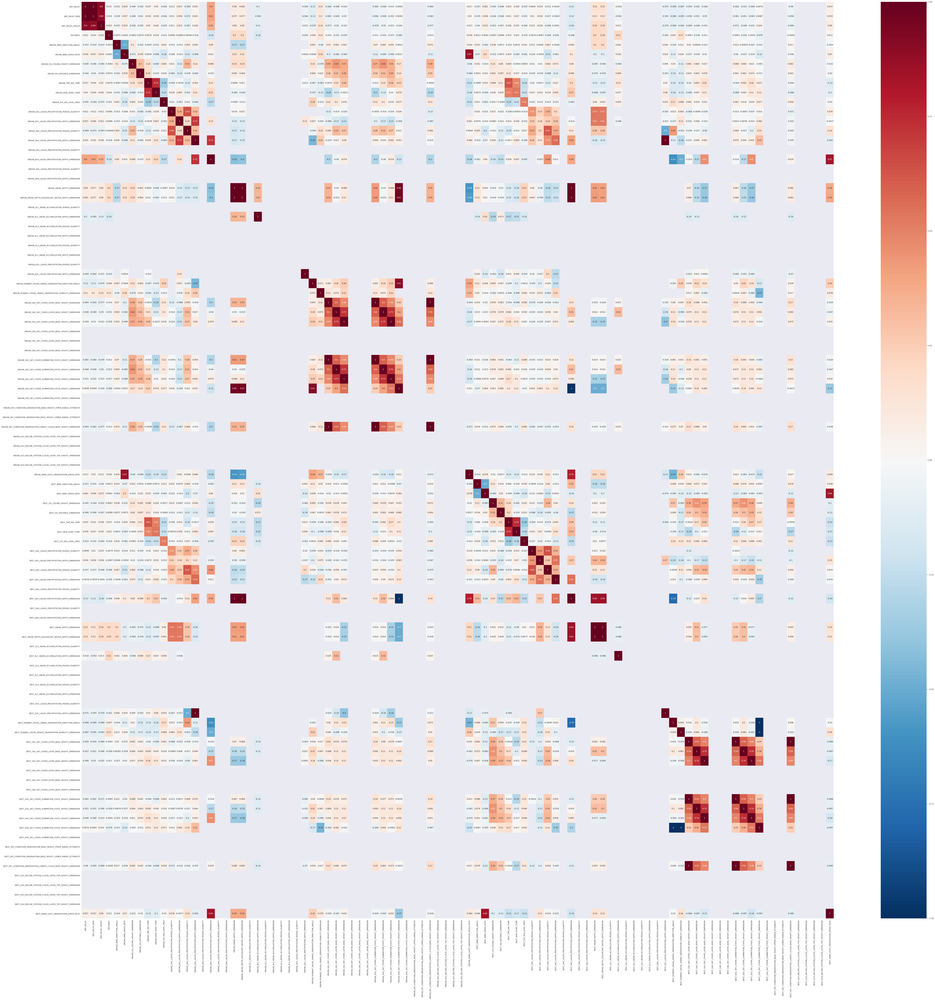

In [0]:
sns.set(rc={'figure.figsize':(100,100)})
sns.heatmap(df.corr(), cmap='RdBu_r', annot=True, center=0.0)
sns.set(rc={'figure.figsize':(10,10)})

In [0]:
train_label = df['DEP_DEL15'].astype(int)

In [0]:
train_data = df.drop(columns='DEP_DEL15')

In [0]:
 #find columns that correlate with the label
correlated_cols=[]
for col in train_data.columns:
  try:
    corr = train_label.corr(train_data[col])
    if(corr > 0.045  or corr < -0.045):
      star='(*)' # flag the highly correlated numeric variables
      correlated_cols.append(col)
    else:
       star=''
    print('The correlation of {:} with the outcome variable is {:7.6f}{:}'.format(col, corr, star))
  except:
    continue;

#sns.set(rc={'figure.figsize':(20,20)})
#sns.heatmap(df_train[correlated_cols].corr(), cmap='RdBu_r', annot=True, center=0.0)

The correlation of DEP_DELAY with the outcome variable is 0.612208(*)
The correlation of DEP_DELAY_NEW with the outcome variable is 0.593514(*)
The correlation of DEP_DELAY_GROUP with the outcome variable is 0.753592(*)
The correlation of DISTANCE with the outcome variable is 0.016044
The correlation of ORIGIN_WND_DIRECTION_ANGLE with the outcome variable is -0.024422
The correlation of ORIGIN_WND_SPEED_RATE with the outcome variable is 0.074599(*)
The correlation of ORIGIN_CIG_CEILING_HEIGHT_DIMENSION with the outcome variable is -0.041248
The correlation of ORIGIN_VIS_DISTANCE_DIMENSION with the outcome variable is -0.037835
The correlation of ORIGIN_TMP_AIR_TEMP with the outcome variable is 0.031912
The correlation of ORIGIN_DEW_POINT_TEMP with the outcome variable is 0.012918
The correlation of ORIGIN_SLP_SEA_LEVEL_PRES with the outcome variable is -0.023268
The correlation of ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is -0.009145
The correlation of ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is 0.029315
The correlation of ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is -0.077410(*)
The correlation of ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is 0.000114
The correlation of ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is 0.067610(*)
The correlation of ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_AA4_LIQUID_PRECIPITATION_CONDITION_CODE with the outcome variable is nan
The correlation of ORIGIN_AA4_LIQUID_PRECIPITATION_QUALITY_CODE with the outcome variable is nan
The correlation of ORIGIN_SNOW_DEPTH_DIMENSION with the outcome variable is -0.077342(*)
The correlation of ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION with the outcome variable is -0.077844(*)
The correlation of ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION with the outcome variable is -0.150628(*)
The correlation of ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_AL3_SNOW_ACCUMULATION_CONDITION_CODE with the outcome variable is nan
The correlation of ORIGIN_AL3_SNOW_ACCUMULATION_QUALITY_CODE with the outcome variable is nan
The correlation of ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is -0.001366
The correlation of ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE with the outcome variable is nan
The correlation of ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR with the outcome variable is nan
The correlation of ORIGIN_AT1_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE with the outcome variable is nan
The correlation of ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE with the outcome variable is nan
The correlation of ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR with the outcome variable is nan
The correlation of ORIGIN_AT2_DAILY_PRESENT_WEATHER_OBSERVATION_QUALITY_CODE with the outcome variable is nan
The correlation of ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE with the outcome variable is nan
The correlation of ORIGIN_AT3_DAILY_PRESENT_WEATHER_OBSERVATION_WEATHER_TYPE_ABBR with the outcome variable is nan
The correlati

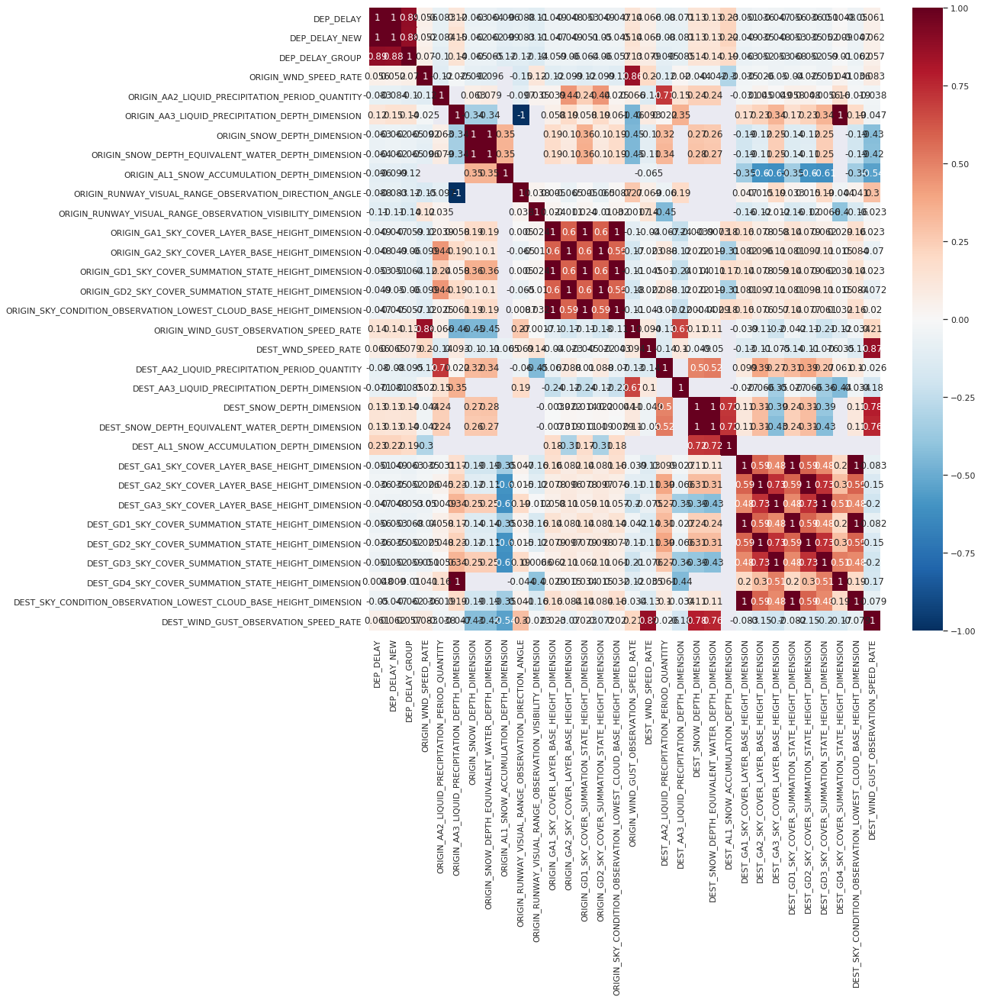

In [0]:
sns.set(rc={'figure.figsize':(15,15)})
sns.heatmap(train_data[correlated_cols].corr(), cmap='RdBu_r', annot=True, center=0.0)

Correlated columns that were removed
   
    'ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE' correlates with ORIGIN_WND_SPEED_RATE
    'DEST_WIND_GUST_OBSERVATION_SPEED_RATE' correlates with DEST_WND_SPEED_RATE
    'ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION' correlates with ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE and DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION 
    'DEST_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION' correlates with DEST_SNOW_DEPTH_DIMENSION
    'ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION' correlates with ORIGIN_SNOW_DEPTH_DIMENSION
    'ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION' and 'ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION' correlates with ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION
    'DEST_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION' correlates with DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION
    'ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION' correlates with ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION
    'DEST_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION' correlates with DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION
    'DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION' correlates with DEST_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION
    'DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION' correlates with DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION

In [0]:
cols_to_keep = ['ORIGIN_WND_SPEED_RATE', 'ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY', 'ORIGIN_SNOW_DEPTH_DIMENSION',
 'ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION', 'ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE',
 'ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION', 'ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION',
 'ORIGIN_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION',
 'DEST_WND_SPEED_RATE', 'DEST_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY', 'DEST_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION',
 'DEST_SNOW_DEPTH_DIMENSION', 'DEST_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION',
 'DEST_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION',  'DEST_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION',
 'DEST_SKY_CONDITION_OBSERVATION_LOWEST_CLOUD_BASE_HEIGHT_DIMENSION']

With the values above we have a few hand-picked selections we can use for an initial model

In [0]:
flights_sample_panda_df = spark.sql("SELECT * FROM flights_and_weather_train_ra_processed").drop('YEAR').sample(True,0.001)

In [0]:
df = flights_sample_panda_df.toPandas()

In [0]:
train_label = df['DEP_DEL15'].astype(int)
train_data = df.drop(columns='DEP_DEL15')

In [0]:
 #find columns that correlate with the label
correlated_cols=[]
for col in train_data.columns:
  try:
    corr = train_label.corr(train_data[col])
    if(corr > 0.045  or corr < -0.045):
      star='(*)' # flag the highly correlated numeric variables
      correlated_cols.append(col)
    else:
       star=''
    print('The correlation of {:} with the outcome variable is {:7.6f}{:}'.format(col, corr, star))
  except:
    continue;



The correlation of DEP_DELAY with the outcome variable is 0.639362(*)
The correlation of DEP_DELAY_NEW with the outcome variable is 0.621158(*)
The correlation of DEP_DELAY_GROUP with the outcome variable is 0.748953(*)
The correlation of DISTANCE with the outcome variable is 0.024832
The correlation of ORIGIN_WND_DIRECTION_ANGLE with the outcome variable is -0.023235
The correlation of ORIGIN_WND_SPEED_RATE with the outcome variable is 0.098939(*)
The correlation of ORIGIN_CIG_CEILING_HEIGHT_DIMENSION with the outcome variable is -0.037041
The correlation of ORIGIN_VIS_DISTANCE_DIMENSION with the outcome variable is -0.030972
The correlation of ORIGIN_TMP_AIR_TEMP with the outcome variable is 0.022321
The correlation of ORIGIN_DEW_POINT_TEMP with the outcome variable is -0.001242
The correlation of ORIGIN_SLP_SEA_LEVEL_PRES with the outcome variable is -0.030730
The correlation of ORIGIN_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is -0.005917
The correlation of ORIGIN_AA1_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is 0.024996
The correlation of ORIGIN_AA2_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is -0.010459
The correlation of ORIGIN_AA2_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is 0.012615
The correlation of ORIGIN_AA3_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is -0.006533
The correlation of ORIGIN_AA3_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is -0.003246
The correlation of ORIGIN_AA4_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AA4_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_SNOW_DEPTH_DIMENSION with the outcome variable is 0.027958
The correlation of ORIGIN_SNOW_DEPTH_EQUIVALENT_WATER_DEPTH_DIMENSION with the outcome variable is 0.027999
The correlation of ORIGIN_AL1_SNOW_ACCUMULATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AL1_SNOW_ACCUMULATION_DEPTH_DIMENSION with the outcome variable is -0.003607
The correlation of ORIGIN_AL2_SNOW_ACCUMULATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AL2_SNOW_ACCUMULATION_DEPTH_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_AL3_SNOW_ACCUMULATION_PERIOD_QUANTITY with the outcome variable is nan
The correlation of ORIGIN_AL3_SNOW_ACCUMULATION_DEPTH_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_AO1_LIQUID_PRECIPITATION_PERIOD_QUANTITY with the outcome variable is -0.025116
The correlation of ORIGIN_AO1_LIQUID_PRECIPITATION_DEPTH_DIMENSION with the outcome variable is -0.008418
The correlation of ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_DIRECTION_ANGLE with the outcome variable is 0.021635
The correlation of ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION with the outcome variable is 0.034640
The correlation of ORIGIN_GA1_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION with the outcome variable is -0.006099
The correlation of ORIGIN_GA2_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION with the outcome variable is 0.009518
The correlation of ORIGIN_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION with the outcome variable is 0.021905
The correlation of ORIGIN_GA4_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION with the outcome variable is -0.003607
The correlation of ORIGIN_GA5_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_GA6_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION with the outcome variable is nan
The correlation of ORIGIN_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION with the outcome variable is -0.010212
The correlation of ORIGIN_GD2_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION with the outcome variable is 0.009912
The correlation of ORIGIN_GD3_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION with the outcome variable is 0.025485
The correlation of ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION with the outcome variable is 0.04

In [0]:
cols_to_keep = ['ORIGIN_WND_SPEED_RATE', 'ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE', 'DEST_WND_SPEED_RATE', 'ORIGIN_WND_DIRECTION_ANGLE_3_RA', 'ORIGIN_WND_SPEED_RATE_3_RA',
 'ORIGIN_CIG_CEILING_HEIGHT_DIMENSION_3_RA', 'ORIGIN_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA', 'ORIGIN_GD4_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA',
 'ORIGIN_WIND_GUST_OBSERVATION_SPEED_RATE_3_RA', 'DEST_WND_SPEED_RATE_3_RA', 'DEST_AA1_LIQUID_PRECIPITATION_PERIOD_QUANTITY_3_RA', 'DEST_RUNWAY_VISUAL_RANGE_OBSERVATION_VISIBILITY_DIMENSION_3_RA',
 'DEST_GA3_SKY_COVER_LAYER_BASE_HEIGHT_DIMENSION_3_RA', 'DEST_GD1_SKY_COVER_SUMMATION_STATE_HEIGHT_DIMENSION_3_RA', 'DEST_WIND_GUST_OBSERVATION_SPEED_RATE_3_RA']

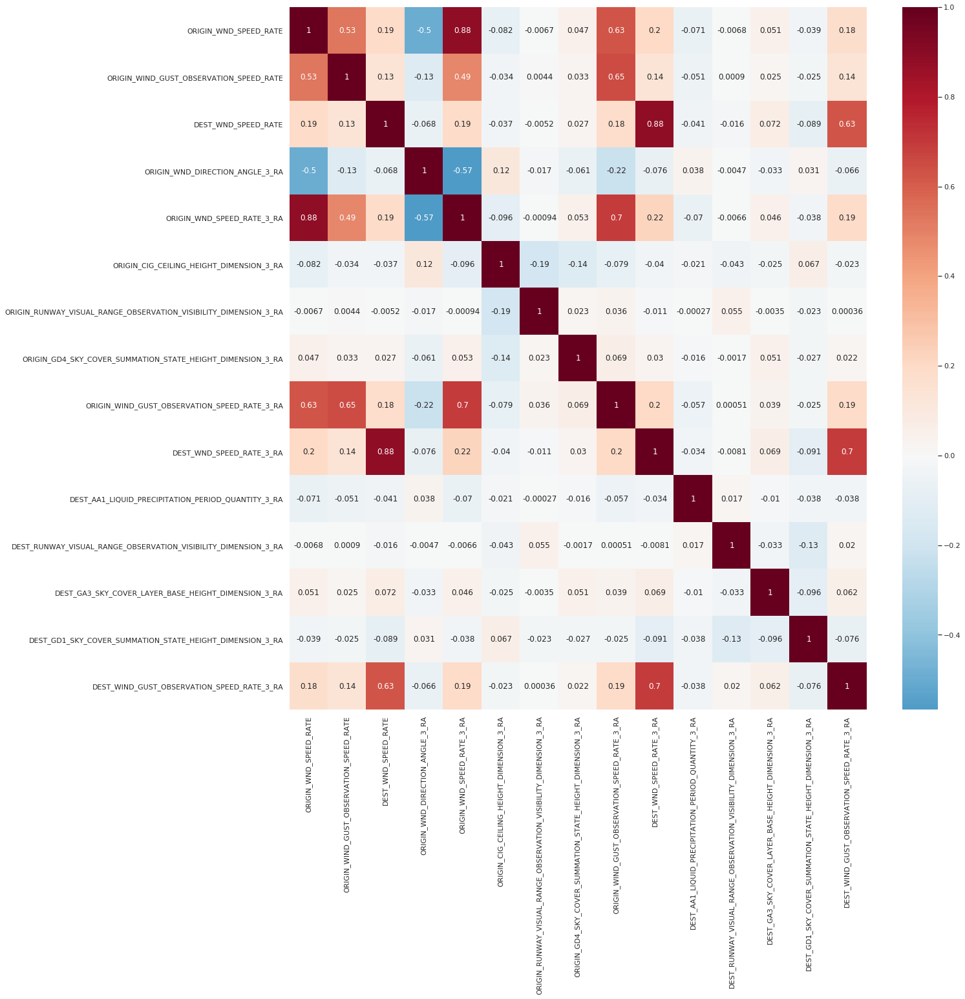

In [0]:
sns.set(rc={'figure.figsize':(20,20)})
sns.heatmap(train_data[correlated_cols].corr(), cmap='RdBu_r', annot=True, center=0.0)

# Citations

Abdulwahab. Aljubairy, A., L. Atzori, A., L. Belcastro, F., Y. Chen, J., NR. Chopde, M., D. Georgakopoulos, P., . . . W. Wu, C. (1970, January 01). A system for effectively predicting flight delays based on IoT data. Retrieved July 25, 2020, from https://link.springer.com/article/10.1007/s00607-020-00794-w  
Ye, B., Liu, B., Tian, Y., &amp; Wan, L. (2020, April 1). A Methodology for Predicting Aggregate Flight Departure ... Retrieved July 25, 2020, from https://www.mdpi.com/2071-1050/12/7/2749/pdf